## NOTEBOOK 2 - Feature engineering and Model creation :

This notebook is the second notebookof the three and builds on top of the EDA done in the first notebook.
Here we will cover the feature engineering, model creation aspect and model comparison. 

In this notebook we will also **mostly try and create functions** which will be easy to migrate when we want to use this into production. This is generally the practice that EDA can be done in a notebook fashion but the feature engineering and model creation should be done keeping deployment in mind(creating modular functions)

## Contents   :
* [Taking into account holidays](#holidays)
* [Feature set creation](#feature_c)
    * [Create zones](#zone_creation) 
    * [Create distance from hotspot features](#distance) 
    * [lag features](#lag)
    * [Aggregated metric features](#agg)
    
* [Model creation for each zone- Demand forecasting](#model)
    * [ARIMA model - univariate ](#arima)
    * [RF Regressor - all features](#RF)
    * [LSTM - all features](#LSTM)
    * [Model comparison using MSE (Mean squared error) metric](#mse)
    * [Demand visualisation each zone](#fig-demand)
    

In [1]:
import holidays
import plotly.graph_objects as go
import plotly.colors as pc
import pandas as pd
import geohash2
from sklearn.cluster import KMeans
from sklearn.metrics.pairwise import haversine_distances
import numpy as np
from pmdarima import auto_arima
from plotly.subplots import make_subplots
import plotly.graph_objects as go
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense

from statsmodels.tsa.arima.model import ARIMA
from sklearn.metrics import mean_squared_error
import matplotlib.pyplot as plt
import joblib

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

## Taking into account holidays<a class="anchor" id="holidays"></a>

In [ ]:
# holidays library has a function where we can feed in the date and get to know what holiday it is 
# it will return 'none' if there is no holiday and will return the name of the holiday if it is 
estonia_holidays = holidays.EE() 
print(estonia_holidays.get('2022-05-01')) # spring holiday
print(estonia_holidays.get('2022-02-01')) # No holiday

############### fetch the data #####################
df = pd.read_csv('robotex5.csv')
df['start_time'] = pd.to_datetime(df['start_time'])


################# check which were holidays in estonia in march of 2022 ################
# Is Weekend (1 if Saturday or Sunday, else 0)
df['is_holiday'] = df['start_time'].apply(lambda x: True if estonia_holidays.get(x) 
                                          else False)
df[(df['is_holiday'] == True)].head(2)

####### LOOKS LIKE THERE WERE NO HOLIDAYS IN MARCH 2022 SO WE DON'T NEED TO HAVE THIS FEATURE ##############

# Feature set creation<a class="anchor" id="feature_c"></a>

## Create zones<a class="anchor" id="zone_creation"></a>

In [3]:
def create_zones(df, lat_column='start_lat', lng_column='start_lng', ride_count_column='ride_value',
                 precision=5, n_clusters=5):
    """
    This function creates zones using geohashing and K-Means clustering, considering ride count.

    Parameters:
    df (pd.DataFrame): Input DataFrame
    lat_column (str): Name of the latitude column (default is 'start_lat')
    lng_column (str): Name of the longitude column (default is 'start_lng')
    ride_count_column (str): Name of the ride count or value column (default is 'ride_value')
    precision (int): Precision for geohashing (default is 5)
    n_clusters (int): Number of clusters for K-Means (default is 5)

    Returns:
    pd.DataFrame: DataFrame with new zone labels from both Geohashing and K-Means
    """
    
    # Apply Geohashing to latitude and longitude columns
    def apply_geohash(lat, lng, precision):
        return geohash2.encode(lat, lng, precision)

    df['geohash'] = df.apply(lambda row: apply_geohash(row[lat_column], row[lng_column], precision), axis=1)
    
    # Aggregate ride counts by geohash
    geohash_agg = df.groupby('geohash').agg({
        lat_column: 'mean',
        lng_column: 'mean',
        ride_count_column: 'size'  # Assuming each row represents a ride, this gives us ride count per geohash
    }).reset_index().rename(columns={ride_count_column: 'ride_count'})
    
    kmeans = KMeans(n_clusters=n_clusters)
    
    # Include ride_count in the clustering process
    kmeans_input = geohash_agg[[lat_column, lng_column, 'ride_count']]
    
    geohash_agg['zone'] = kmeans.fit_predict(kmeans_input)
    
    df = df.merge(geohash_agg[['geohash', 'zone']], on='geohash', how='left')
    
    # Create a lookup for geohash to zone
    geo_hash_to_zone = geohash_agg[['geohash', 'zone']].drop_duplicates().to_csv('geo_hash_to_zone_lookup.csv', index = False)

    return df

## Create distance from hotspot features<a class="anchor" id="distance"></a>

In [4]:
def haversine_sklearn(lat1, lon1, lat2, lon2):
    """
    Calculate the Haversine distance between two points using scikit-learn's haversine_distances function.
    The input should be in degrees, and the result is returned in kilometers.
    """
    # Convert decimal degrees to radians
    point1 = np.radians([lat1, lon1])
    point2 = np.radians([lat2, lon2])
    
    # Calculate the Haversine distance
    distance = haversine_distances([point1], [point2])
    
    # Multiply by Earth's radius to get the distance in kilometers
    return distance[0][0] * 6371  # Radius of Earth in kilometers

def create_distance_features(df, hotspots, zone_column, start_lat_column='start_lat', start_lng_column='start_lng', 
                             end_lat_column='end_lat', end_lng_column='end_lng'):
    """
    This function calculates the average distance from start and end points to important hotspots for each zone.
    
    Parameters:
    df (pd.DataFrame): Input DataFrame with ride data
    hotspots (list of lists): List of hotspots in the form [['lat1', 'lon1'], ['lat2', 'lon2'], ...]
    zone_column (str): The column representing the zone for each ride
    start_lat_column (str): Column name for the start latitude (default is 'start_lat')
    start_lng_column (str): Column name for the start longitude (default is 'start_lng')
    end_lat_column (str): Column name for the end latitude (default is 'end_lat')
    end_lng_column (str): Column name for the end longitude (default is 'end_lng')
    
    Returns:
    pd.DataFrame: DataFrame with average distance features for each zone.
    """
    
    # Calculate distances to each hotspot from both start and end points
    for i, hotspot in enumerate(hotspots):
        hotspot_lat, hotspot_lng = float(hotspot[0]), float(hotspot[1])
        
        # Calculate distance to hotspot from start points
        df[f'distance_to_hotspot_{i+1}_from_start'] = df.apply(
            lambda row: haversine_sklearn(row[start_lat_column], row[start_lng_column], hotspot_lat, hotspot_lng), axis=1
        )
        
        # Calculate distance to hotspot from end points
        df[f'distance_to_hotspot_{i+1}_from_end'] = df.apply(
            lambda row: haversine_sklearn(row[end_lat_column], row[end_lng_column], hotspot_lat, hotspot_lng), axis=1
        )

    distance_columns = [f'distance_to_hotspot_{i+1}_from_start' for i in range(len(hotspots))] + \
                       [f'distance_to_hotspot_{i+1}_from_end' for i in range(len(hotspots))]
    
    # Group by the zone and calculate the mean of distances for each zone
    zone_averages = df.groupby(zone_column)[distance_columns].mean().reset_index()

    return zone_averages

## lag features<a class="anchor" id="lag"></a>

In [5]:

def generate_temporal_and_lag_features(df, time_column='start_time', zone_column='zone', ride_value_column='ride_value'):
    """
    This function generates temporal features (hour of day, day of week, is_weekend)
    and lag features (last 30 min, last 1 hr, last 1 day) for total ride value and ride counts per zone.

    Parameters:
    df (pd.DataFrame): Input DataFrame with ride data
    time_column (str): Name of the datetime column (default is 'start_time')
    zone_column (str): Name of the column representing zones (default is 'zone')
    ride_value_column (str): Name of the ride value column to aggregate (default is 'ride_value')

    Returns:
    pd.DataFrame: DataFrame with the new temporal and lag features added.
    """
    
    df[time_column] = pd.to_datetime(df[time_column])
    df['hour_of_day'] = df[time_column].dt.hour
    df['day_of_week'] = df[time_column].dt.dayofweek
    df['is_weekend'] = df['day_of_week'].apply(lambda x: 1 if x >= 5 else 0)

    # Aggregate total ride_value and total ride count per zone and time interval we are using 30 minutes
    df_aggregated = df.groupby([zone_column, pd.Grouper(key=time_column, freq='30T')]).agg(
        total_ride_value=(ride_value_column, 'sum'),
        ride_count=(ride_value_column, 'size')  # size gives the number of rides
    ).reset_index()

    df_aggregated = df_aggregated.sort_values(by=[zone_column, time_column])
    df_aggregated['lag_total_value_last_30_min'] = df_aggregated.groupby(zone_column)['total_ride_value'].shift(1)
    df_aggregated['lag_total_value_last_1_hr'] = df_aggregated.groupby(zone_column)['total_ride_value'].shift(2)
    df_aggregated['lag_total_value_last_1_day'] = df_aggregated.groupby(zone_column)['total_ride_value'].shift(48)
    
    df_aggregated['lag_ride_count_last_30_min'] = df_aggregated.groupby(zone_column)['ride_count'].shift(1)
    df_aggregated['lag_ride_count_last_1_hr'] = df_aggregated.groupby(zone_column)['ride_count'].shift(2)
    df_aggregated['lag_ride_count_last_1_day'] = df_aggregated.groupby(zone_column)['ride_count'].shift(48)
    
    return df_aggregated

## Aggregated metric features<a class="anchor" id="agg"></a>

In [6]:

def calculate_aggregated_metrics(df, zone_column, time_column='start_time', ride_value_column='ride_value', time_freq='30T'):
    """
    This function calculates aggregated ride value metrics (average ride value, total rides, total ride value)
    per zone and time interval.

    Parameters:
    df (pd.DataFrame): Input DataFrame with ride data.
    zone_column (str): Name of the column representing zones.
    time_column (str): Name of the datetime column (default is 'start_time').
    ride_value_column (str): Name of the ride value column (default is 'ride_value').
    time_freq (str): Frequency for time grouping (default is 'H' for hourly).
                     Options: 'H' (hourly), 'D' (daily), 'W' (weekly), etc.

    Returns:
    pd.DataFrame: DataFrame with aggregated metrics (average ride value, total rides, total ride value).
    """
    
    df[time_column] = pd.to_datetime(df[time_column])
    
    aggregated_df = df.set_index(time_column).groupby([zone_column, pd.Grouper(freq=time_freq)]).agg(
        average_ride_value=(ride_value_column, 'mean'),
        total_rides=(ride_value_column, 'size'),
        total_ride_value=(ride_value_column, 'sum')
    ).reset_index()

    return aggregated_df

## Create zones & bucket each transaction into one zone

In [7]:
# Create zones using geohashing and K-Means clustering
df = create_zones(df, lat_column='start_lat', lng_column='start_lng', 
                  ride_count_column='ride_value', precision=5, n_clusters=40)
print('zones features created')
print(len(df))
df.head(2)

/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


zones features created
627210


,start_time,start_lat,start_lng,end_lat,end_lng,ride_value,is_holiday,geohash,zone
0,2022-03-06 15:02:39.329452,59.40791,24.689836,59.513027,24.831630,3.51825,False,ud99c,8
1,2022-03-10 11:15:55.177526,59.44165,24.762712,59.426450,24.783076,0.50750,False,ud9d5,0


## For each zone calculate the average distance to the hotspots

In [8]:
# 1. Tallinn bus station - 59.4274, 24.7740
# 2. Old City Harbor (Port of Tallinn) - 59.4475, 24.7664
# 3. Airport - 59.4146, 24.8335
# 4. city center tallinn estonia - 59.4370, 24.7536
# 5. Tammsaare Business Centre - 59.4017, 24.7160
# 6. Foorum Shopping Centre - 59.4375° , 24.7583°

HOT_SPOTS_LIST = [[59.4274, 24.7740], [59.4475, 24.7664], [59.4146, 24.8335],
                  [59.4370, 24.7536], [59.4017, 24.7160], [59.4375 , 24.7583]]

In [9]:
# Apply the function to create the average distance features per zone
zone_averages_df = create_distance_features(df, HOT_SPOTS_LIST, zone_column='zone')
print(len(zone_averages_df))
zone_averages_df.head(2)

40


,zone,distance_to_hotspot_1_from_start,distance_to_hotspot_2_from_start,distance_to_hotspot_3_from_start,distance_to_hotspot_4_from_start,distance_to_hotspot_5_from_start,distance_to_hotspot_6_from_start,distance_to_hotspot_1_from_end,distance_to_hotspot_2_from_end,distance_to_hotspot_3_from_end,distance_to_hotspot_4_from_end,distance_to_hotspot_5_from_end,distance_to_hotspot_6_from_end
0,0,1.401574,1.698193,4.873968,0.823368,4.355411,0.845897,8.521654,8.942953,10.938132,8.239285,9.454222,8.301035
1,1,11.322965,12.690159,13.223098,11.326928,6.988291,11.537252,8.466990,8.931940,10.858546,8.211900,9.415213,8.269277


## Calculate the temporal and lag features per zone 

In [10]:
df_with_features = generate_temporal_and_lag_features(df, time_column='start_time',
                                                      zone_column='zone', ride_value_column='ride_value')

print(len(df_with_features))
df_with_features.head(2)

29995


,zone,start_time,total_ride_value,ride_count,lag_total_value_last_30_min,lag_total_value_last_1_hr,lag_total_value_last_1_day,lag_ride_count_last_30_min,lag_ride_count_last_1_hr,lag_ride_count_last_1_day
0,0,2022-03-01 00:00:00,152.27825,178,NaN,NaN,NaN,NaN,NaN,NaN
1,0,2022-03-01 00:30:00,1835.24400,160,152.27825,NaN,NaN,178.0,NaN,NaN


## Aggregated avg value per zone

In [11]:
aggregated_df = calculate_aggregated_metrics(df, zone_column='zone', time_column='start_time',
                                             ride_value_column='ride_value', time_freq='30T')
print(len(aggregated_df))
aggregated_df.head(2)

29995


,zone,start_time,average_ride_value,total_rides,total_ride_value
0,0,2022-03-01 00:00:00,0.855496,178,152.27825
1,0,2022-03-01 00:30:00,11.470275,160,1835.24400


## Combine the dataframes

In [12]:
features_df = pd.merge(df_with_features.drop(['total_ride_value', 'ride_count'], axis = 1), aggregated_df, on = ('zone','start_time'))
print(len(features_df))
features_df[(features_df['zone'] == 2)].head(2)


29995


,zone,start_time,lag_total_value_last_30_min,lag_total_value_last_1_hr,lag_total_value_last_1_day,lag_ride_count_last_30_min,lag_ride_count_last_1_hr,lag_ride_count_last_1_day,average_ride_value,total_rides,total_ride_value
2599,2,2022-03-01 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,1.024913,60,61.49475
2600,2,2022-03-01 00:30:00,61.49475,NaN,NaN,60.0,NaN,NaN,1.031774,31,31.98500


In [13]:
features_df = pd.merge(features_df, zone_averages_df, on = 'zone')
features_df[(features_df['zone'] == 2)].head(2)

,zone,start_time,lag_total_value_last_30_min,lag_total_value_last_1_hr,lag_total_value_last_1_day,lag_ride_count_last_30_min,lag_ride_count_last_1_hr,lag_ride_count_last_1_day,average_ride_value,total_rides,total_ride_value,distance_to_hotspot_1_from_start,distance_to_hotspot_2_from_start,distance_to_hotspot_3_from_start,distance_to_hotspot_4_from_start,distance_to_hotspot_5_from_start,distance_to_hotspot_6_from_start,distance_to_hotspot_1_from_end,distance_to_hotspot_2_from_end,distance_to_hotspot_3_from_end,distance_to_hotspot_4_from_end,distance_to_hotspot_5_from_end,distance_to_hotspot_6_from_end
2599,2,2022-03-01 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,1.024913,60,61.49475,3.107025,3.021395,6.622769,2.036847,3.63302,2.268535,7.839681,8.259186,10.254151,7.560001,8.792437,7.620336
2600,2,2022-03-01 00:30:00,61.49475,NaN,NaN,60.0,NaN,NaN,1.031774,31,31.98500,3.107025,3.021395,6.622769,2.036847,3.63302,2.268535,7.839681,8.259186,10.254151,7.560001,8.792437,7.620336


In [14]:
features_df.dtypes

zone                                         int32
start_time                          datetime64[ns]
lag_total_value_last_30_min                float64
lag_total_value_last_1_hr                  float64
lag_total_value_last_1_day                 float64
lag_ride_count_last_30_min                 float64
lag_ride_count_last_1_hr                   float64
lag_ride_count_last_1_day                  float64
average_ride_value                         float64
total_rides                                  int64
total_ride_value                           float64
distance_to_hotspot_1_from_start           float64
distance_to_hotspot_2_from_start           float64
distance_to_hotspot_3_from_start           float64
distance_to_hotspot_4_from_start           float64
distance_to_hotspot_5_from_start           float64
distance_to_hotspot_6_from_start           float64
distance_to_hotspot_1_from_end             float64
distance_to_hotspot_2_from_end             float64
distance_to_hotspot_3_from_end 

## Model creation for each zone- Demand forecasting<a class="anchor" id="model"></a>

The goal is to predict **future ride demand** for each region at a specific time. This can guide drivers to the areas where demand is expected to be high.


## ARIMA model - univariate<a class="anchor" id="model"></a>

In [15]:
def apply_auto_arima_forecast_with_subplots(df, zone_column, target_column, time_column='start_time', forecast_steps=10):
    """
    This function applies an Auto-ARIMA model to forecast a time series column (total rides or total ride value)
    for each zone, sorts zones by the total of the target column in descending order, and plots the results in a grid with subplots (3 columns per row).

    Parameters:
    df (pd.DataFrame): Input DataFrame with zone-wise data.
    zone_column (str): The column representing zones.
    target_column (str): The column to forecast (e.g., total_rides or total_ride_value).
    time_column (str): The time column representing the time index (default is 'start_time').
    forecast_steps (int): Number of steps ahead to forecast.

    Returns:
    dict: A dictionary containing forecasts for each zone.
    """
    
    df[time_column] = pd.to_datetime(df[time_column])
    zone_sums = df.groupby(zone_column)[target_column].sum().sort_values(ascending=False)
    sorted_zones = zone_sums.index

    zone_forecasts = {}
    mse_list = []

    ncols = 3
    nrows = (len(sorted_zones) + ncols - 1) // ncols  # Calculate number of rows based on number of zones
    fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(20, 5 * nrows))
    axes = axes.flatten()
    
    # model is created per zone 
    for i, zone in enumerate(sorted_zones):
        zone_df = df[df[zone_column] == zone].set_index(time_column)
        
        target_series = zone_df[target_column]
        
        train_size = int(len(target_series) * 0.8)
        train, test = target_series[:train_size], target_series[train_size:]

        model = auto_arima(train, seasonal=False, stepwise=True, trace=False)
        
        forecast = model.predict(n_periods=forecast_steps)
        
        zone_forecasts[zone] = forecast
        
        # Evaluate performance on the test set using Mean Squared Error (MSE)
        predictions = model.predict(n_periods=len(test))
        mse = mean_squared_error(test, predictions)
        mse_list.append({'zone': zone, 'mse': mse})
        
        axes[i].plot(train.index, train, label='Train', color='blue')
        axes[i].plot(test.index, test, label='Test', color='orange')
        axes[i].plot(test.index, predictions, label='Predicted', color='green')
        axes[i].set_title(f"Zone {zone} - {target_column} Forecast\nMSE: {mse:.2f}")
        axes[i].set_xlabel("Time")
        axes[i].set_ylabel(target_column)
        axes[i].legend()

    # Hide any unused subplots
    for j in range(i + 1, len(axes)):
        fig.delaxes(axes[j])

    plt.tight_layout()
    plt.show()
    
    mse_df = pd.DataFrame(mse_list)

    return zone_forecasts, mse_df

/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without 

/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without 

/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without 

/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without 

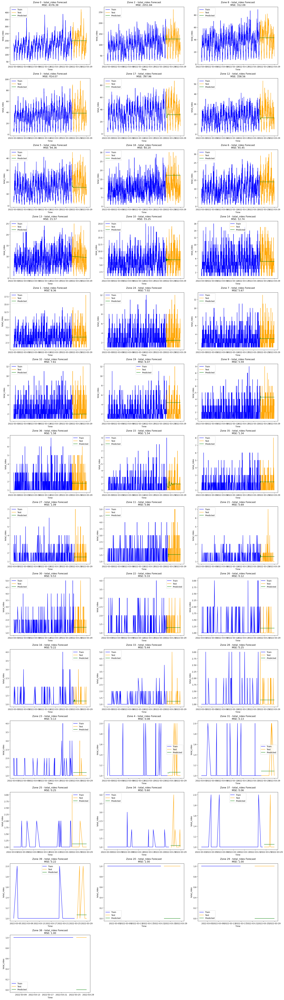

In [16]:
# Forecast total rides per zone
forecast_total_rides, arima_total_rides_df = apply_auto_arima_forecast_with_subplots(features_df, zone_column='zone',
                                                                      target_column='total_rides',
                                                                      time_column='start_time')


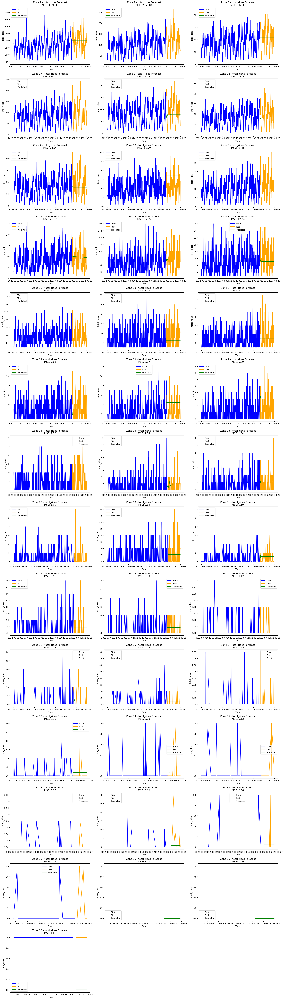

In [ ]:
# Forecast total ride value per zone
forecast_total_ride_value, arima_ride_value_df = apply_auto_arima_forecast_with_subplots(features_df, zone_column='zone',
                                                                    target_column='total_ride_value',
                                                                    time_column='start_time')



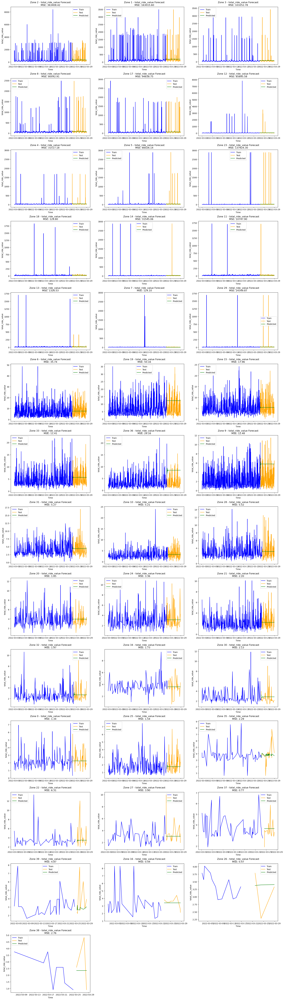

Looking at the fingues it looks ok but the MSE is very large where the volume is high - that is the first few zones where the volume is large. 

We should now try multivariate time series and regressors like tree based regression

## RF Regressor - all features<a class="anchor" id="RF"></a>

In [18]:
def multivariate_time_series_forecast_with_sorted_subplots(df, zone_column, target_column,
                                                           time_column='start_time', forecast_steps=10,
                                                          fig_required = True):
    """
    This function performs multivariate time series forecasting for each zone using the given features,
    removes any rows with NaN values, sorts zones by the total of the target column in descending order,
    and plots the results in a grid with 3 columns per row.

    Parameters:
    df (pd.DataFrame): Input DataFrame with features and target columns.
    zone_column (str): The column representing zones.
    target_column (str): The target column to forecast (e.g., total_rides or total_ride_value).
    time_column (str): The time column representing the time index (default is 'start_time').
    forecast_steps (int): Number of steps ahead to forecast.

    Returns:
    dict: A dictionary containing forecasts for the target column for each zone.
    """
    
    df[time_column] = pd.to_datetime(df[time_column])
    df = df.dropna()

    feature_columns = [
        'lag_total_value_last_30_min', 'lag_total_value_last_1_hr', 'lag_total_value_last_1_day',
        'lag_ride_count_last_30_min', 'lag_ride_count_last_1_hr', 'lag_ride_count_last_1_day',
        'average_ride_value',
        'distance_to_hotspot_1_from_start', 'distance_to_hotspot_2_from_start',
        'distance_to_hotspot_3_from_start', 'distance_to_hotspot_4_from_start',
        'distance_to_hotspot_5_from_start', 'distance_to_hotspot_6_from_start',
        'distance_to_hotspot_1_from_end', 'distance_to_hotspot_2_from_end',
        'distance_to_hotspot_3_from_end', 'distance_to_hotspot_4_from_end',
        'distance_to_hotspot_5_from_end', 'distance_to_hotspot_6_from_end'
    ]
    
    zone_forecasts = {}
    mse_list = []

    zone_sums = df.groupby(zone_column)[target_column].sum().sort_values(ascending=False)
    sorted_zones = zone_sums.index

    if fig_required:
        ncols = 3
        nrows = (len(sorted_zones) + ncols - 1) // ncols  # Calculate the number of rows based on the number of zones
        fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(20, 5 * nrows))
    
        axes = axes.flatten()

    for i, zone in enumerate(sorted_zones):
        print(f"Processing zone {zone}...")

        zone_df = df[df[zone_column] == zone].set_index(time_column)
        
        X = zone_df[feature_columns]
        y = zone_df[target_column]
        
        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, shuffle=False)

        rf = RandomForestRegressor(n_estimators=100)
        rf.fit(X_train, y_train)
        predictions = rf.predict(X_test)

        zone_forecasts[zone] = predictions
        
        mse = mean_squared_error(y_test, predictions)
        mse_list.append({'zone': zone, 'mse': mse})
        print(f"Zone {zone} - {target_column} MSE: {mse:.2f}")
        
        if fig_required:
            # Plot the forecast in the grid
            axes[i].plot(y_train.index, y_train, label=f'Train {target_column}')
            axes[i].plot(y_test.index, y_test, label=f'Test {target_column}', color='orange')
            axes[i].plot(y_test.index, predictions, label=f'Predicted {target_column}', color='green')
            axes[i].set_title(f"Zone {zone} - {target_column}\nMSE: {mse:.2f}")
            axes[i].set_xlabel("Time")
            axes[i].set_ylabel(target_column)
            axes[i].legend()

    if fig_required:
        for j in range(i + 1, len(axes)):
            fig.delaxes(axes[j])

        plt.tight_layout()
        fig.tight_layout()

        plt.show()
    
    mse_df = pd.DataFrame(mse_list)

    return zone_forecasts, mse_df


## LSTM - all features<a class="anchor" id="LSTM"></a> 

In [19]:
def apply_lstm_forecasting(df, zone_column, target_column, time_column='start_time', epochs=20, batch_size=64):
    """
    This function applies LSTM to forecast the target variable (total_rides or total_ride_value) for each zone.
    It trains an LSTM model for each zone and evaluates the results. Returns a dictionary of models and MSEs,
    and a DataFrame with the MSE for each zone.

    Parameters:
    df (pd.DataFrame): Input DataFrame with features and target columns.
    zone_column (str): The column representing zones.
    target_column (str): The target column to forecast (e.g., total_rides or total_ride_value).
    time_column (str): The time column representing the time index (default is 'start_time').
    epochs (int): Number of training epochs for LSTM.
    batch_size (int): Batch size for training LSTM.

    Returns:
    tuple: (results, mse_df), where:
        - results is a dictionary containing the LSTM models and the MSE results for each zone.
        - mse_df is a pandas DataFrame with two columns: 'zone' and 'mse'.
    """
    
    df[time_column] = pd.to_datetime(df[time_column])
    df = df.dropna()
    
    feature_columns = [
        'lag_total_value_last_30_min', 'lag_total_value_last_1_hr', 'lag_total_value_last_1_day',
        'lag_ride_count_last_30_min', 'lag_ride_count_last_1_hr', 'lag_ride_count_last_1_day',
        'average_ride_value',
        'distance_to_hotspot_1_from_start', 'distance_to_hotspot_2_from_start',
        'distance_to_hotspot_3_from_start', 'distance_to_hotspot_4_from_start',
        'distance_to_hotspot_5_from_start', 'distance_to_hotspot_6_from_start',
        'distance_to_hotspot_1_from_end', 'distance_to_hotspot_2_from_end',
        'distance_to_hotspot_3_from_end', 'distance_to_hotspot_4_from_end',
        'distance_to_hotspot_5_from_end', 'distance_to_hotspot_6_from_end'
    ]
    
    results = {}

    mse_list = []

    scaler = MinMaxScaler(feature_range=(0, 1))

    for zone in df[zone_column].unique():
        print(f"Processing zone {zone}...")

        zone_df = df[df[zone_column] == zone].set_index(time_column)
        
        X = zone_df[feature_columns].values
        y = zone_df[target_column].values.reshape(-1, 1)
        
        X_scaled = scaler.fit_transform(X)
        y_scaled = scaler.fit_transform(y)
        
        X_scaled = X_scaled.reshape(X_scaled.shape[0], 1, X_scaled.shape[1])

        train_size = int(len(X_scaled) * 0.8)
        X_train, X_test = X_scaled[:train_size], X_scaled[train_size:]
        y_train, y_test = y_scaled[:train_size], y_scaled[train_size:]

        model = Sequential()
        model.add(LSTM(64, input_shape=(X_train.shape[1], X_train.shape[2]), return_sequences=False))
        model.add(Dense(1))  # Output layer to predict the target
        model.compile(optimizer='adam', loss='mse')

        model.fit(X_train, y_train, epochs=epochs, batch_size=batch_size, verbose=1)

        y_pred_scaled = model.predict(X_test)
        
        y_pred = scaler.inverse_transform(y_pred_scaled)
        y_test_inv = scaler.inverse_transform(y_test)

        mse = mean_squared_error(y_test_inv, y_pred)
        print(f"Zone {zone} - {target_column} MSE: {mse:.4f}")

        results[zone] = {'model': model, 'mse': mse}

        mse_list.append({'zone': zone, 'mse': mse})

        plt.figure(figsize=(10, 6))
        plt.plot(y_test_inv, label='True')
        plt.plot(y_pred, label='Predicted')
        plt.title(f"Zone {zone} - {target_column} Forecasting with LSTM")
        plt.xlabel('Time Steps')
        plt.ylabel(target_column)
        plt.legend()
        plt.show()

    mse_df = pd.DataFrame(mse_list)

    return results, mse_df



Processing zone 0...
Zone 0 - total_rides MSE: 953.94
Processing zone 2...
Zone 2 - total_rides MSE: 411.63
Processing zone 8...
Zone 8 - total_rides MSE: 86.99
Processing zone 3...
Zone 3 - total_rides MSE: 78.24
Processing zone 17...
Zone 17 - total_rides MSE: 87.47
Processing zone 12...
Zone 12 - total_rides MSE: 40.07
Processing zone 5...
Zone 5 - total_rides MSE: 36.12
Processing zone 18...
Zone 18 - total_rides MSE: 20.70
Processing zone 6...
Zone 6 - total_rides MSE: 23.14
Processing zone 13...
Zone 13 - total_rides MSE: 15.42
Processing zone 10...
Zone 10 - total_rides MSE: 10.65
Processing zone 14...
Zone 14 - total_rides MSE: 8.12
Processing zone 1...
Zone 1 - total_rides MSE: 7.77
Processing zone 24...
Zone 24 - total_rides MSE: 4.64
Processing zone 7...
Zone 7 - total_rides MSE: 5.13
Processing zone 32...
Zone 32 - total_rides MSE: 4.41
Processing zone 19...
Zone 19 - total_rides MSE: 4.24
Processing zone 9...
Zone 9 - total_rides MSE: 2.26
Processing zone 36...
Zone 36 - t

/var/folders/wt/schcg0b52m39lz6_830hykv00000gq/T/ipykernel_44411/1782042285.py:100: UserWarning: The figure layout has changed to tight
  fig.tight_layout()


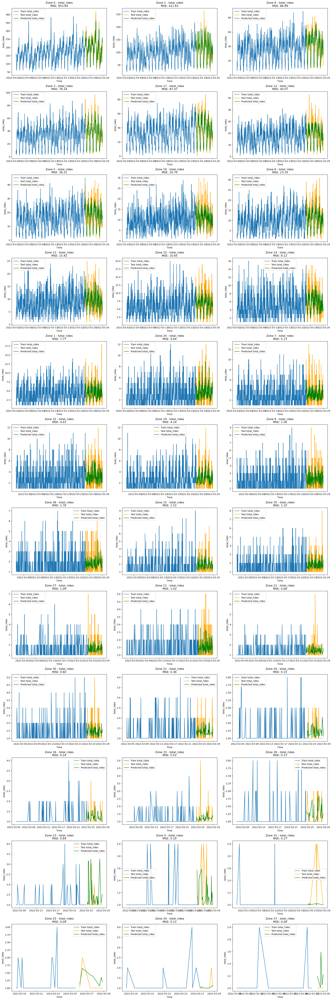

In [20]:
forecast_total_rides, regressor_with_features_total_rides_df = multivariate_time_series_forecast_with_sorted_subplots(features_df,
                                                                              zone_column='zone',
                                                                              target_column='total_rides',
                                                                              time_column='start_time')


In [21]:
### EXTRACT THE FORECAST WE WILL USE IN THE PROD ENVIOURNMENT SIMULATION NOTEBOOK
# Filter out zones with fewer than 10 values
filtered_data = {zone: values[-10:] for zone, values in forecast_total_rides.items() if len(values) >= 10}

forecast_total_rides_df = pd.DataFrame({zone: values for zone, values in filtered_data.items()}).T

forecast_total_rides_df.columns = [f'time_step_{i+1}' for i in range(10)]

forecast_total_rides_df['zone'] = forecast_total_rides_df.index

forecast_total_rides_df = forecast_total_rides_df[['zone'] + [f'time_step_{i+1}' for i in range(10)]]
forecast_total_rides_df.to_csv('RF_regressor_forecast_total_rides.csv', index = False)

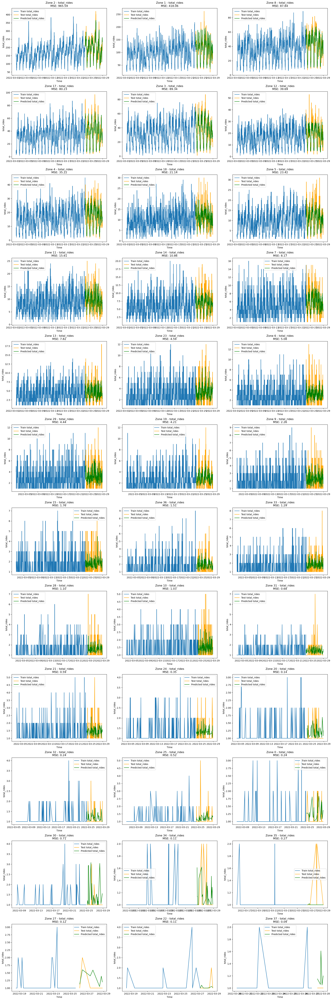

Processing zone 0...
Zone 0 - total_ride_value MSE: 5989.02
Processing zone 2...
Zone 2 - total_ride_value MSE: 15595.60
Processing zone 17...
Zone 17 - total_ride_value MSE: 7604.23
Processing zone 8...
Zone 8 - total_ride_value MSE: 6008.87
Processing zone 3...
Zone 3 - total_ride_value MSE: 463.36
Processing zone 12...
Zone 12 - total_ride_value MSE: 7115.89
Processing zone 5...
Zone 5 - total_ride_value MSE: 741.90
Processing zone 6...
Zone 6 - total_ride_value MSE: 6175.88
Processing zone 24...
Zone 24 - total_ride_value MSE: 48.28
Processing zone 18...
Zone 18 - total_ride_value MSE: 225.89
Processing zone 10...
Zone 10 - total_ride_value MSE: 177.83
Processing zone 13...
Zone 13 - total_ride_value MSE: 287.22
Processing zone 1...
Zone 1 - total_ride_value MSE: 8128.55
Processing zone 14...
Zone 14 - total_ride_value MSE: 19.98
Processing zone 32...
Zone 32 - total_ride_value MSE: 2633.63
Processing zone 7...
Zone 7 - total_ride_value MSE: 32.66
Processing zone 19...
Zone 19 - to

/var/folders/wt/schcg0b52m39lz6_830hykv00000gq/T/ipykernel_44411/1782042285.py:100: UserWarning: The figure layout has changed to tight
  fig.tight_layout()


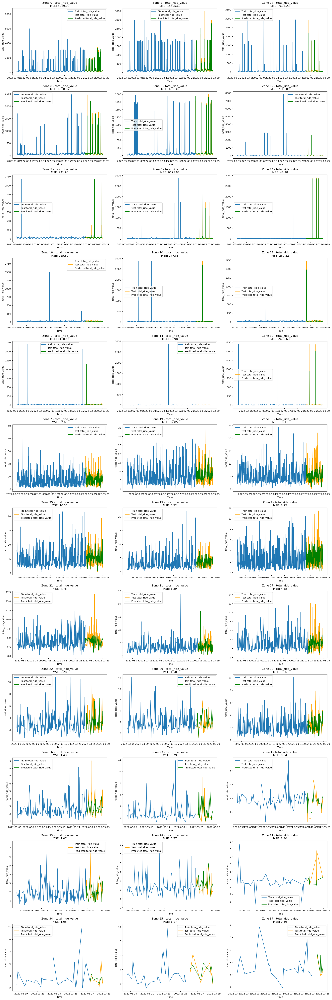

In [22]:
forecast_total_ride_value, regressor_with_features_total_ride_value_df = multivariate_time_series_forecast_with_sorted_subplots(features_df,
                                                                                   zone_column='zone',
                                                                                   target_column='total_ride_value',
                                                                                   time_column='start_time')




In [23]:
### EXTRACT THE FORECAST WE WILL USE IT IN THE PRODUCTION ENVIOURNMENT SIMULATION NOTEBOOK 
# Filter out zones with fewer than 10 values
filtered_data = {zone: values[-10:] for zone, values in forecast_total_ride_value.items() if len(values) >= 10}

forecast_total_ride_value_df = pd.DataFrame({zone: values for zone, values in filtered_data.items()}).T

forecast_total_ride_value_df.columns = [f'time_step_{i+1}' for i in range(10)]

forecast_total_ride_value_df['zone'] = forecast_total_ride_value_df.index

forecast_total_ride_value_df = forecast_total_ride_value_df[['zone'] + [f'time_step_{i+1}' for i in range(10)]]
forecast_total_ride_value_df.to_csv('RF_regressor_forecast_total_ride_value.csv', index = False)

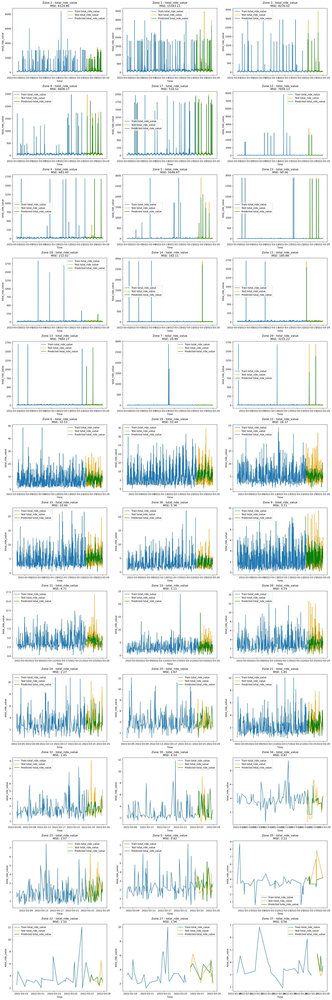

Processing zone 0...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 643us/step - loss: 0.1029
Epoch 2/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 452us/step - loss: 0.0439
Epoch 3/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 559us/step - loss: 0.0156
Epoch 4/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 514us/step - loss: 0.0096
Epoch 5/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 494us/step - loss: 0.0093
Epoch 6/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 540us/step - loss: 0.0087
Epoch 7/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 514us/step - loss: 0.0079
Epoch 8/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 518us/step - loss: 0.0075
Epoch 9/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 501us/step - loss: 0.0071
Epoch 10/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 537us/step - loss: 0.0064
Epoch 11/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 512us/step - loss: 0.0063
Epoch 12/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 519us/step - loss: 0.0059
Epoch 13/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 512us/step - loss: 0.0063
Epoch 14/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 521us/step - loss: 0.0054
Epoch 15/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 492us/step - loss: 0.0056


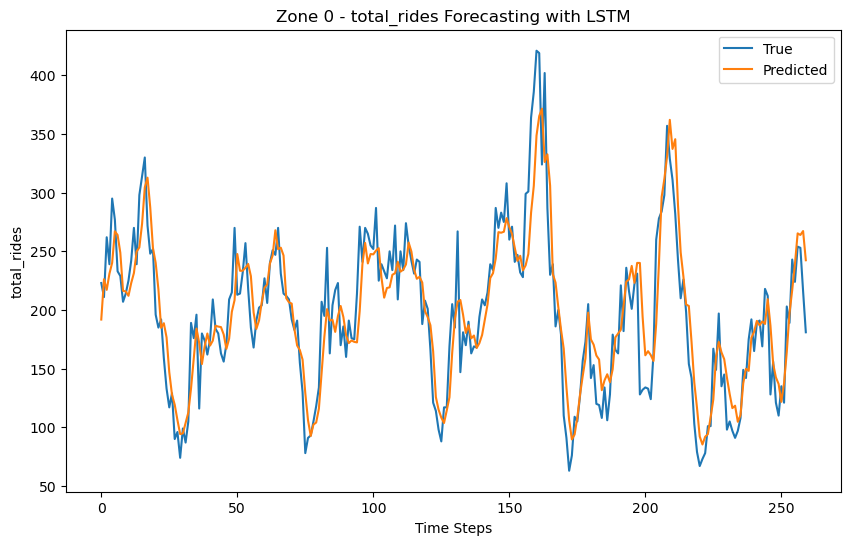

Processing zone 1...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 566us/step - loss: 0.0559
Epoch 2/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 547us/step - loss: 0.0283
Epoch 3/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 567us/step - loss: 0.0199
Epoch 4/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 647us/step - loss: 0.0210
Epoch 5/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 659us/step - loss: 0.0195
Epoch 6/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 556us/step - loss: 0.0188
Epoch 7/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 550us/step - loss: 0.0185
Epoch 8/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 542us/step - loss: 0.0196
Epoch 9/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 550us/step - loss: 0.0191
Epoch 10/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 559us/step - loss: 0.0184
Epoch 11/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 589us/step - loss: 0.0193
Epoch 12/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 516us/step - loss: 0.0190
Epoch 13/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 552us/step - loss: 0.0182
Epoch 14/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 500us/step - loss: 0.0201
Epoch 15/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 518us/step - loss: 0.0183


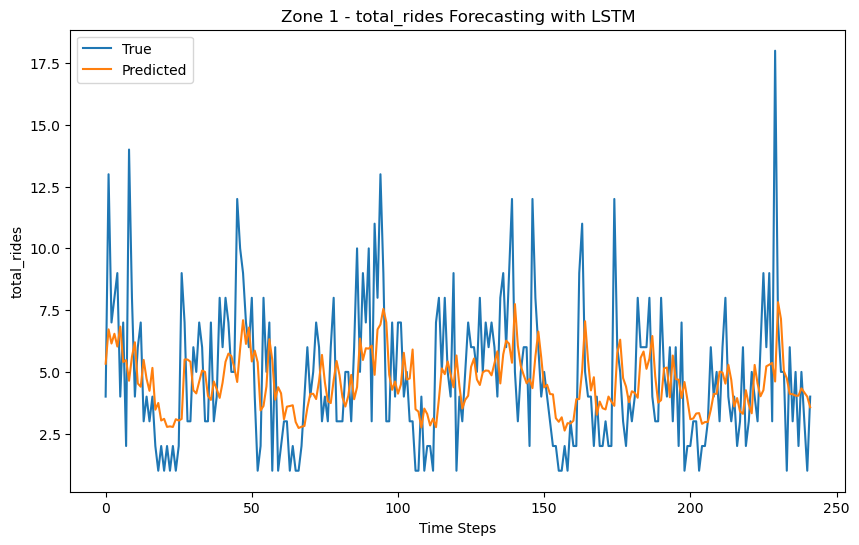

Processing zone 2...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 562us/step - loss: 0.1140
Epoch 2/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 564us/step - loss: 0.0524
Epoch 3/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 548us/step - loss: 0.0183
Epoch 4/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 529us/step - loss: 0.0107
Epoch 5/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 498us/step - loss: 0.0110
Epoch 6/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 526us/step - loss: 0.0106
Epoch 7/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 522us/step - loss: 0.0097
Epoch 8/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 534us/step - loss: 0.0095
Epoch 9/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 526us/step - loss: 0.0080
Epoch 10/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 516us/step - loss: 0.0083
Epoch 11/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 531us/step - loss: 0.0080
Epoch 12/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 522us/step - loss: 0.0078
Epoch 13/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 553us/step - loss: 0.0068
Epoch 14/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 504us/step - loss: 0.0063
Epoch 15/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 552us/step - loss: 0.0064


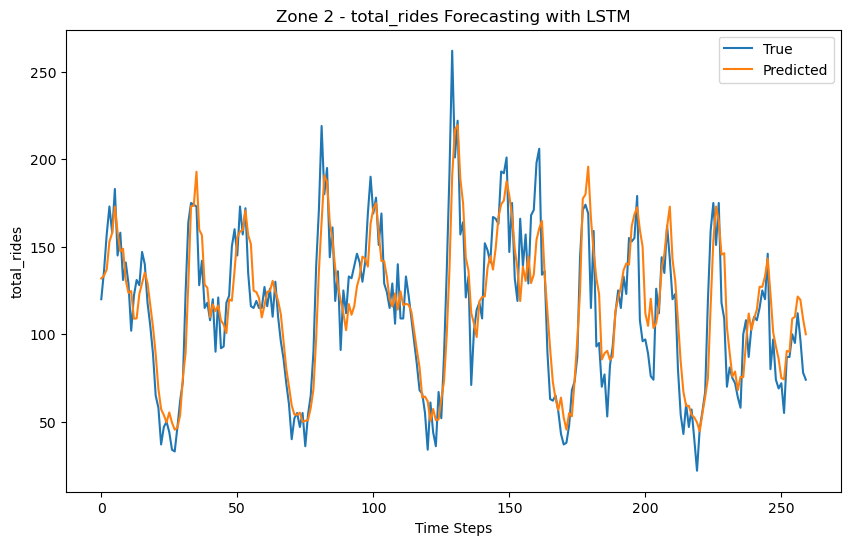

Processing zone 3...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 582us/step - loss: 0.1228
Epoch 2/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 557us/step - loss: 0.0591
Epoch 3/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 530us/step - loss: 0.0251
Epoch 4/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 549us/step - loss: 0.0134
Epoch 5/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 524us/step - loss: 0.0120
Epoch 6/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 536us/step - loss: 0.0128
Epoch 7/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 559us/step - loss: 0.0120
Epoch 8/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 534us/step - loss: 0.0109
Epoch 9/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 531us/step - loss: 0.0094
Epoch 10/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 572us/step - loss: 0.0093
Epoch 11/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 556us/step - loss: 0.0094
Epoch 12/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 549us/step - loss: 0.0090
Epoch 13/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 574us/step - loss: 0.0084
Epoch 14/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 547us/step - loss: 0.0080
Epoch 15/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 552us/step - loss: 0.0081


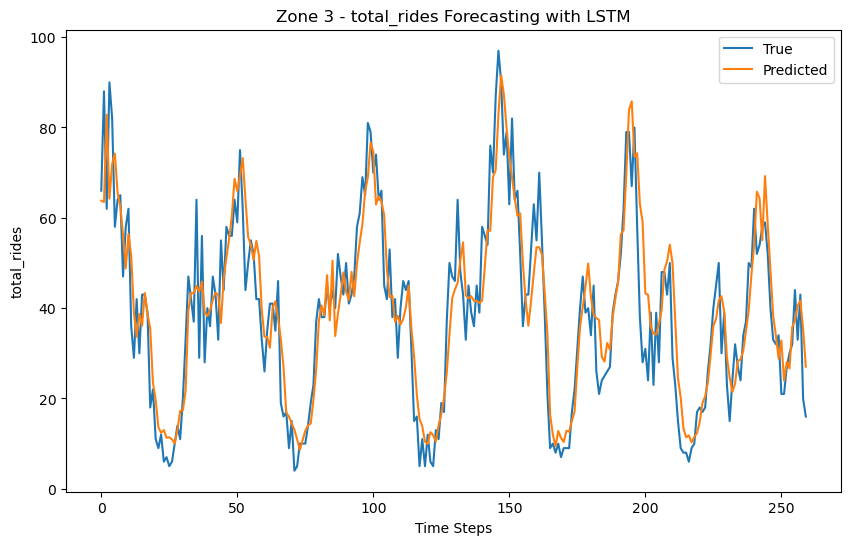

Processing zone 4...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0641  
Epoch 2/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0619
Epoch 3/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0559
Epoch 4/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0645
Epoch 5/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0638
Epoch 6/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 920us/step - loss: 0.0548
Epoch 7/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 0.0634 
Epoch 8/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0639
Epoch 9/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0630
Epoch 10/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0592
Epoch 11/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0578
Epoch 12/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0630
Epoch 13/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0617
Epoch 14/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 931us/step - loss: 0.0534
Epoch 15/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0625
Epoch 16/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 964us/step - 

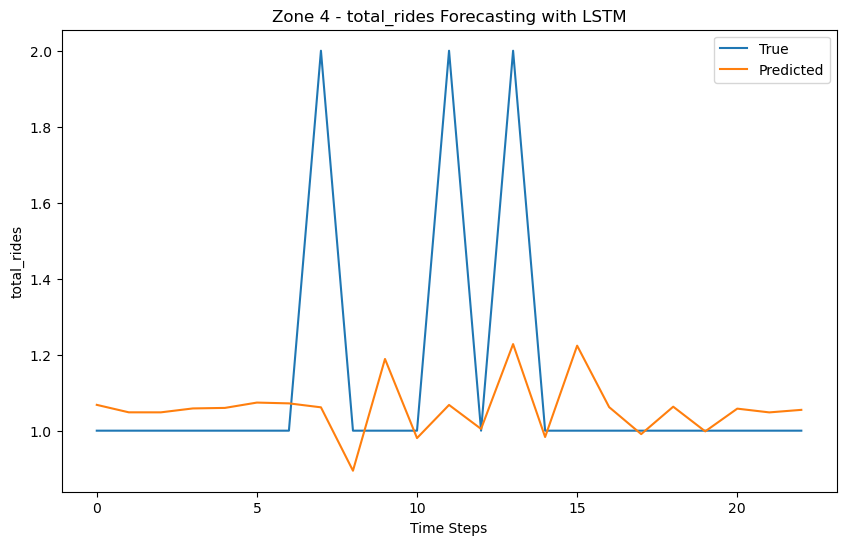

Processing zone 5...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 576us/step - loss: 0.1306
Epoch 2/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 522us/step - loss: 0.0723
Epoch 3/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 553us/step - loss: 0.0341
Epoch 4/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 472us/step - loss: 0.0177
Epoch 5/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 544us/step - loss: 0.0169
Epoch 6/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 499us/step - loss: 0.0152
Epoch 7/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 487us/step - loss: 0.0159
Epoch 8/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 488us/step - loss: 0.0146
Epoch 9/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 487us/step - loss: 0.0151
Epoch 10/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 493us/step - loss: 0.0141
Epoch 11/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 489us/step - loss: 0.0152
Epoch 12/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 489us/step - loss: 0.0146
Epoch 13/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 486us/step - loss: 0.0135
Epoch 14/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 487us/step - loss: 0.0134
Epoch 15/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 485us/step - loss: 0.0127


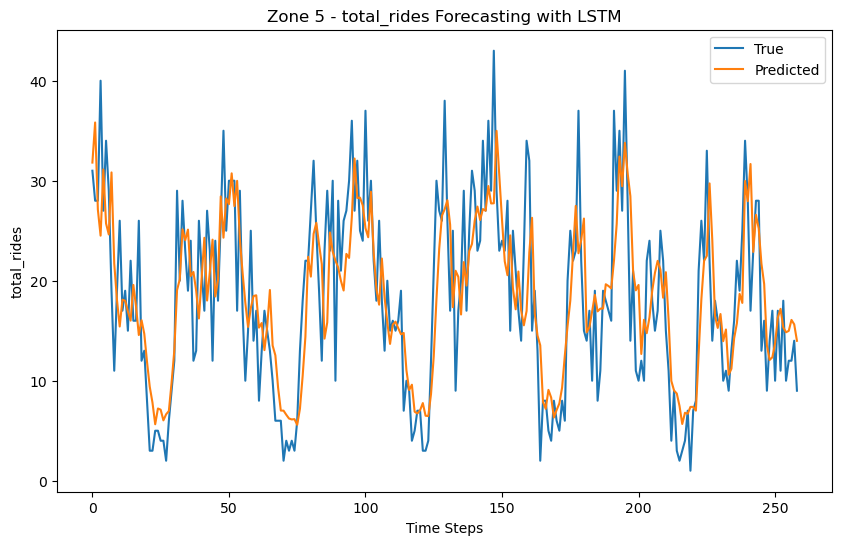

Processing zone 6...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 541us/step - loss: 0.1098
Epoch 2/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 521us/step - loss: 0.0580
Epoch 3/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 472us/step - loss: 0.0302
Epoch 4/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 480us/step - loss: 0.0195
Epoch 5/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 514us/step - loss: 0.0191
Epoch 6/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 518us/step - loss: 0.0192
Epoch 7/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 503us/step - loss: 0.0177
Epoch 8/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 501us/step - loss: 0.0183
Epoch 9/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 499us/step - loss: 0.0183
Epoch 10/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 502us/step - loss: 0.0188
Epoch 11/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 509us/step - loss: 0.0174
Epoch 12/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 498us/step - loss: 0.0191
Epoch 13/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 517us/step - loss: 0.0160
Epoch 14/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 530us/step - loss: 0.0171
Epoch 15/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 578us/step - loss: 0.0165


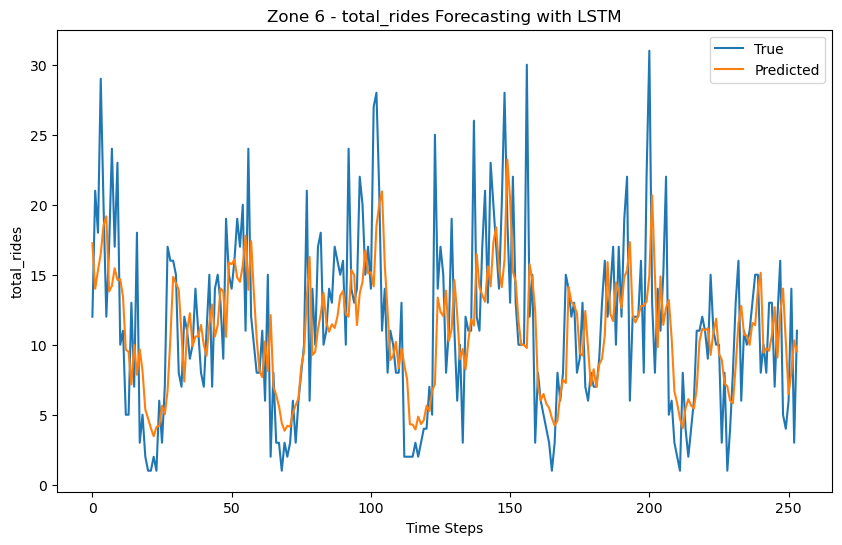

Processing zone 7...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 630us/step - loss: 0.0494
Epoch 2/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 519us/step - loss: 0.0279
Epoch 3/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 484us/step - loss: 0.0224
Epoch 4/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 520us/step - loss: 0.0252
Epoch 5/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 514us/step - loss: 0.0250
Epoch 6/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 500us/step - loss: 0.0255
Epoch 7/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 512us/step - loss: 0.0227
Epoch 8/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 508us/step - loss: 0.0217
Epoch 9/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 523us/step - loss: 0.0245
Epoch 10/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 509us/step - loss: 0.0233
Epoch 11/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 510us/step - loss: 0.0242
Epoch 12/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 519us/step - loss: 0.0242
Epoch 13/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 504us/step - loss: 0.0245
Epoch 14/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 524us/step - loss: 0.0235
Epoch 15/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 520us/step - loss: 0.0227


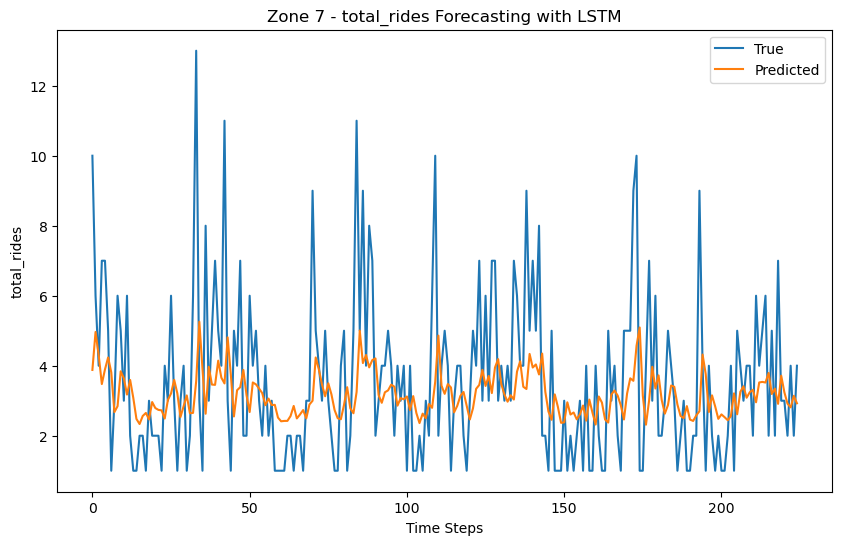

Processing zone 8...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 592us/step - loss: 0.1405
Epoch 2/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 546us/step - loss: 0.0697
Epoch 3/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 532us/step - loss: 0.0272
Epoch 4/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 535us/step - loss: 0.0150
Epoch 5/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 578us/step - loss: 0.0142
Epoch 6/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 500us/step - loss: 0.0136
Epoch 7/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 518us/step - loss: 0.0136
Epoch 8/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 520us/step - loss: 0.0129
Epoch 9/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 508us/step - loss: 0.0121
Epoch 10/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 497us/step - loss: 0.0117
Epoch 11/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 564us/step - loss: 0.0119
Epoch 12/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 531us/step - loss: 0.0109
Epoch 13/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 524us/step - loss: 0.0109
Epoch 14/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 518us/step - loss: 0.0103
Epoch 15/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 522us/step - loss: 0.0104


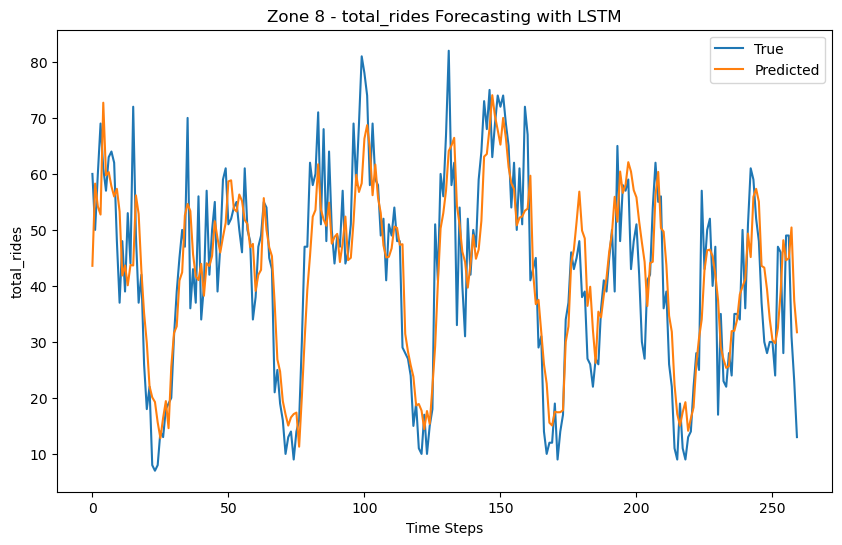

Processing zone 9...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 606us/step - loss: 0.0465
Epoch 2/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 609us/step - loss: 0.0339
Epoch 3/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 547us/step - loss: 0.0278
Epoch 4/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 551us/step - loss: 0.0271
Epoch 5/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 567us/step - loss: 0.0308
Epoch 6/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 513us/step - loss: 0.0294
Epoch 7/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 545us/step - loss: 0.0305
Epoch 8/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 500us/step - loss: 0.0287
Epoch 9/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 500us/step - loss: 0.0287
Epoch 10/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 514us/step - loss: 0.0293
Epoch 11/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 517us/step - loss: 0.0291
Epoch 12/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 511us/step - loss: 0.0279
Epoch 13/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 527us/step - loss: 0.0267
Epoch 14/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 598us/step - loss: 0.0272
Epoch 15/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 574us/step - loss: 0.0298


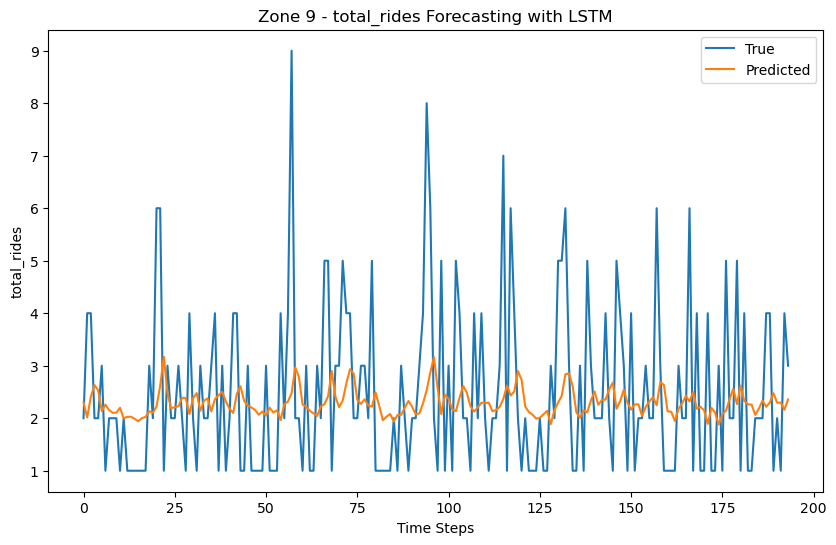

Processing zone 10...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 553us/step - loss: 0.1036
Epoch 2/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 601us/step - loss: 0.0588
Epoch 3/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 444us/step - loss: 0.0352
Epoch 4/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 734us/step - loss: 0.0264
Epoch 5/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 561us/step - loss: 0.0247
Epoch 6/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 476us/step - loss: 0.0240
Epoch 7/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 493us/step - loss: 0.0241
Epoch 8/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 511us/step - loss: 0.0243
Epoch 9/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 500us/step - loss: 0.0255
Epoch 10/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 492us/step - loss: 0.0250
Epoch 11/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 489us/step - loss: 0.0255
Epoch 12/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 496us/step - loss: 0.0244
Epoch 13/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 493us/step - loss: 0.0244
Epoch 14/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 497us/step - loss: 0.0251
Epoch 15/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 496us/step - loss: 0.0236


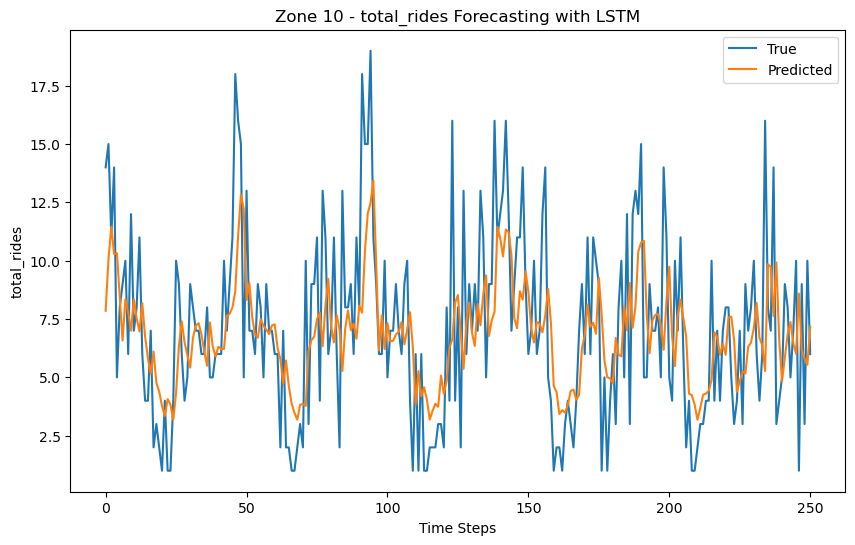

Processing zone 11...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 661us/step - loss: 0.0430
Epoch 2/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 659us/step - loss: 0.0282
Epoch 3/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 557us/step - loss: 0.0274
Epoch 4/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 505us/step - loss: 0.0304
Epoch 5/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 612us/step - loss: 0.0288
Epoch 6/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 549us/step - loss: 0.0308
Epoch 7/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 536us/step - loss: 0.0278
Epoch 8/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 579us/step - loss: 0.0299
Epoch 9/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 579us/step - loss: 0.0283
Epoch 10/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 607us/step - loss: 0.0260
Epoch 11/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 532us/step - loss: 0.0295
Epoch 12/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 547us/step - loss: 0.0303
Epoch 13/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 568us/step - loss: 0.0293
Epoch 14/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 574us/step - loss: 0.0283
Epoch 15/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 559us/step - loss: 0.0277
Epoch 16/20
8/8 ━━━━━━━━━━━━━━

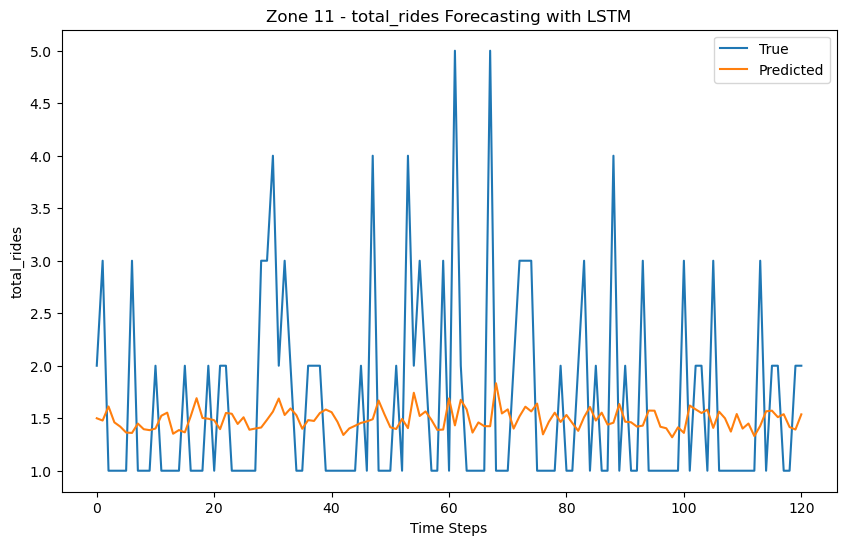

Processing zone 12...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 563us/step - loss: 0.1109
Epoch 2/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0492 
Epoch 3/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 679us/step - loss: 0.0234
Epoch 4/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 533us/step - loss: 0.0142
Epoch 5/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 599us/step - loss: 0.0133
Epoch 6/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 600us/step - loss: 0.0130
Epoch 7/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 549us/step - loss: 0.0123
Epoch 8/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 528us/step - loss: 0.0120
Epoch 9/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 523us/step - loss: 0.0118
Epoch 10/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 513us/step - loss: 0.0121
Epoch 11/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 530us/step - loss: 0.0112
Epoch 12/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 567us/step - loss: 0.0109
Epoch 13/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 623us/step - loss: 0.0106
Epoch 14/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 575us/step - loss: 0.0096
Epoch 15/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 542us/step - loss: 0.0104
E

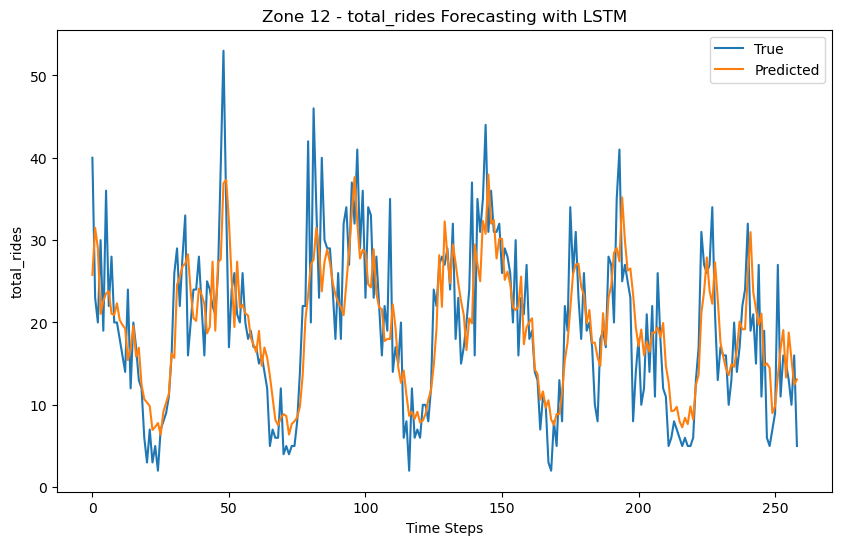

Processing zone 13...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 586us/step - loss: 0.0969
Epoch 2/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 504us/step - loss: 0.0486
Epoch 3/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 477us/step - loss: 0.0275
Epoch 4/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 475us/step - loss: 0.0218
Epoch 5/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 553us/step - loss: 0.0231
Epoch 6/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 592us/step - loss: 0.0233
Epoch 7/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 545us/step - loss: 0.0226
Epoch 8/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 537us/step - loss: 0.0228
Epoch 9/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 548us/step - loss: 0.0215
Epoch 10/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 553us/step - loss: 0.0217
Epoch 11/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 561us/step - loss: 0.0216
Epoch 12/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 561us/step - loss: 0.0205
Epoch 13/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 581us/step - loss: 0.0209
Epoch 14/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 577us/step - loss: 0.0220
Epoch 15/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 555us/step - loss: 0.0207


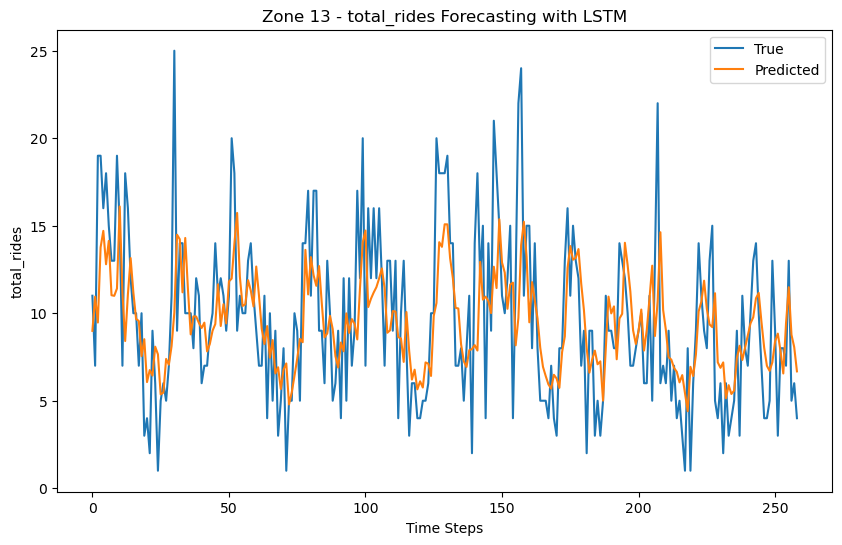

Processing zone 14...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 592us/step - loss: 0.1167
Epoch 2/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 539us/step - loss: 0.0633
Epoch 3/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 566us/step - loss: 0.0426
Epoch 4/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 535us/step - loss: 0.0304
Epoch 5/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 528us/step - loss: 0.0333
Epoch 6/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 543us/step - loss: 0.0306
Epoch 7/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 520us/step - loss: 0.0315
Epoch 8/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 530us/step - loss: 0.0322
Epoch 9/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 523us/step - loss: 0.0320
Epoch 10/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 522us/step - loss: 0.0338
Epoch 11/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 517us/step - loss: 0.0325
Epoch 12/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 528us/step - loss: 0.0307
Epoch 13/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 530us/step - loss: 0.0328
Epoch 14/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 530us/step - loss: 0.0321
Epoch 15/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 527us/step - loss: 0.0299


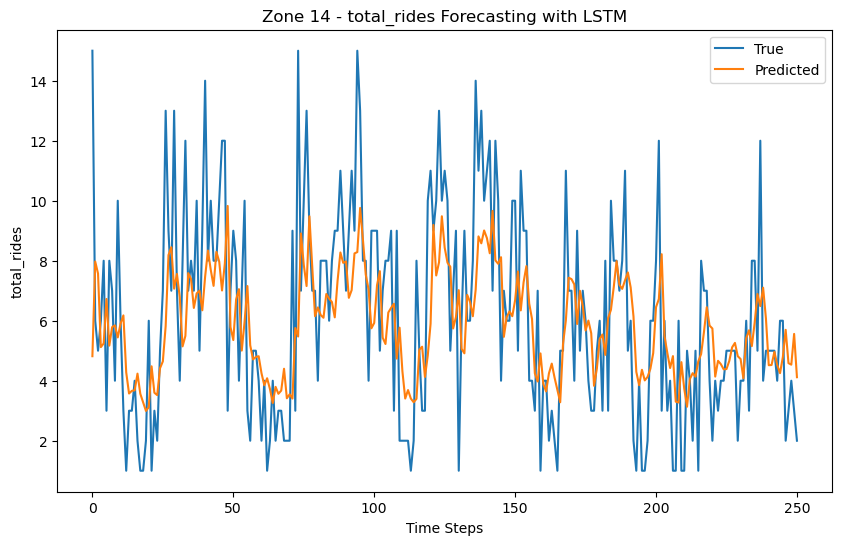

Processing zone 15...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 616us/step - loss: 0.0348
Epoch 2/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 548us/step - loss: 0.0227
Epoch 3/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 565us/step - loss: 0.0243
Epoch 4/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 566us/step - loss: 0.0241
Epoch 5/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 571us/step - loss: 0.0229
Epoch 6/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 510us/step - loss: 0.0255
Epoch 7/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 542us/step - loss: 0.0230
Epoch 8/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 548us/step - loss: 0.0257
Epoch 9/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 519us/step - loss: 0.0257
Epoch 10/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 561us/step - loss: 0.0239
Epoch 11/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 561us/step - loss: 0.0220
Epoch 12/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 544us/step - loss: 0.0250
Epoch 13/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 522us/step - loss: 0.0245
Epoch 14/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 537us/step - loss: 0.0234
Epoch 15/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 535us/step - loss: 0.0214


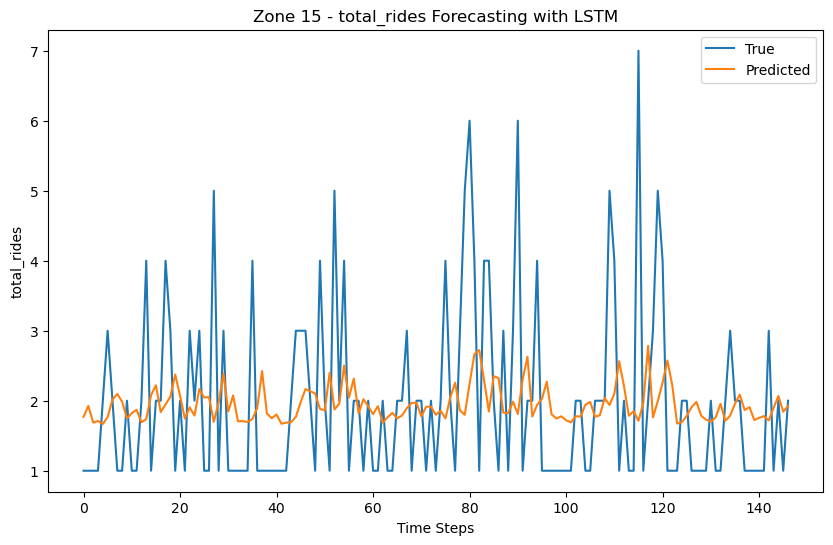

Processing zone 16...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0321  
Epoch 2/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 745us/step - loss: 0.0296
Epoch 3/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 758us/step - loss: 0.0256
Epoch 4/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 757us/step - loss: 0.0269
Epoch 5/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 828us/step - loss: 0.0206
Epoch 6/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 974us/step - loss: 0.0211
Epoch 7/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0234
Epoch 8/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 650us/step - loss: 0.0225
Epoch 9/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 840us/step - loss: 0.0285
Epoch 10/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 663us/step - loss: 0.0224
Epoch 11/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 905us/step - loss: 0.0212
Epoch 12/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 918us/step - loss: 0.0189
Epoch 13/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 746us/step - loss: 0.0235
Epoch 14/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 888us/step - loss: 0.0276
Epoch 15/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 705us/step - loss: 0.0229
Epoch 16/20
4/4 ━━━━━━━━━━━━━━━━

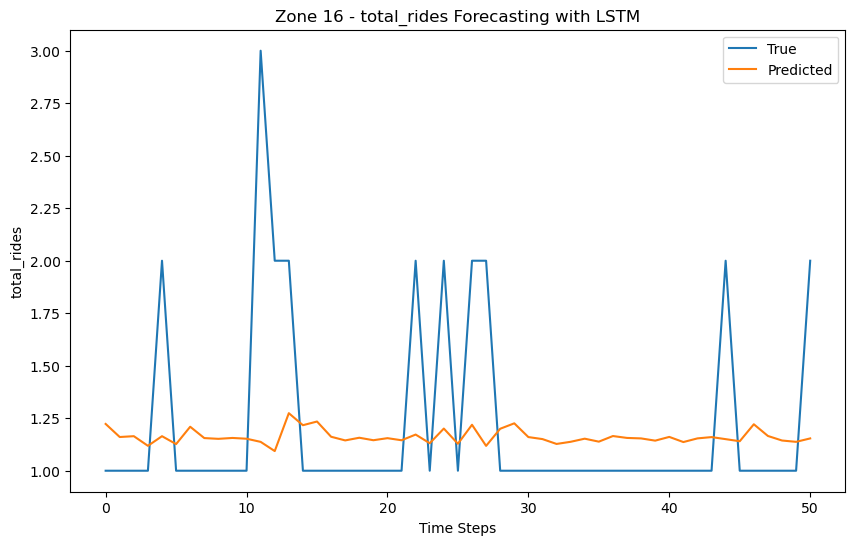

Processing zone 17...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


17/17 ━━━━━━━━━━━━━━━━━━━━ 1s 501us/step - loss: 0.1395
Epoch 2/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 501us/step - loss: 0.0633
Epoch 3/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 482us/step - loss: 0.0257
Epoch 4/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 492us/step - loss: 0.0128
Epoch 5/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 503us/step - loss: 0.0124
Epoch 6/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 483us/step - loss: 0.0124
Epoch 7/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 499us/step - loss: 0.0116
Epoch 8/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 488us/step - loss: 0.0105
Epoch 9/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 488us/step - loss: 0.0107
Epoch 10/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 481us/step - loss: 0.0105
Epoch 11/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 494us/step - loss: 0.0100
Epoch 12/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 493us/step - loss: 0.0096
Epoch 13/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 491us/step - loss: 0.0096
Epoch 14/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 490us/step - loss: 0.0095
Epoch 15/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 492us/step - loss: 0.0095


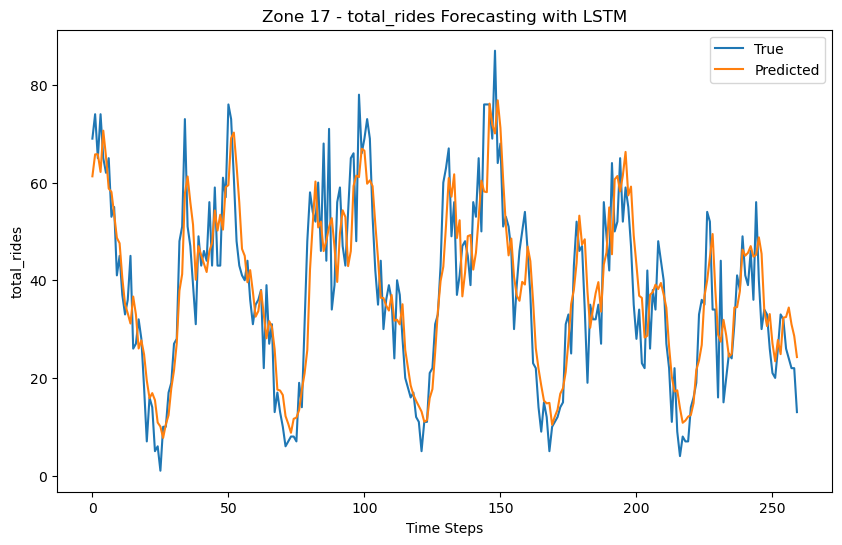

Processing zone 18...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 595us/step - loss: 0.1202
Epoch 2/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 536us/step - loss: 0.0622
Epoch 3/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 540us/step - loss: 0.0338
Epoch 4/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 484us/step - loss: 0.0205
Epoch 5/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 544us/step - loss: 0.0207
Epoch 6/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 501us/step - loss: 0.0203
Epoch 7/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 496us/step - loss: 0.0198
Epoch 8/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 488us/step - loss: 0.0205
Epoch 9/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 488us/step - loss: 0.0187
Epoch 10/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 495us/step - loss: 0.0198
Epoch 11/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 487us/step - loss: 0.0210
Epoch 12/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 493us/step - loss: 0.0198
Epoch 13/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 487us/step - loss: 0.0193
Epoch 14/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 493us/step - loss: 0.0194
Epoch 15/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 501us/step - loss: 0.0206


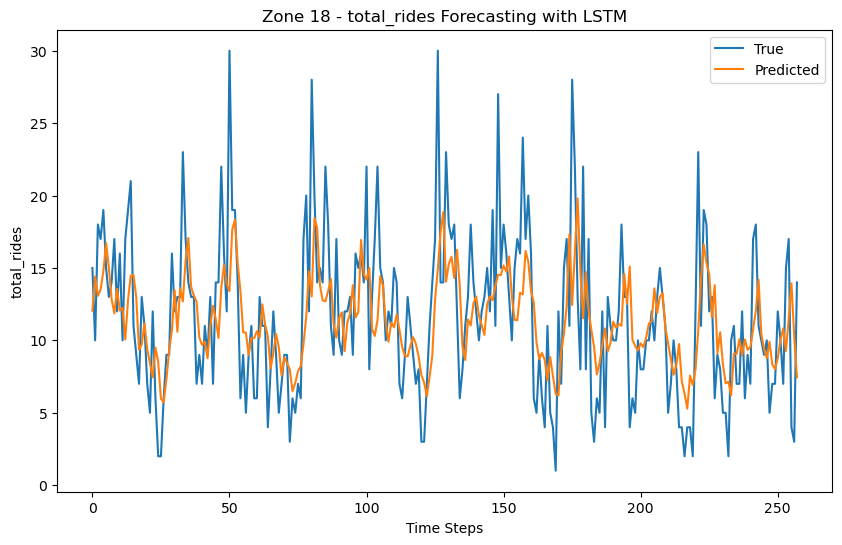

Processing zone 19...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 553us/step - loss: 0.0422
Epoch 2/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 442us/step - loss: 0.0294
Epoch 3/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 444us/step - loss: 0.0271
Epoch 4/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 464us/step - loss: 0.0274
Epoch 5/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 439us/step - loss: 0.0262
Epoch 6/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 550us/step - loss: 0.0259
Epoch 7/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 472us/step - loss: 0.0254
Epoch 8/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 578us/step - loss: 0.0289
Epoch 9/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 552us/step - loss: 0.0262
Epoch 10/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 541us/step - loss: 0.0277
Epoch 11/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 523us/step - loss: 0.0304
Epoch 12/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 520us/step - loss: 0.0254
Epoch 13/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 528us/step - loss: 0.0256
Epoch 14/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 535us/step - loss: 0.0278
Epoch 15/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 663us/step - loss: 0.0291


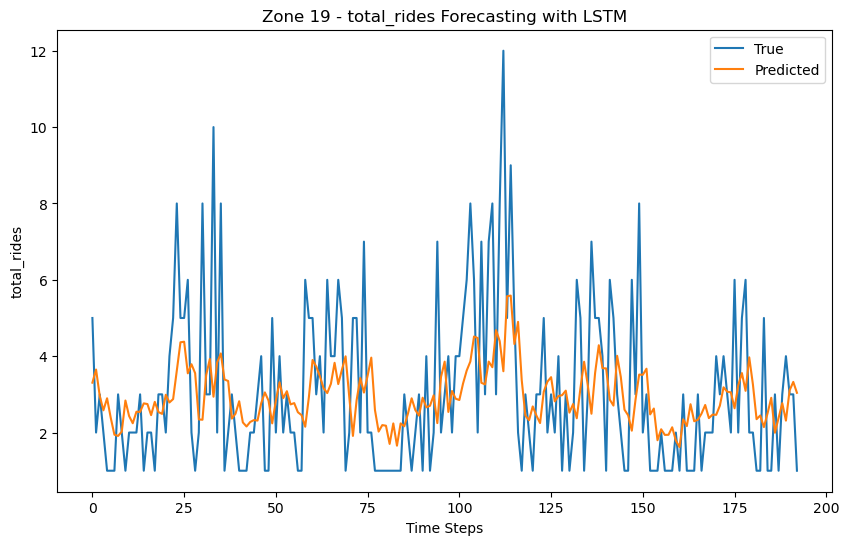

Processing zone 21...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 676us/step - loss: 0.0210
Epoch 2/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 601us/step - loss: 0.0133
Epoch 3/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 588us/step - loss: 0.0111
Epoch 4/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 581us/step - loss: 0.0128
Epoch 5/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 536us/step - loss: 0.0128
Epoch 6/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 533us/step - loss: 0.0127
Epoch 7/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 585us/step - loss: 0.0122
Epoch 8/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 538us/step - loss: 0.0124
Epoch 9/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 511us/step - loss: 0.0109
Epoch 10/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 668us/step - loss: 0.0118
Epoch 11/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 580us/step - loss: 0.0120
Epoch 12/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 591us/step - loss: 0.0113
Epoch 13/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 553us/step - loss: 0.0130
Epoch 14/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 564us/step - loss: 0.0113
Epoch 15/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 570us/step - loss: 0.0119
Epoch 16/20
7/7 ━━━━━━━━━━━━━━

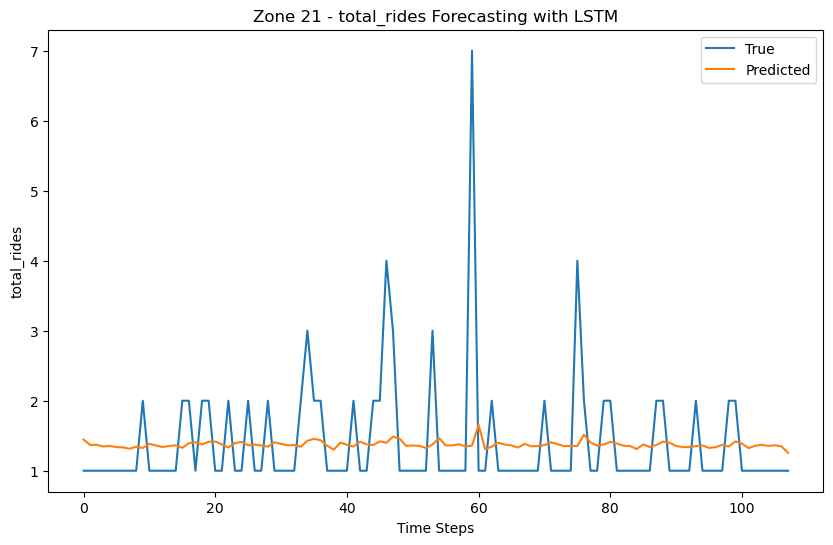

Processing zone 22...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 771us/step - loss: 0.0501
Epoch 2/20
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 699us/step - loss: 0.0355
Epoch 3/20
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 627us/step - loss: 0.0313
Epoch 4/20
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 624us/step - loss: 0.0416
Epoch 5/20
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 639us/step - loss: 0.0365
Epoch 6/20
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 578us/step - loss: 0.0330
Epoch 7/20
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 600us/step - loss: 0.0407
Epoch 8/20
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 605us/step - loss: 0.0368
Epoch 9/20
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 642us/step - loss: 0.0381
Epoch 10/20
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 577us/step - loss: 0.0379
Epoch 11/20
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 645us/step - loss: 0.0397
Epoch 12/20
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 643us/step - loss: 0.0355
Epoch 13/20
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 777us/step - loss: 0.0347
Epoch 14/20
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 549us/step - loss: 0.0366
Epoch 15/20
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 618us/step - loss: 0.0350
Epoch 16/20
5/5 ━━━━━━━━━━━━━━

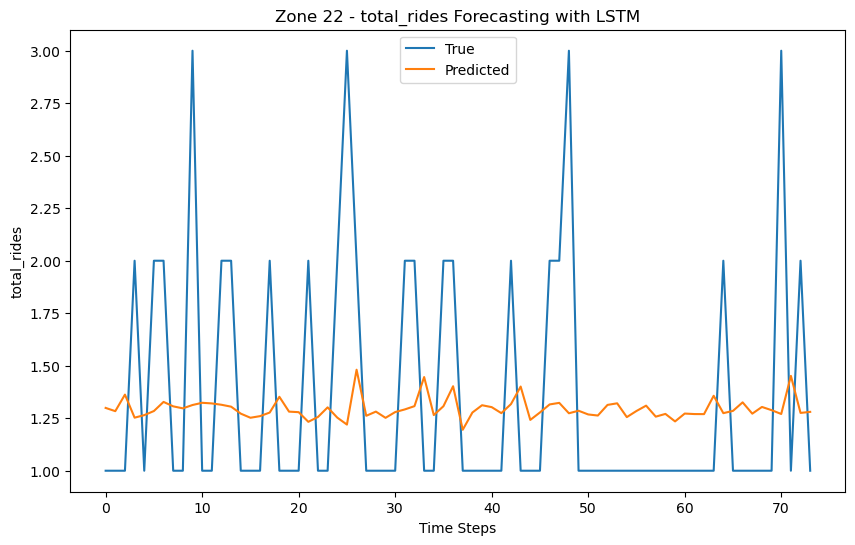

Processing zone 23...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0337  
Epoch 2/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0355
Epoch 3/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0321
Epoch 4/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0326
Epoch 5/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0316
Epoch 6/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0284
Epoch 7/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0240
Epoch 8/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 875us/step - loss: 0.0245
Epoch 9/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0303
Epoch 10/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0287
Epoch 11/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0269
Epoch 12/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0237
Epoch 13/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0275
Epoch 14/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0271
Epoch 15/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0293
Epoch 16/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss:

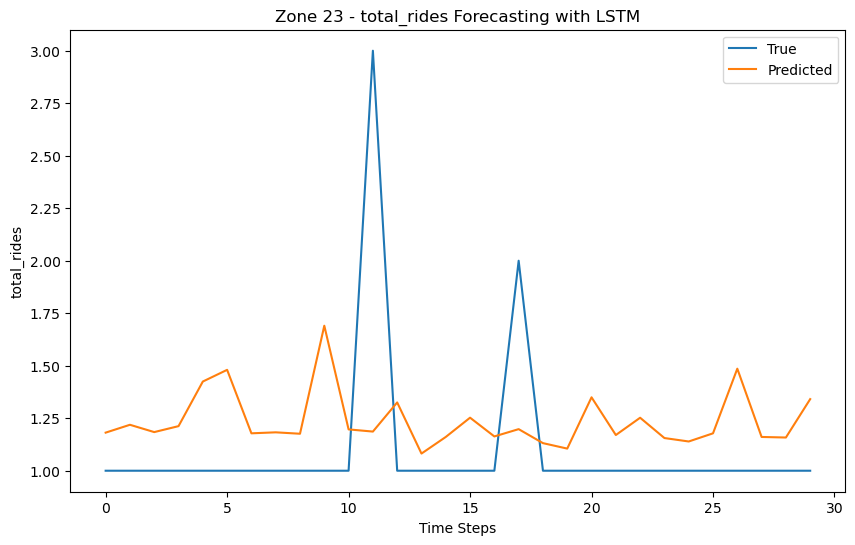

Processing zone 24...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 605us/step - loss: 0.0681
Epoch 2/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 535us/step - loss: 0.0466
Epoch 3/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 491us/step - loss: 0.0309
Epoch 4/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 517us/step - loss: 0.0283
Epoch 5/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 545us/step - loss: 0.0270
Epoch 6/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 470us/step - loss: 0.0287
Epoch 7/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 514us/step - loss: 0.0290
Epoch 8/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 493us/step - loss: 0.0289
Epoch 9/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 500us/step - loss: 0.0272
Epoch 10/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 511us/step - loss: 0.0287
Epoch 11/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 504us/step - loss: 0.0298
Epoch 12/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 535us/step - loss: 0.0287
Epoch 13/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 498us/step - loss: 0.0290
Epoch 14/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 508us/step - loss: 0.0269
Epoch 15/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 508us/step - loss: 0.0263


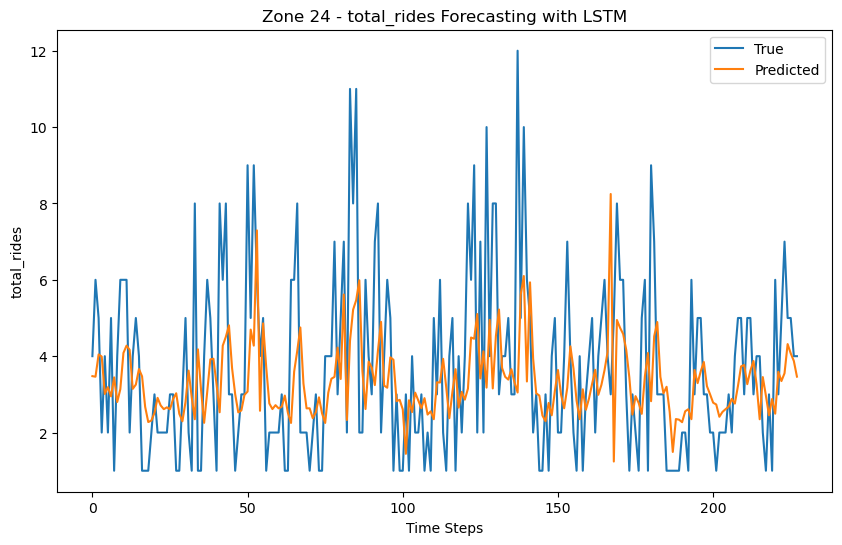

Processing zone 25...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 395ms/step - loss: 0.0624
Epoch 2/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0612
Epoch 3/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0602
Epoch 4/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0593
Epoch 5/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0586
Epoch 6/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0580
Epoch 7/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0574
Epoch 8/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0570
Epoch 9/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0567
Epoch 10/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0564
Epoch 11/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0561
Epoch 12/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0559
Epoch 13/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0557
Epoch 14/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0555
Epoch 15/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0553
Epoch 16/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0

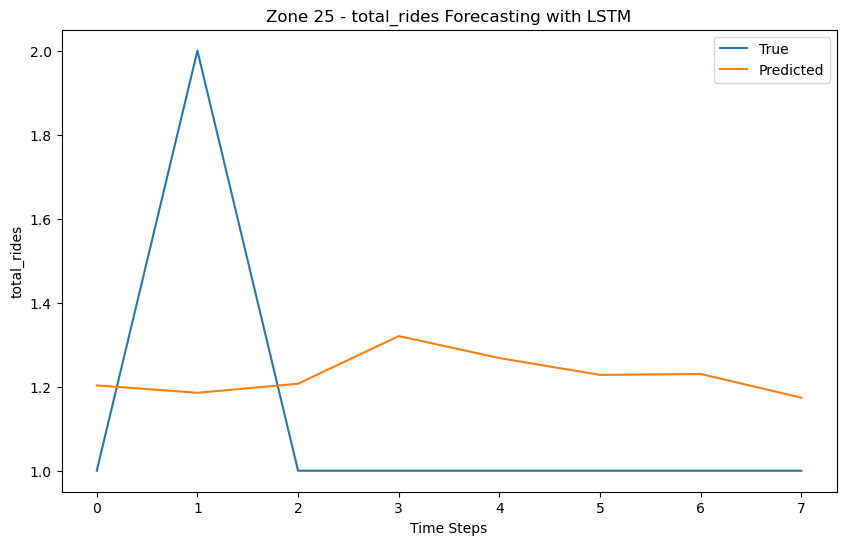

Processing zone 26...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 735us/step - loss: 0.0594
Epoch 2/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0422
Epoch 3/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 754us/step - loss: 0.0455
Epoch 4/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 716us/step - loss: 0.0477
Epoch 5/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 699us/step - loss: 0.0439
Epoch 6/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 707us/step - loss: 0.0506
Epoch 7/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 826us/step - loss: 0.0495
Epoch 8/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0440 
Epoch 9/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 645us/step - loss: 0.0415
Epoch 10/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 698us/step - loss: 0.0428
Epoch 11/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 772us/step - loss: 0.0444
Epoch 12/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 724us/step - loss: 0.0448
Epoch 13/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 680us/step - loss: 0.0421
Epoch 14/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 677us/step - loss: 0.0441
Epoch 15/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 630us/step - loss: 0.0406
Epoch 16/20
4/4 ━━━━━━━━━━━━━━━━━

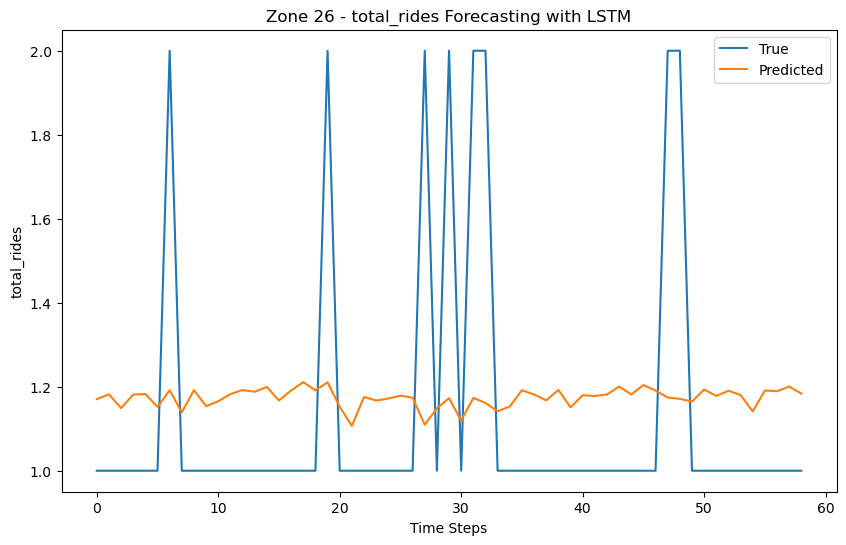

Processing zone 27...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 660us/step - loss: 0.0259
Epoch 2/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 642us/step - loss: 0.0227
Epoch 3/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 625us/step - loss: 0.0194
Epoch 4/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 734us/step - loss: 0.0168
Epoch 5/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 561us/step - loss: 0.0195
Epoch 6/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 544us/step - loss: 0.0178
Epoch 7/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 699us/step - loss: 0.0182
Epoch 8/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 512us/step - loss: 0.0176
Epoch 9/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 571us/step - loss: 0.0173
Epoch 10/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 563us/step - loss: 0.0213
Epoch 11/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 568us/step - loss: 0.0208
Epoch 12/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 631us/step - loss: 0.0185
Epoch 13/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 586us/step - loss: 0.0180
Epoch 14/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 548us/step - loss: 0.0172
Epoch 15/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 550us/step - loss: 0.0184
Epoch 16/20
8/8 ━━━━━━━━━━━━━━

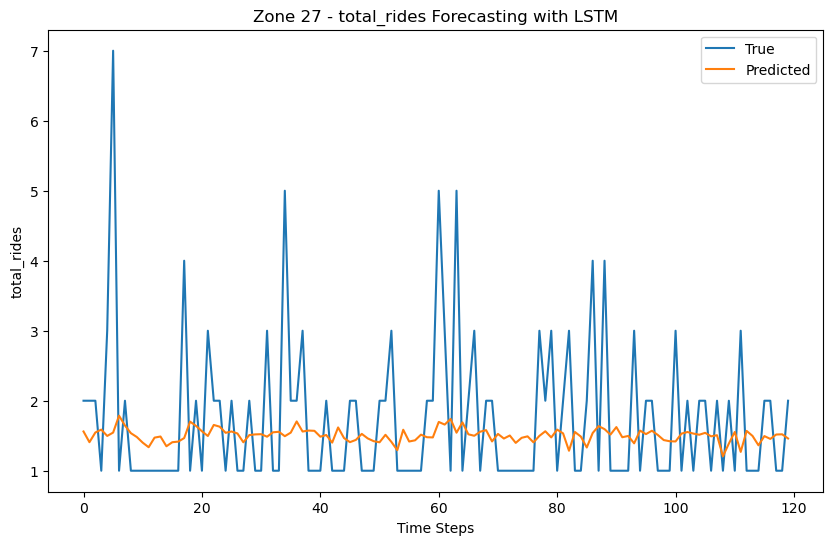

Processing zone 28...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0779  
Epoch 2/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 751us/step - loss: 0.0727
Epoch 3/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 746us/step - loss: 0.0618
Epoch 4/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 772us/step - loss: 0.0641
Epoch 5/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 691us/step - loss: 0.0669
Epoch 6/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 687us/step - loss: 0.0697
Epoch 7/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 912us/step - loss: 0.0603
Epoch 8/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 721us/step - loss: 0.0701
Epoch 9/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 737us/step - loss: 0.0670
Epoch 10/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 693us/step - loss: 0.0623
Epoch 11/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 671us/step - loss: 0.0628
Epoch 12/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 759us/step - loss: 0.0618
Epoch 13/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 717us/step - loss: 0.0658
Epoch 14/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 708us/step - loss: 0.0656
Epoch 15/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 701us/step - loss: 0.0699
Epoch 16/20
3/3 ━━━━━━━━━━━━━━

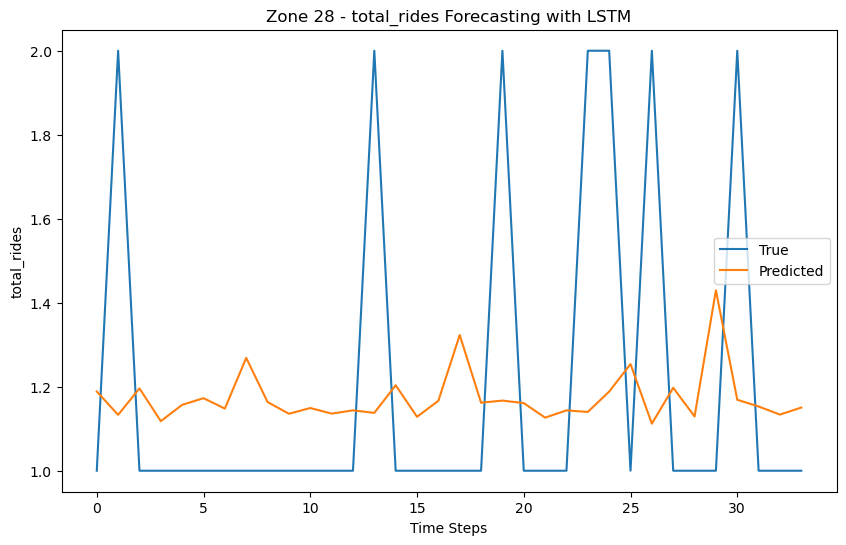

Processing zone 30...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 755us/step - loss: 0.0426
Epoch 2/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 581us/step - loss: 0.0328
Epoch 3/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 597us/step - loss: 0.0317
Epoch 4/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 570us/step - loss: 0.0328
Epoch 5/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 597us/step - loss: 0.0339
Epoch 6/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 568us/step - loss: 0.0340
Epoch 7/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 534us/step - loss: 0.0342
Epoch 8/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 572us/step - loss: 0.0343
Epoch 9/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 577us/step - loss: 0.0313
Epoch 10/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 621us/step - loss: 0.0336
Epoch 11/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 534us/step - loss: 0.0380
Epoch 12/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 560us/step - loss: 0.0345
Epoch 13/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 562us/step - loss: 0.0357
Epoch 14/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 605us/step - loss: 0.0274
Epoch 15/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 561us/step - loss: 0.0301
Epoch 16/20
7/7 ━━━━━━━━━━━━━━

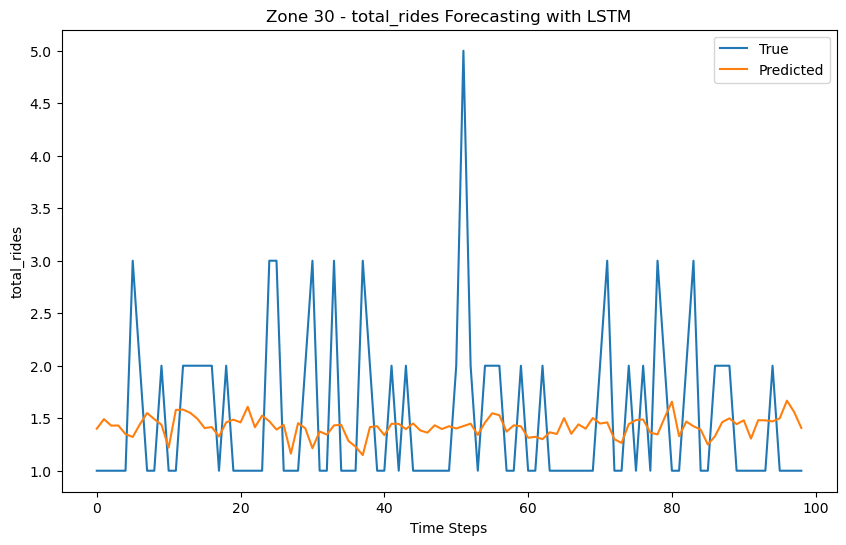

Processing zone 31...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 393ms/step - loss: 0.0469
Epoch 2/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0463
Epoch 3/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0460
Epoch 4/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0457
Epoch 5/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0456
Epoch 6/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0456
Epoch 7/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0456
Epoch 8/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0456
Epoch 9/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0455
Epoch 10/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0455
Epoch 11/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0454
Epoch 12/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0453
Epoch 13/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0452
Epoch 14/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0451
Epoch 15/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0451
Epoch 16/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0

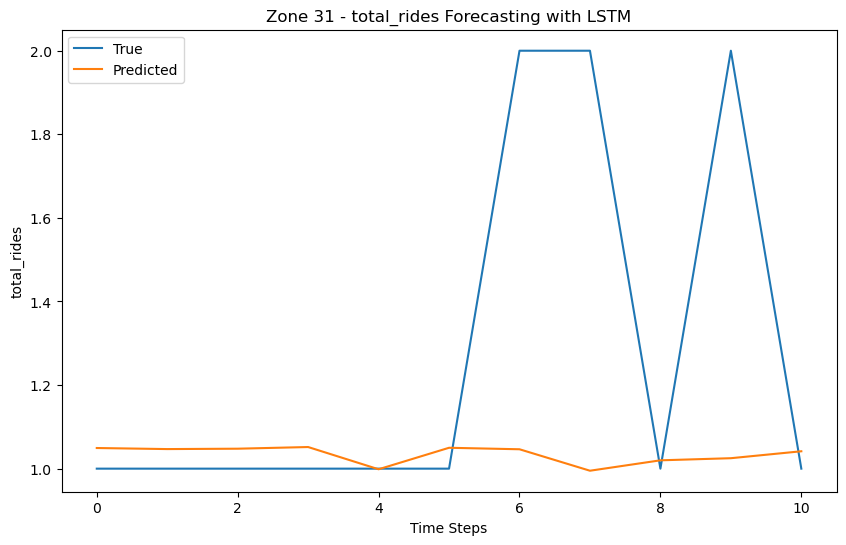

Processing zone 32...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 588us/step - loss: 0.0554
Epoch 2/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 514us/step - loss: 0.0346
Epoch 3/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 519us/step - loss: 0.0304
Epoch 4/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 494us/step - loss: 0.0279
Epoch 5/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 460us/step - loss: 0.0300
Epoch 6/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 605us/step - loss: 0.0275
Epoch 7/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 525us/step - loss: 0.0284
Epoch 8/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 542us/step - loss: 0.0281
Epoch 9/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 550us/step - loss: 0.0288
Epoch 10/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 531us/step - loss: 0.0289
Epoch 11/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 516us/step - loss: 0.0292
Epoch 12/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 525us/step - loss: 0.0288
Epoch 13/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 534us/step - loss: 0.0285
Epoch 14/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 519us/step - loss: 0.0256
Epoch 15/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 523us/step - loss: 0.0285


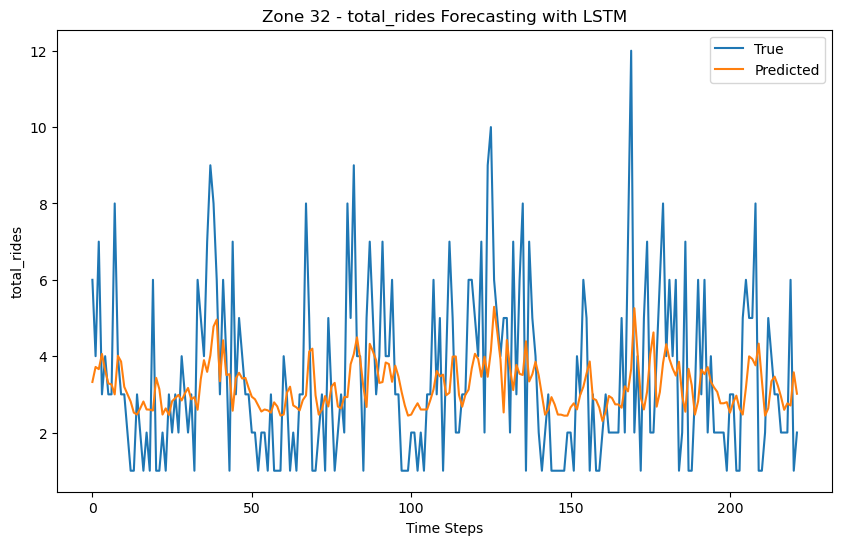

Processing zone 33...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 935us/step - loss: 0.0195
Epoch 2/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 786us/step - loss: 0.0159
Epoch 3/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 796us/step - loss: 0.0137
Epoch 4/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 741us/step - loss: 0.0153
Epoch 5/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 692us/step - loss: 0.0165
Epoch 6/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 806us/step - loss: 0.0140
Epoch 7/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 757us/step - loss: 0.0153
Epoch 8/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 734us/step - loss: 0.0132
Epoch 9/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 688us/step - loss: 0.0175
Epoch 10/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 710us/step - loss: 0.0159
Epoch 11/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 667us/step - loss: 0.0175
Epoch 12/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 731us/step - loss: 0.0142
Epoch 13/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 710us/step - loss: 0.0137
Epoch 14/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 737us/step - loss: 0.0181
Epoch 15/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 784us/step - loss: 0.0178
Epoch 16/20
3/3 ━━━━━━━━━━━━━━

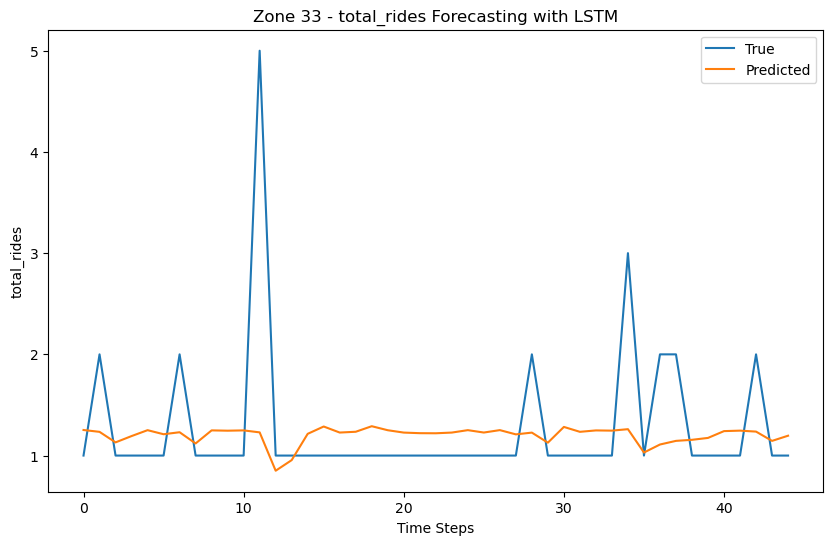

Processing zone 34...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 408ms/step - loss: 0.0460
Epoch 2/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0453
Epoch 3/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0447
Epoch 4/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0441
Epoch 5/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0436
Epoch 6/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0432
Epoch 7/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0428
Epoch 8/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0424
Epoch 9/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0421
Epoch 10/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0418
Epoch 11/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0416
Epoch 12/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0414
Epoch 13/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0412
Epoch 14/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0410
Epoch 15/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0409
Epoch 16/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0

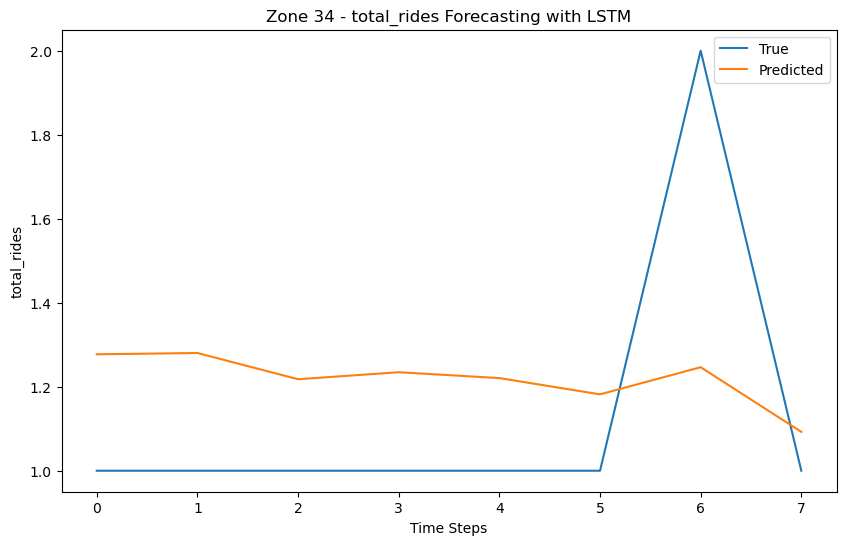

Processing zone 35...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 627us/step - loss: 0.0397
Epoch 2/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 585us/step - loss: 0.0247
Epoch 3/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 556us/step - loss: 0.0225
Epoch 4/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 516us/step - loss: 0.0226
Epoch 5/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 564us/step - loss: 0.0224
Epoch 6/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 596us/step - loss: 0.0225
Epoch 7/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 553us/step - loss: 0.0278
Epoch 8/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 538us/step - loss: 0.0242
Epoch 9/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 502us/step - loss: 0.0219
Epoch 10/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 553us/step - loss: 0.0229
Epoch 11/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 530us/step - loss: 0.0231
Epoch 12/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 533us/step - loss: 0.0207
Epoch 13/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 552us/step - loss: 0.0232
Epoch 14/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 549us/step - loss: 0.0223
Epoch 15/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 568us/step - loss: 0.0219


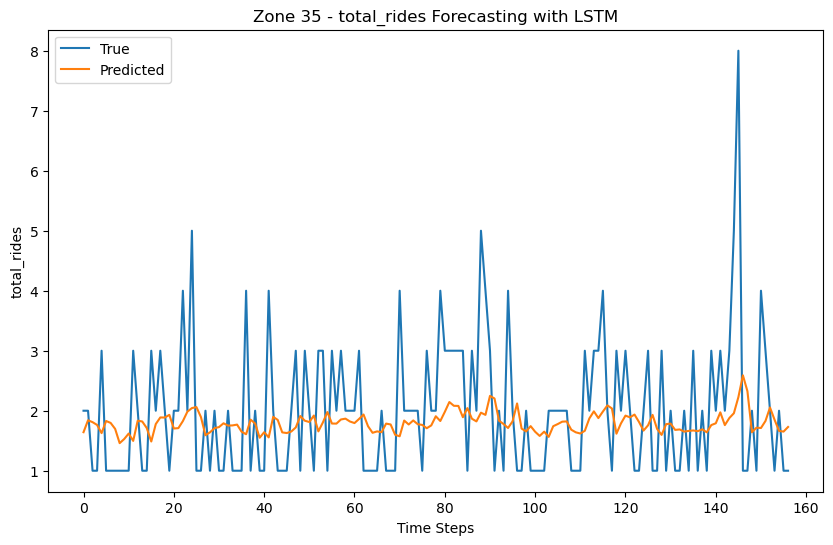

Processing zone 36...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 635us/step - loss: 0.0381
Epoch 2/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 563us/step - loss: 0.0305
Epoch 3/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 609us/step - loss: 0.0273
Epoch 4/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 569us/step - loss: 0.0288
Epoch 5/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 562us/step - loss: 0.0331
Epoch 6/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 532us/step - loss: 0.0319
Epoch 7/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 530us/step - loss: 0.0340
Epoch 8/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 610us/step - loss: 0.0308
Epoch 9/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 528us/step - loss: 0.0328
Epoch 10/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 579us/step - loss: 0.0319
Epoch 11/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 549us/step - loss: 0.0314
Epoch 12/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 546us/step - loss: 0.0278
Epoch 13/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 556us/step - loss: 0.0294
Epoch 14/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 564us/step - loss: 0.0291
Epoch 15/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 574us/step - loss: 0.0326


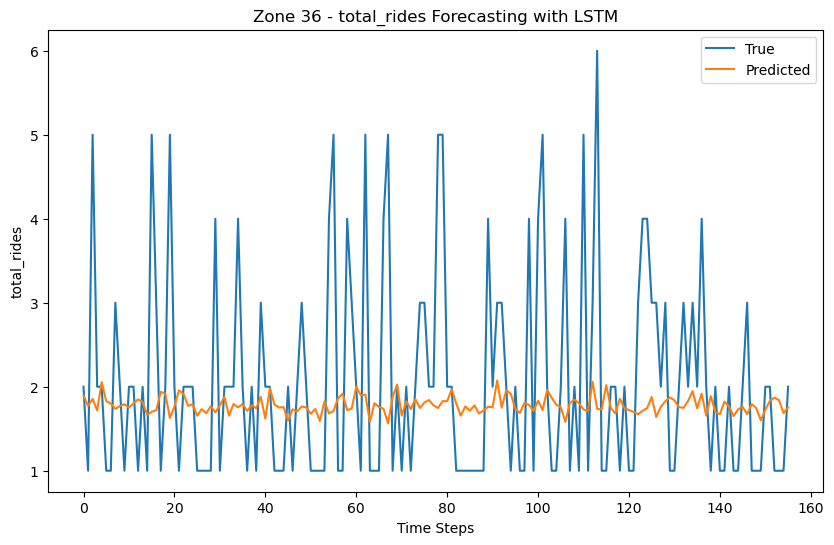

Processing zone 37...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 402ms/step - loss: 0.0962
Epoch 2/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0947
Epoch 3/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0934
Epoch 4/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0922
Epoch 5/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0911
Epoch 6/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0901
Epoch 7/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0893
Epoch 8/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0886
Epoch 9/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0880
Epoch 10/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0875
Epoch 11/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0871
Epoch 12/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0868
Epoch 13/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0865
Epoch 14/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0863
Epoch 15/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0861
Epoch 16/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0

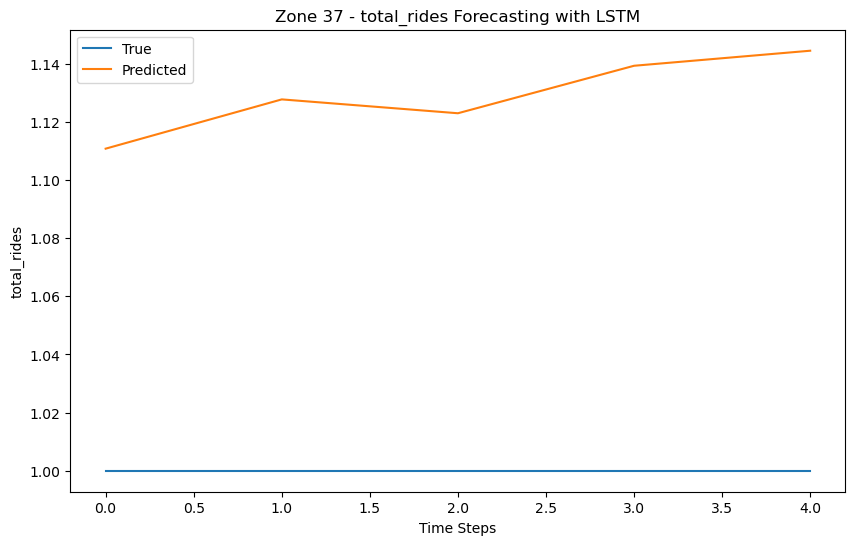

In [24]:
# Forecast total rides per zone using LSTM
lstm_results_rides, mse_df_rides = apply_lstm_forecasting(features_df, zone_column='zone',
                                                          target_column='total_rides', time_column='start_time')


Processing zone 0...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


17/17 ━━━━━━━━━━━━━━━━━━━━ 1s 541us/step - loss: 0.0068 
Epoch 2/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 524us/step - loss: 0.0054
Epoch 3/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 510us/step - loss: 0.0067
Epoch 4/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 505us/step - loss: 0.0049
Epoch 5/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 511us/step - loss: 0.0045
Epoch 6/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 488us/step - loss: 0.0031
Epoch 7/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 502us/step - loss: 0.0036
Epoch 8/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 493us/step - loss: 0.0035
Epoch 9/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 491us/step - loss: 0.0015
Epoch 10/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 478us/step - loss: 0.0017
Epoch 11/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 488us/step - loss: 0.0012  
Epoch 12/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 485us/step - loss: 0.0011  
Epoch 13/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 490us/step - loss: 6.4138e-04
Epoch 14/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 486us/step - loss: 9.0483e-04
Epoch 15/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 493us/step - 

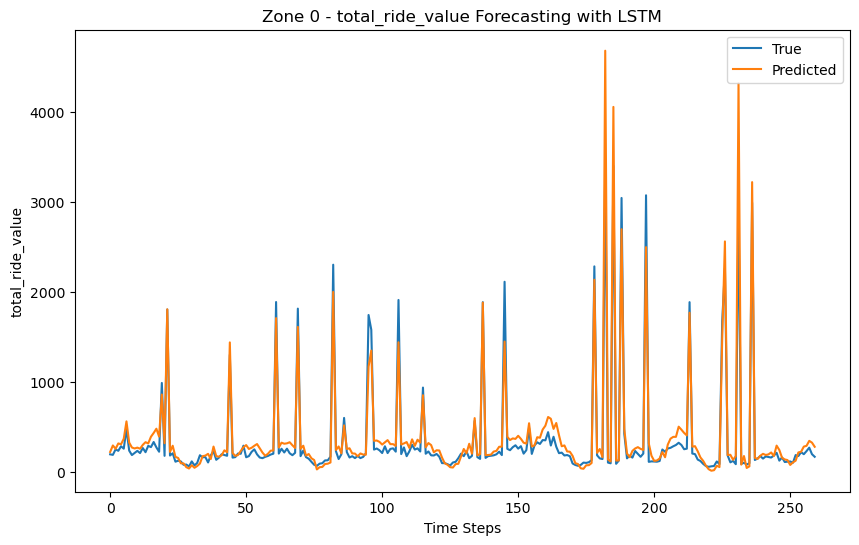

Processing zone 1...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 548us/step - loss: 0.0040    
Epoch 2/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 522us/step - loss: 0.0025  
Epoch 3/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 537us/step - loss: 0.0027  
Epoch 4/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 506us/step - loss: 0.0027  
Epoch 5/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 463us/step - loss: 0.0015  
Epoch 6/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 464us/step - loss: 0.0043
Epoch 7/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 498us/step - loss: 0.0037
Epoch 8/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 499us/step - loss: 0.0031  
Epoch 9/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 493us/step - loss: 8.8868e-04
Epoch 10/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 494us/step - loss: 0.0026  
Epoch 11/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 501us/step - loss: 0.0037
Epoch 12/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 504us/step - loss: 0.0012  
Epoch 13/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 493us/step - loss: 0.0027  
Epoch 14/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 493us/step - loss: 0.0021
Epoch 15/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 50

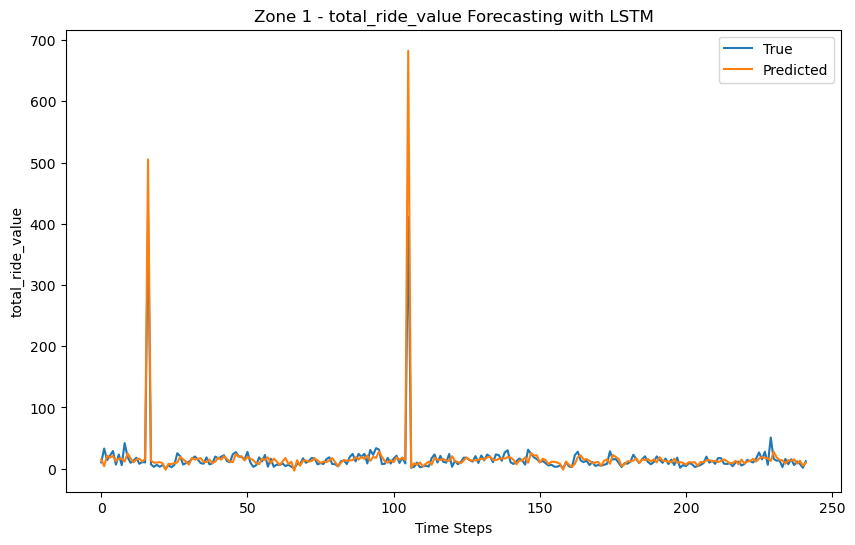

Processing zone 2...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 547us/step - loss: 0.0169
Epoch 2/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 509us/step - loss: 0.0113
Epoch 3/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 480us/step - loss: 0.0113
Epoch 4/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 471us/step - loss: 0.0102
Epoch 5/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 446us/step - loss: 0.0112
Epoch 6/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 495us/step - loss: 0.0083
Epoch 7/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 500us/step - loss: 0.0072
Epoch 8/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 502us/step - loss: 0.0050
Epoch 9/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 501us/step - loss: 0.0055
Epoch 10/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 495us/step - loss: 0.0033
Epoch 11/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 505us/step - loss: 0.0034
Epoch 12/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 501us/step - loss: 0.0028
Epoch 13/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 491us/step - loss: 0.0027
Epoch 14/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 502us/step - loss: 0.0021
Epoch 15/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 499us/step - loss: 0.0020


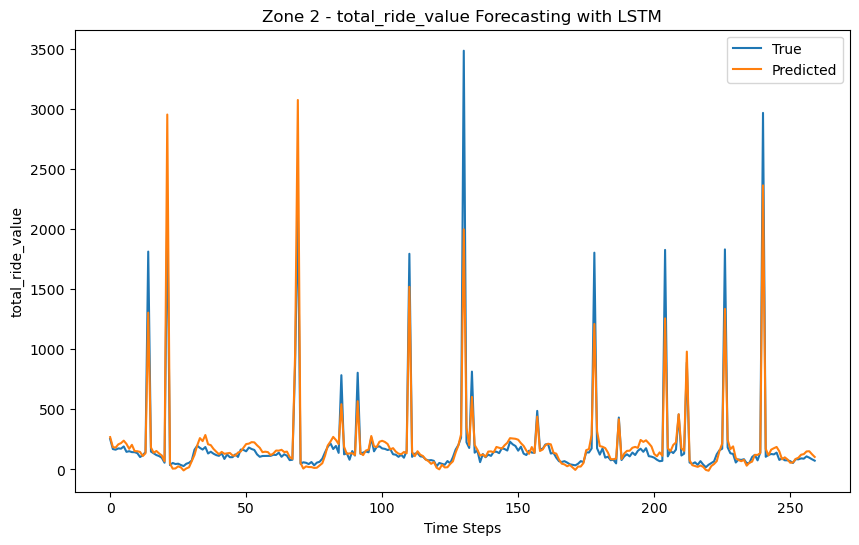

Processing zone 3...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 550us/step - loss: 0.0088
Epoch 2/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 473us/step - loss: 0.0142
Epoch 3/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 507us/step - loss: 0.0124  
Epoch 4/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 487us/step - loss: 0.0109  
Epoch 5/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 613us/step - loss: 0.0071  
Epoch 6/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 562us/step - loss: 0.0124
Epoch 7/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 561us/step - loss: 0.0121
Epoch 8/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 543us/step - loss: 0.0098  
Epoch 9/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 546us/step - loss: 0.0111
Epoch 10/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 534us/step - loss: 0.0134
Epoch 11/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 542us/step - loss: 0.0083  
Epoch 12/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 532us/step - loss: 0.0070
Epoch 13/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 556us/step - loss: 0.0102
Epoch 14/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 536us/step - loss: 0.0075
Epoch 15/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 527us/step - los

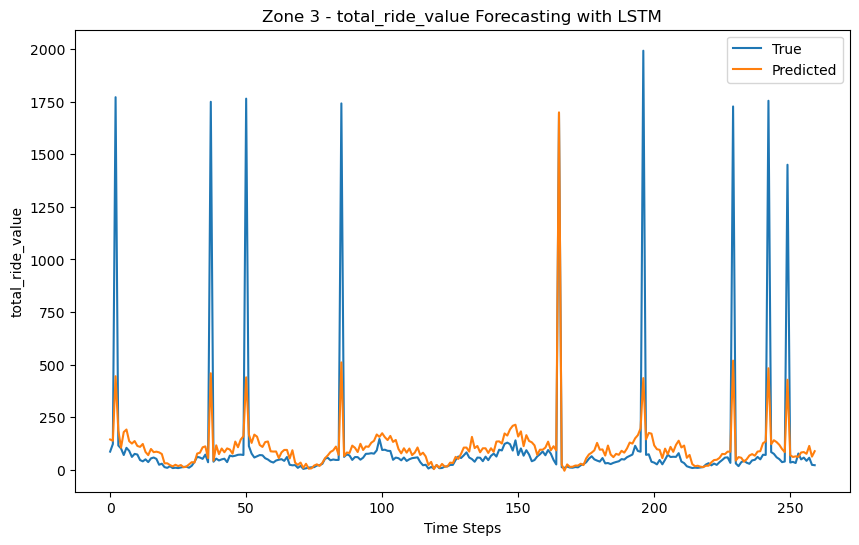

Processing zone 4...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.1248  
Epoch 2/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.1137
Epoch 3/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.1016
Epoch 4/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0902
Epoch 5/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0862
Epoch 6/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 899us/step - loss: 0.0767
Epoch 7/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0711
Epoch 8/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0588
Epoch 9/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0526
Epoch 10/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0446
Epoch 11/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0394
Epoch 12/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0371
Epoch 13/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0334
Epoch 14/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0284
Epoch 15/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0264
Epoch 16/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss:

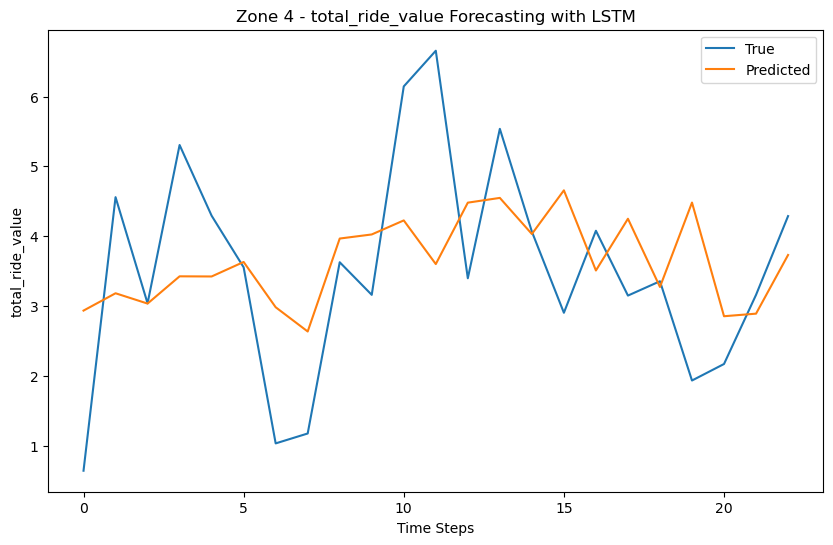

Processing zone 5...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 598us/step - loss: 0.0047    
Epoch 2/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 588us/step - loss: 0.0057  
Epoch 3/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 479us/step - loss: 0.0050  
Epoch 4/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 561us/step - loss: 0.0067
Epoch 5/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 400us/step - loss: 0.0086
Epoch 6/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 481us/step - loss: 0.0061  
Epoch 7/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 541us/step - loss: 0.0032  
Epoch 8/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 496us/step - loss: 0.0041  
Epoch 9/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 490us/step - loss: 0.0057
Epoch 10/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 490us/step - loss: 0.0045
Epoch 11/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 508us/step - loss: 0.0024  
Epoch 12/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 489us/step - loss: 0.0014  
Epoch 13/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 477us/step - loss: 0.0016  
Epoch 14/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 474us/step - loss: 0.0020  
Epoch 15/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 497u

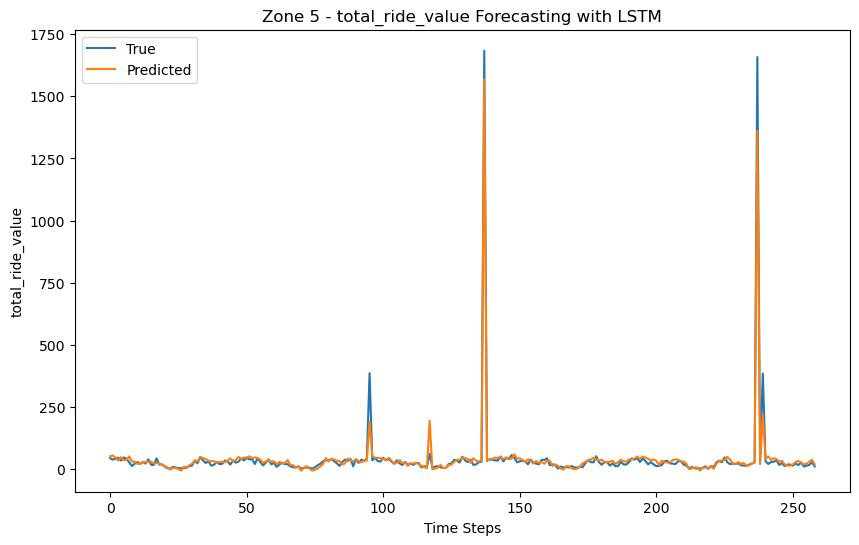

Processing zone 6...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 515us/step - loss: 0.0029
Epoch 2/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 547us/step - loss: 0.0019  
Epoch 3/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 433us/step - loss: 0.0041
Epoch 4/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 435us/step - loss: 0.0020  
Epoch 5/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 496us/step - loss: 0.0023  
Epoch 6/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 456us/step - loss: 0.0044
Epoch 7/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 500us/step - loss: 0.0020  
Epoch 8/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 502us/step - loss: 0.0012  
Epoch 9/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 492us/step - loss: 0.0016  
Epoch 10/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 493us/step - loss: 0.0011  
Epoch 11/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 488us/step - loss: 0.0018  
Epoch 12/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 492us/step - loss: 4.6623e-04
Epoch 13/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 502us/step - loss: 0.0011  
Epoch 14/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 518us/step - loss: 0.0014
Epoch 15/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 486u

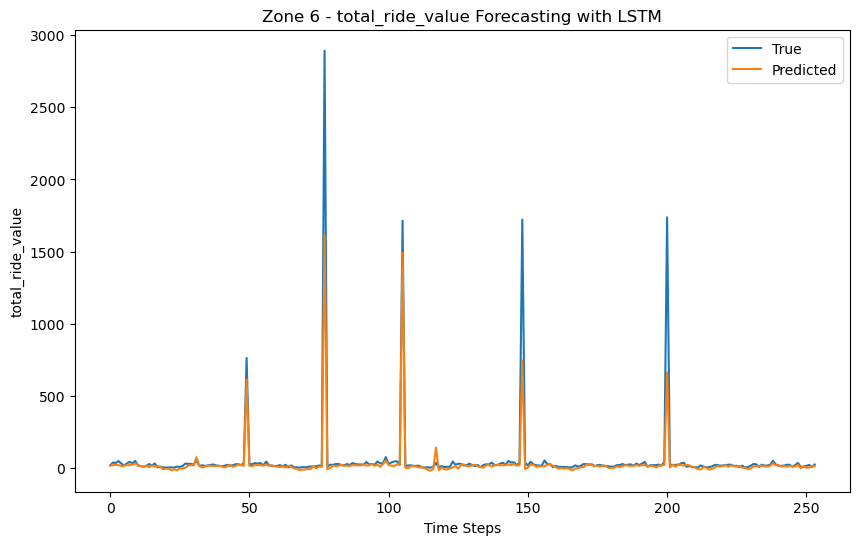

Processing zone 7...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 594us/step - loss: 0.0311
Epoch 2/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 497us/step - loss: 0.0178
Epoch 3/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 437us/step - loss: 0.0134
Epoch 4/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 496us/step - loss: 0.0129
Epoch 5/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 492us/step - loss: 0.0123
Epoch 6/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 533us/step - loss: 0.0126
Epoch 7/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 496us/step - loss: 0.0122
Epoch 8/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 505us/step - loss: 0.0139
Epoch 9/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 498us/step - loss: 0.0130
Epoch 10/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 501us/step - loss: 0.0129
Epoch 11/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 489us/step - loss: 0.0122
Epoch 12/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 507us/step - loss: 0.0112
Epoch 13/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 499us/step - loss: 0.0111
Epoch 14/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 498us/step - loss: 0.0110
Epoch 15/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 491us/step - loss: 0.0124


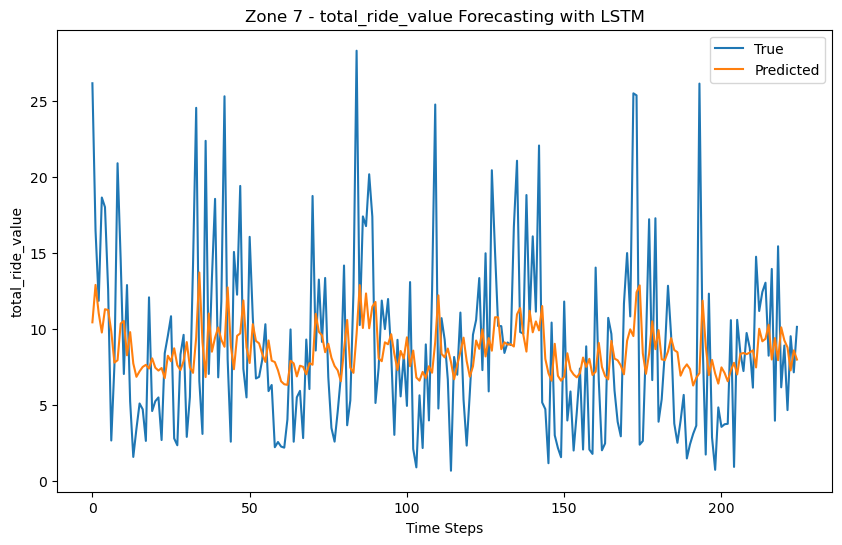

Processing zone 8...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 693us/step - loss: 0.0063
Epoch 2/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 616us/step - loss: 0.0049  
Epoch 3/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 602us/step - loss: 0.0046
Epoch 4/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 486us/step - loss: 0.0058
Epoch 5/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 503us/step - loss: 0.0041
Epoch 6/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 520us/step - loss: 0.0028  
Epoch 7/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 485us/step - loss: 0.0045
Epoch 8/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 507us/step - loss: 0.0034
Epoch 9/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 501us/step - loss: 0.0024  
Epoch 10/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 490us/step - loss: 0.0037
Epoch 11/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 513us/step - loss: 0.0017  
Epoch 12/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 503us/step - loss: 0.0020
Epoch 13/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 490us/step - loss: 0.0018  
Epoch 14/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 529us/step - loss: 0.0015  
Epoch 15/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 492us/step - l

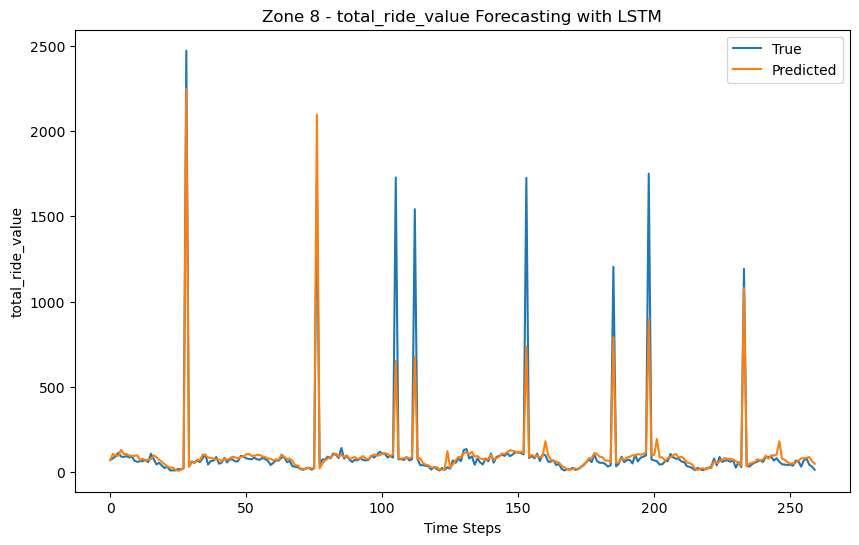

Processing zone 9...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 747us/step - loss: 0.0609
Epoch 2/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 710us/step - loss: 0.0334
Epoch 3/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 516us/step - loss: 0.0296
Epoch 4/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 634us/step - loss: 0.0243
Epoch 5/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 490us/step - loss: 0.0231
Epoch 6/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 589us/step - loss: 0.0235
Epoch 7/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 504us/step - loss: 0.0217
Epoch 8/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 525us/step - loss: 0.0205
Epoch 9/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 544us/step - loss: 0.0234
Epoch 10/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 473us/step - loss: 0.0200
Epoch 11/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 542us/step - loss: 0.0242
Epoch 12/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 526us/step - loss: 0.0218
Epoch 13/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 503us/step - loss: 0.0214
Epoch 14/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 516us/step - loss: 0.0222
Epoch 15/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 508us/step - loss: 0.0204


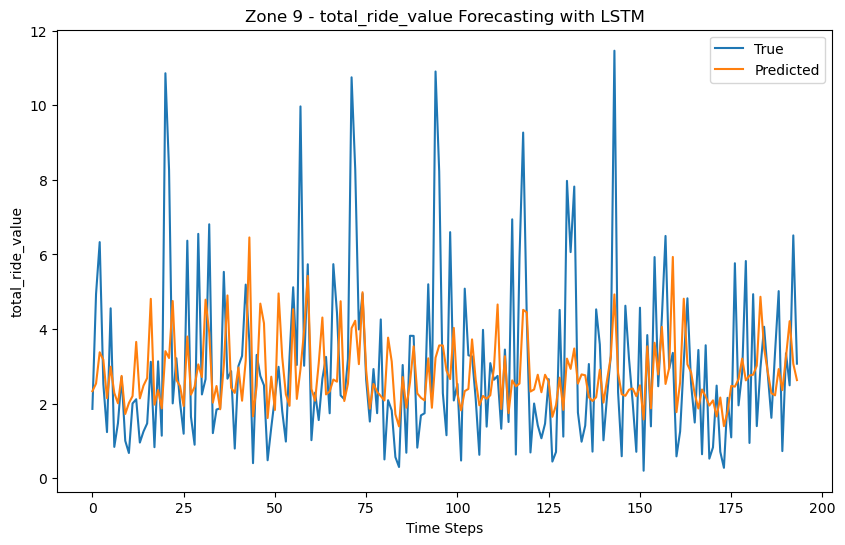

Processing zone 10...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 698us/step - loss: 0.0048    
Epoch 2/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 596us/step - loss: 0.0012  
Epoch 3/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 512us/step - loss: 0.0016  
Epoch 4/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 509us/step - loss: 0.0019  
Epoch 5/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 435us/step - loss: 0.0048
Epoch 6/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 579us/step - loss: 0.0020  
Epoch 7/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 542us/step - loss: 0.0037
Epoch 8/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 499us/step - loss: 9.1997e-04
Epoch 9/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 538us/step - loss: 0.0016  
Epoch 10/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 562us/step - loss: 0.0019   
Epoch 11/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 522us/step - loss: 4.2839e-04
Epoch 12/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 512us/step - loss: 0.0012  
Epoch 13/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 526us/step - loss: 0.0010  
Epoch 14/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 511us/step - loss: 0.0021  
Epoch 15/20
16/16 ━━━━━━━━━━━━━━━━━━━

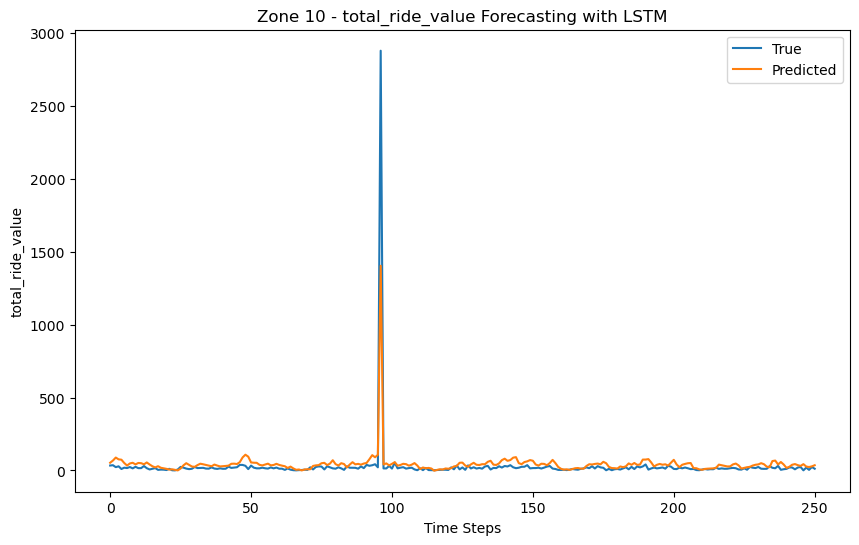

Processing zone 11...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 635us/step - loss: 0.0181
Epoch 2/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 565us/step - loss: 0.0098
Epoch 3/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 566us/step - loss: 0.0070
Epoch 4/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 576us/step - loss: 0.0076
Epoch 5/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 560us/step - loss: 0.0079
Epoch 6/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 525us/step - loss: 0.0079
Epoch 7/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 564us/step - loss: 0.0057
Epoch 8/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 495us/step - loss: 0.0074
Epoch 9/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 653us/step - loss: 0.0074
Epoch 10/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 572us/step - loss: 0.0053
Epoch 11/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 546us/step - loss: 0.0065
Epoch 12/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 599us/step - loss: 0.0060
Epoch 13/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 539us/step - loss: 0.0052
Epoch 14/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 567us/step - loss: 0.0058
Epoch 15/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 544us/step - loss: 0.0060
Epoch 16/20
8/8 ━━━━━━━━━━━━━━

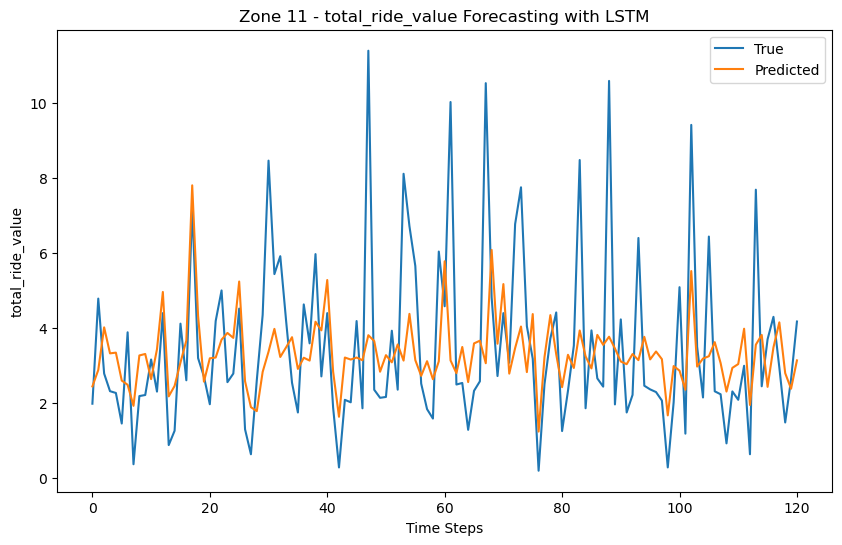

Processing zone 12...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 614us/step - loss: 0.0014    
Epoch 2/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 549us/step - loss: 0.0010  
Epoch 3/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 463us/step - loss: 0.0026  
Epoch 4/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 468us/step - loss: 7.5905e-04
Epoch 5/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 492us/step - loss: 8.2174e-04
Epoch 6/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 515us/step - loss: 0.0011  
Epoch 7/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 496us/step - loss: 7.3020e-04
Epoch 8/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 484us/step - loss: 0.0021
Epoch 9/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 506us/step - loss: 2.9682e-04
Epoch 10/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 507us/step - loss: 3.6410e-04
Epoch 11/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 502us/step - loss: 3.2252e-04
Epoch 12/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 506us/step - loss: 0.0014
Epoch 13/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 485us/step - loss: 3.0763e-04
Epoch 14/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 492us/step - loss: 1.1482e-04
Epoch 15/20
17/17 ━━━━━━━━

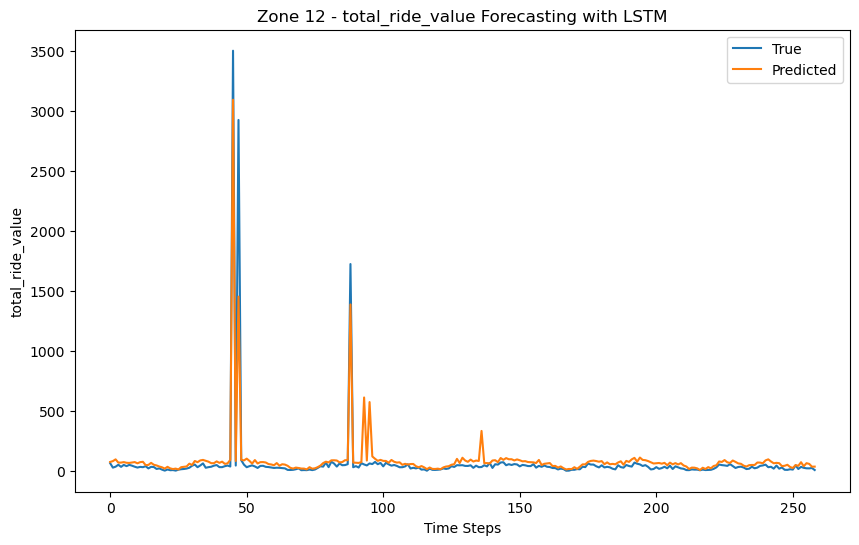

Processing zone 13...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


17/17 ━━━━━━━━━━━━━━━━━━━━ 1s 604us/step - loss: 0.0012     
Epoch 2/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 504us/step - loss: 9.6198e-04
Epoch 3/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 455us/step - loss: 8.1188e-04
Epoch 4/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 457us/step - loss: 7.9074e-04
Epoch 5/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 511us/step - loss: 0.0014  
Epoch 6/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 508us/step - loss: 0.0015  
Epoch 7/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 493us/step - loss: 0.0011  
Epoch 8/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 486us/step - loss: 0.0014  
Epoch 9/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 514us/step - loss: 0.0023  
Epoch 10/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 495us/step - loss: 7.7310e-04
Epoch 11/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 507us/step - loss: 0.0012  
Epoch 12/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 506us/step - loss: 2.8812e-04
Epoch 13/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 501us/step - loss: 0.0015  
Epoch 14/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 515us/step - loss: 0.0011  
Epoch 15/20
17/17 ━━━━━━━━━

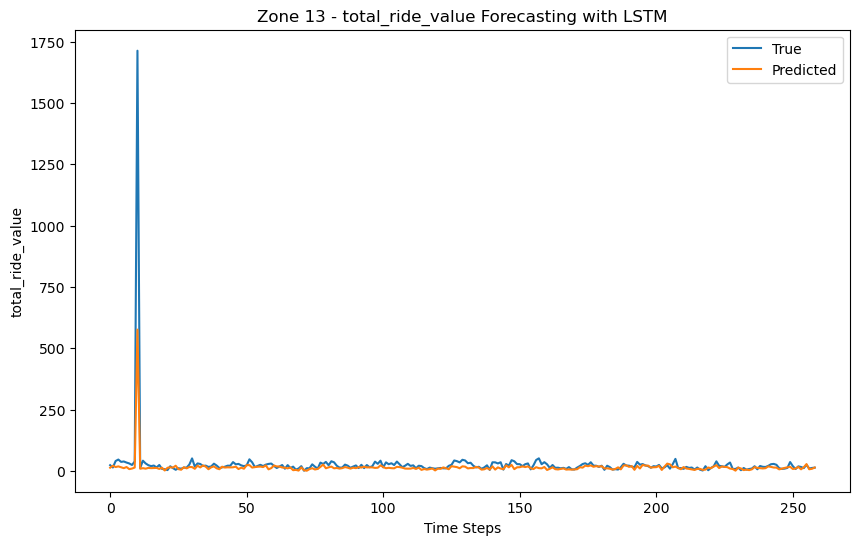

Processing zone 14...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 621us/step - loss: 0.0018    
Epoch 2/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 545us/step - loss: 8.9945e-04
Epoch 3/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 466us/step - loss: 0.0011  
Epoch 4/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 500us/step - loss: 9.9058e-04
Epoch 5/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 467us/step - loss: 7.9024e-04
Epoch 6/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 532us/step - loss: 4.5799e-04
Epoch 7/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 508us/step - loss: 6.5417e-04
Epoch 8/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 502us/step - loss: 6.0031e-04
Epoch 9/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 502us/step - loss: 0.0019  
Epoch 10/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 497us/step - loss: 9.3519e-04
Epoch 11/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 507us/step - loss: 8.6937e-04
Epoch 12/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 513us/step - loss: 6.0295e-04
Epoch 13/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 496us/step - loss: 0.0012  
Epoch 14/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 506us/step - loss: 9.3296e-04
Epoch 15/20
16/16 

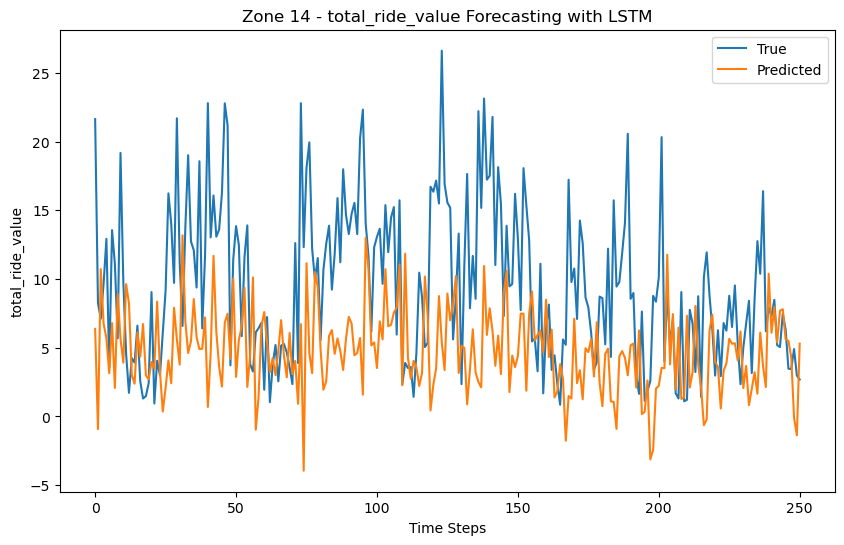

Processing zone 15...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 553us/step - loss: 0.0423
Epoch 2/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 510us/step - loss: 0.0268
Epoch 3/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 530us/step - loss: 0.0162
Epoch 4/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 509us/step - loss: 0.0148
Epoch 5/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 499us/step - loss: 0.0151
Epoch 6/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 488us/step - loss: 0.0140
Epoch 7/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 490us/step - loss: 0.0166
Epoch 8/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 0.0135
Epoch 9/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 507us/step - loss: 0.0151
Epoch 10/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 534us/step - loss: 0.0147
Epoch 11/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 579us/step - loss: 0.0134
Epoch 12/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 526us/step - loss: 0.0136
Epoch 13/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 535us/step - loss: 0.0125
Epoch 14/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 533us/step - loss: 0.0135
Epoch 15/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 514us/step - loss: 0.0147
Ep

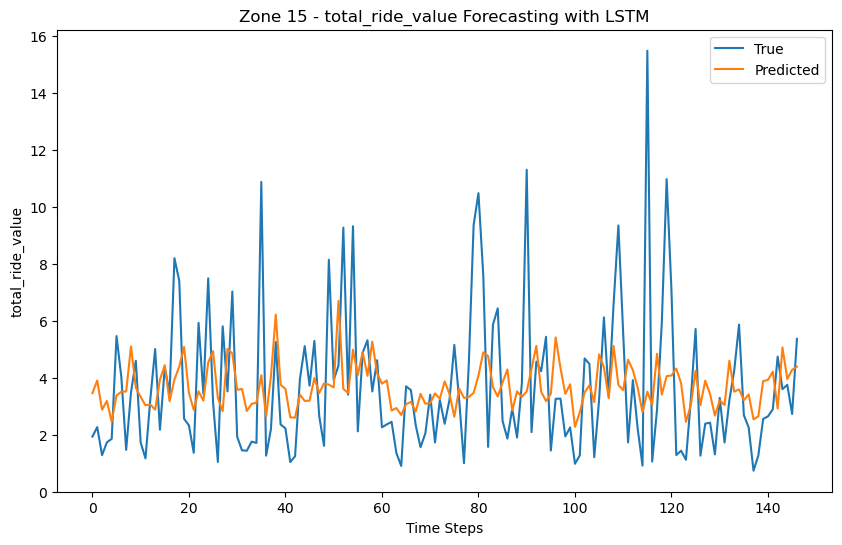

Processing zone 16...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0724  
Epoch 2/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 736us/step - loss: 0.0560
Epoch 3/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 803us/step - loss: 0.0453
Epoch 4/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 677us/step - loss: 0.0397
Epoch 5/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 651us/step - loss: 0.0355
Epoch 6/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 662us/step - loss: 0.0323
Epoch 7/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 711us/step - loss: 0.0221
Epoch 8/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 610us/step - loss: 0.0212
Epoch 9/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 677us/step - loss: 0.0172
Epoch 10/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 669us/step - loss: 0.0200
Epoch 11/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 745us/step - loss: 0.0190
Epoch 12/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 611us/step - loss: 0.0172
Epoch 13/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 667us/step - loss: 0.0182
Epoch 14/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 795us/step - loss: 0.0185
Epoch 15/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 683us/step - loss: 0.0181
Epoch 16/20
4/4 ━━━━━━━━━━━━━━

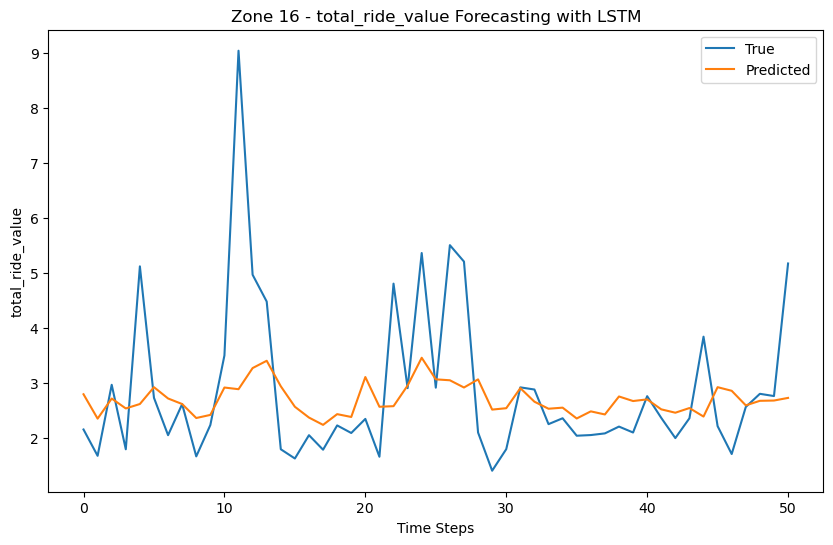

Processing zone 17...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 622us/step - loss: 0.0076
Epoch 2/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 518us/step - loss: 0.0061
Epoch 3/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 457us/step - loss: 0.0038  
Epoch 4/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 455us/step - loss: 0.0051  
Epoch 5/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 467us/step - loss: 0.0037  
Epoch 6/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 487us/step - loss: 0.0045  
Epoch 7/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 512us/step - loss: 0.0044
Epoch 8/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 494us/step - loss: 0.0048
Epoch 9/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 499us/step - loss: 0.0030
Epoch 10/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 483us/step - loss: 0.0035
Epoch 11/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 492us/step - loss: 0.0042
Epoch 12/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 485us/step - loss: 0.0031
Epoch 13/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 486us/step - loss: 0.0016  
Epoch 14/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 499us/step - loss: 0.0021  
Epoch 15/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 483us/step - l

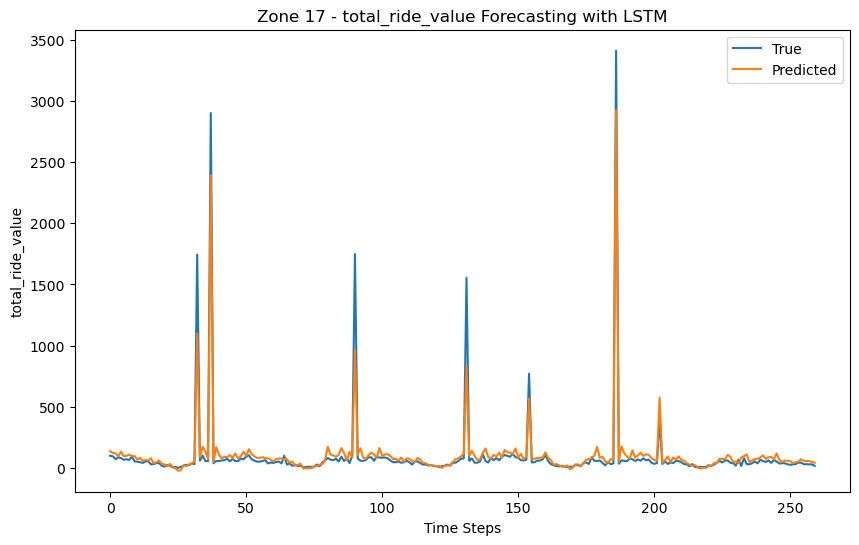

Processing zone 18...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 538us/step - loss: 0.0015    
Epoch 2/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 502us/step - loss: 0.0032  
Epoch 3/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 474us/step - loss: 0.0040  
Epoch 4/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 434us/step - loss: 0.0014  
Epoch 5/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 439us/step - loss: 0.0028  
Epoch 6/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 480us/step - loss: 0.0011  
Epoch 7/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 510us/step - loss: 0.0011  
Epoch 8/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 485us/step - loss: 0.0019  
Epoch 9/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 504us/step - loss: 0.0021  
Epoch 10/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 493us/step - loss: 8.7993e-04
Epoch 11/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 492us/step - loss: 0.0011  
Epoch 12/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 486us/step - loss: 0.0028
Epoch 13/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 484us/step - loss: 0.0023  
Epoch 14/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 495us/step - loss: 0.0012  
Epoch 15/20
17/17 ━━━━━━━━━━━━━━━━━━━━

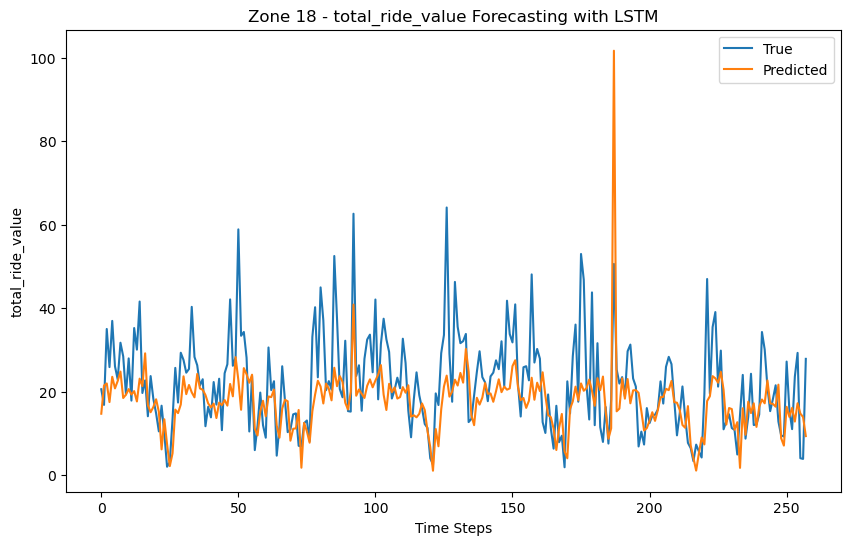

Processing zone 19...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 605us/step - loss: 0.0587
Epoch 2/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 544us/step - loss: 0.0368
Epoch 3/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 474us/step - loss: 0.0236
Epoch 4/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 430us/step - loss: 0.0236
Epoch 5/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 488us/step - loss: 0.0257
Epoch 6/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 441us/step - loss: 0.0223
Epoch 7/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 411us/step - loss: 0.0227
Epoch 8/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 483us/step - loss: 0.0242
Epoch 9/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 494us/step - loss: 0.0205
Epoch 10/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 504us/step - loss: 0.0213
Epoch 11/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 500us/step - loss: 0.0225
Epoch 12/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 484us/step - loss: 0.0219
Epoch 13/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 487us/step - loss: 0.0201
Epoch 14/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 486us/step - loss: 0.0199
Epoch 15/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 494us/step - loss: 0.0222


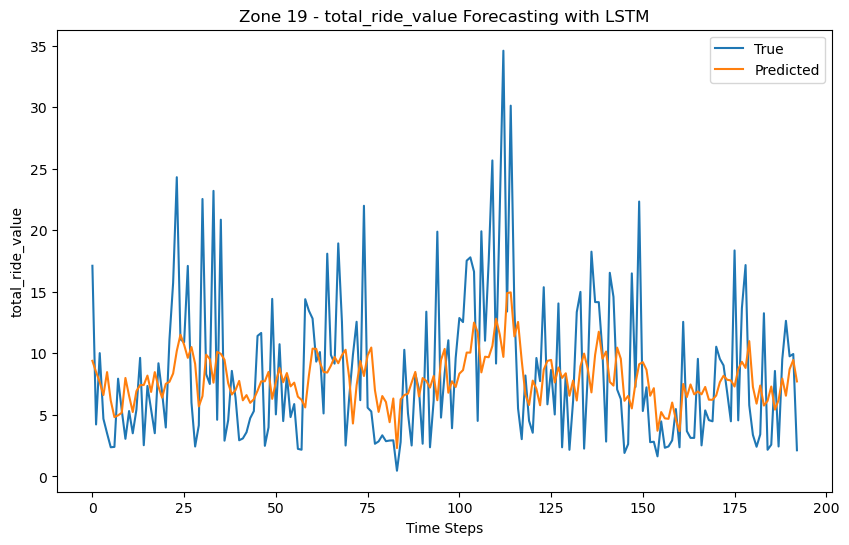

Processing zone 21...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 626us/step - loss: 0.0719
Epoch 2/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 569us/step - loss: 0.0544
Epoch 3/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 612us/step - loss: 0.0309
Epoch 4/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 550us/step - loss: 0.0211
Epoch 5/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 512us/step - loss: 0.0180
Epoch 6/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 510us/step - loss: 0.0150
Epoch 7/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 527us/step - loss: 0.0166
Epoch 8/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 551us/step - loss: 0.0146
Epoch 9/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 771us/step - loss: 0.0137
Epoch 10/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 581us/step - loss: 0.0144
Epoch 11/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 597us/step - loss: 0.0142
Epoch 12/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 563us/step - loss: 0.0145
Epoch 13/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 610us/step - loss: 0.0141
Epoch 14/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 624us/step - loss: 0.0142
Epoch 15/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 598us/step - loss: 0.0134
Epoch 16/20
7/7 ━━━━━━━━━━━━━━

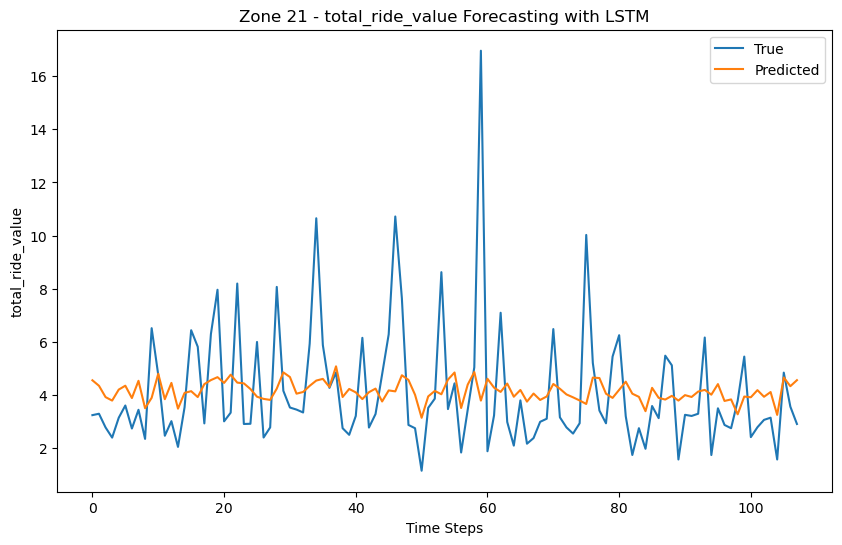

Processing zone 22...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 750us/step - loss: 0.0939
Epoch 2/20
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 626us/step - loss: 0.0737
Epoch 3/20
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 621us/step - loss: 0.0574
Epoch 4/20
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 583us/step - loss: 0.0527
Epoch 5/20
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 574us/step - loss: 0.0305
Epoch 6/20
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 618us/step - loss: 0.0329
Epoch 7/20
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 551us/step - loss: 0.0287
Epoch 8/20
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 582us/step - loss: 0.0241
Epoch 9/20
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 574us/step - loss: 0.0256
Epoch 10/20
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 666us/step - loss: 0.0237
Epoch 11/20
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 568us/step - loss: 0.0305
Epoch 12/20
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 651us/step - loss: 0.0283
Epoch 13/20
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 557us/step - loss: 0.0276
Epoch 14/20
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 571us/step - loss: 0.0242
Epoch 15/20
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 795us/step - loss: 0.0257
Epoch 16/20
5/5 ━━━━━━━━━━━━━━

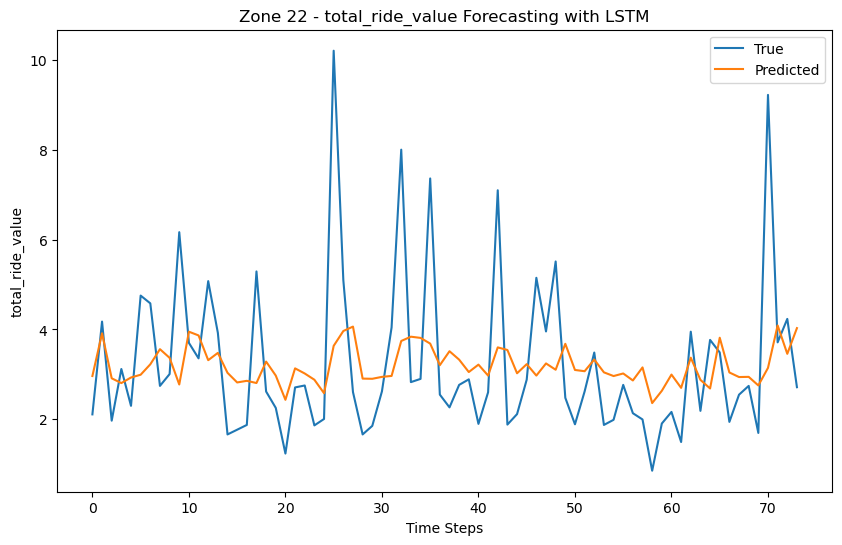

Processing zone 23...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 0.0470  
Epoch 2/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0382
Epoch 3/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0377
Epoch 4/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0364
Epoch 5/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 940us/step - loss: 0.0322
Epoch 6/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 887us/step - loss: 0.0254
Epoch 7/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 998us/step - loss: 0.0280
Epoch 8/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0266
Epoch 9/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0214
Epoch 10/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 960us/step - loss: 0.0211
Epoch 11/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0210
Epoch 12/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 970us/step - loss: 0.0231
Epoch 13/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0218
Epoch 14/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0205
Epoch 15/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0209
Epoch 16/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step

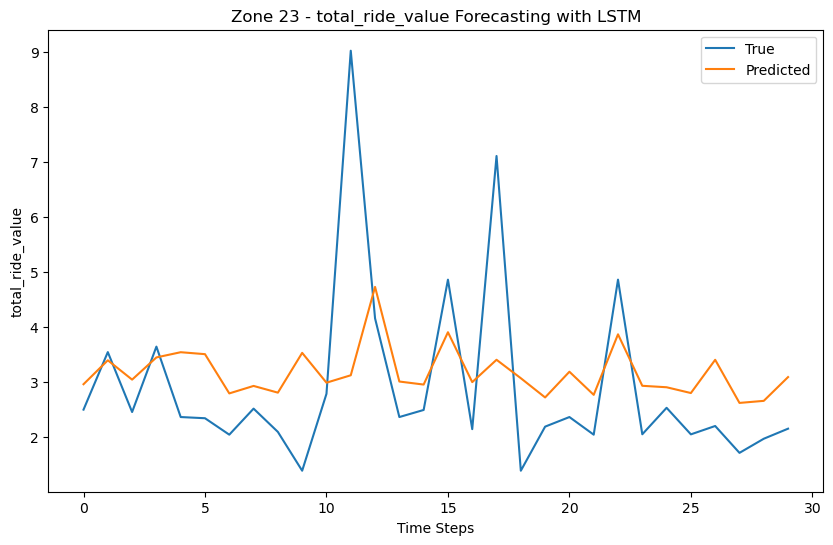

Processing zone 24...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 567us/step - loss: 0.0032    
Epoch 2/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 518us/step - loss: 0.0016  
Epoch 3/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 541us/step - loss: 0.0053  
Epoch 4/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 438us/step - loss: 0.0039  
Epoch 5/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 513us/step - loss: 0.0047  
Epoch 6/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 456us/step - loss: 0.0027  
Epoch 7/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 493us/step - loss: 0.0032  
Epoch 8/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 487us/step - loss: 0.0032  
Epoch 9/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 495us/step - loss: 0.0022  
Epoch 10/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 491us/step - loss: 0.0040
Epoch 11/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 487us/step - loss: 0.0048
Epoch 12/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 488us/step - loss: 0.0024  
Epoch 13/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 486us/step - loss: 0.0039  
Epoch 14/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 499us/step - loss: 0.0041
Epoch 15/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 48

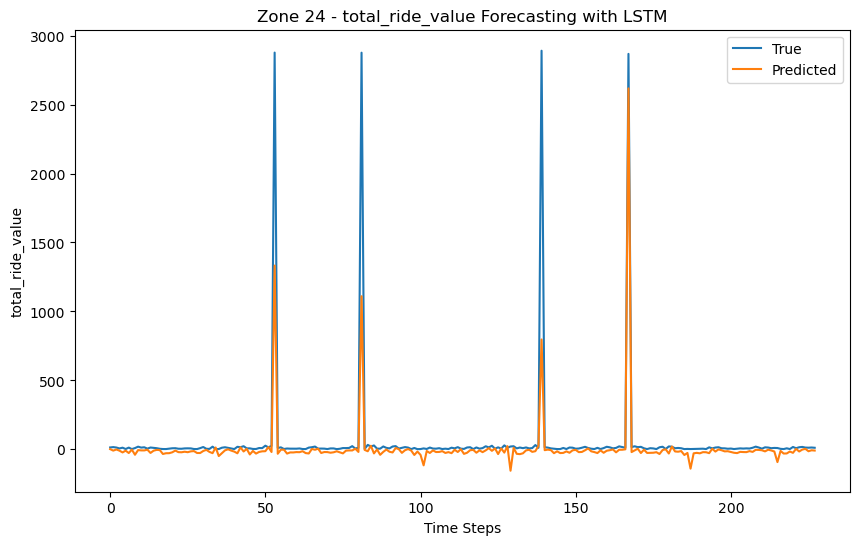

Processing zone 25...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 393ms/step - loss: 0.0831
Epoch 2/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0795
Epoch 3/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0760
Epoch 4/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0726
Epoch 5/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0694
Epoch 6/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0663
Epoch 7/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0634
Epoch 8/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0606
Epoch 9/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0580
Epoch 10/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0556
Epoch 11/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0532
Epoch 12/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0511
Epoch 13/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0491
Epoch 14/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0472
Epoch 15/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0455
Epoch 16/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0

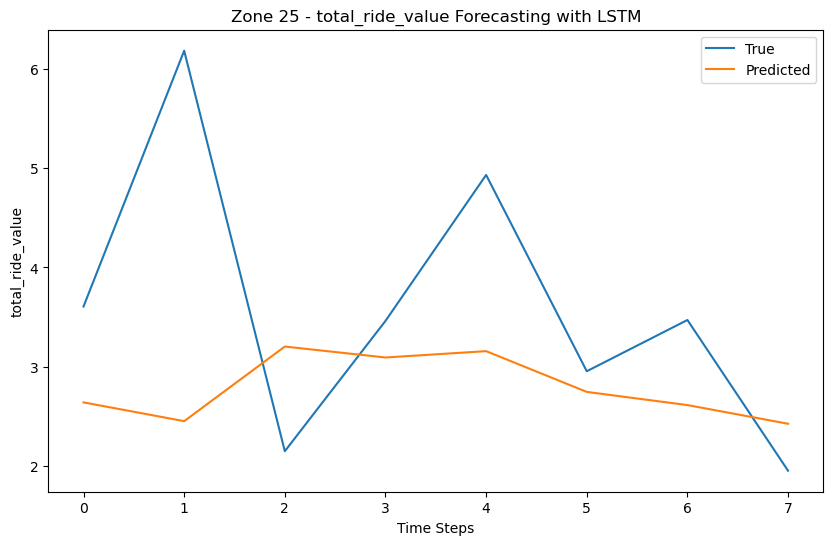

Processing zone 26...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 929us/step - loss: 0.0987
Epoch 2/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 928us/step - loss: 0.0852
Epoch 3/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 663us/step - loss: 0.0669
Epoch 4/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 608us/step - loss: 0.0502
Epoch 5/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 626us/step - loss: 0.0423
Epoch 6/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 781us/step - loss: 0.0369
Epoch 7/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 654us/step - loss: 0.0263
Epoch 8/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 764us/step - loss: 0.0298
Epoch 9/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 671us/step - loss: 0.0267
Epoch 10/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 729us/step - loss: 0.0220
Epoch 11/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 629us/step - loss: 0.0263
Epoch 12/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 612us/step - loss: 0.0249
Epoch 13/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 643us/step - loss: 0.0244
Epoch 14/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 618us/step - loss: 0.0256
Epoch 15/20
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 727us/step - loss: 0.0244
Epoch 16/20
4/4 ━━━━━━━━━━━━━━

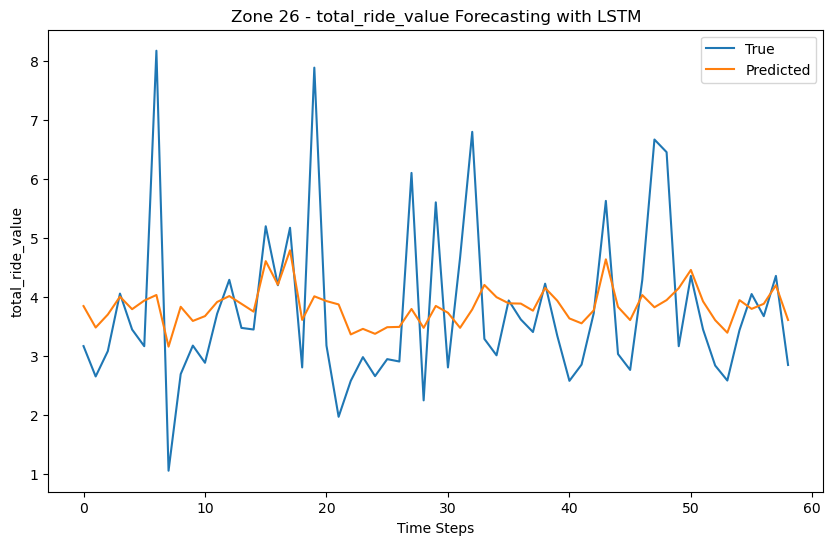

Processing zone 27...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 642us/step - loss: 0.0497
Epoch 2/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 571us/step - loss: 0.0405
Epoch 3/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 537us/step - loss: 0.0221
Epoch 4/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 574us/step - loss: 0.0197
Epoch 5/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 542us/step - loss: 0.0168
Epoch 6/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 544us/step - loss: 0.0171
Epoch 7/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 527us/step - loss: 0.0200
Epoch 8/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 533us/step - loss: 0.0175
Epoch 9/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 506us/step - loss: 0.0149
Epoch 10/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 520us/step - loss: 0.0173
Epoch 11/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 523us/step - loss: 0.0202
Epoch 12/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 563us/step - loss: 0.0178
Epoch 13/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 655us/step - loss: 0.0165
Epoch 14/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 574us/step - loss: 0.0166
Epoch 15/20
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 663us/step - loss: 0.0196
Epoch 16/20
8/8 ━━━━━━━━━━━━━━

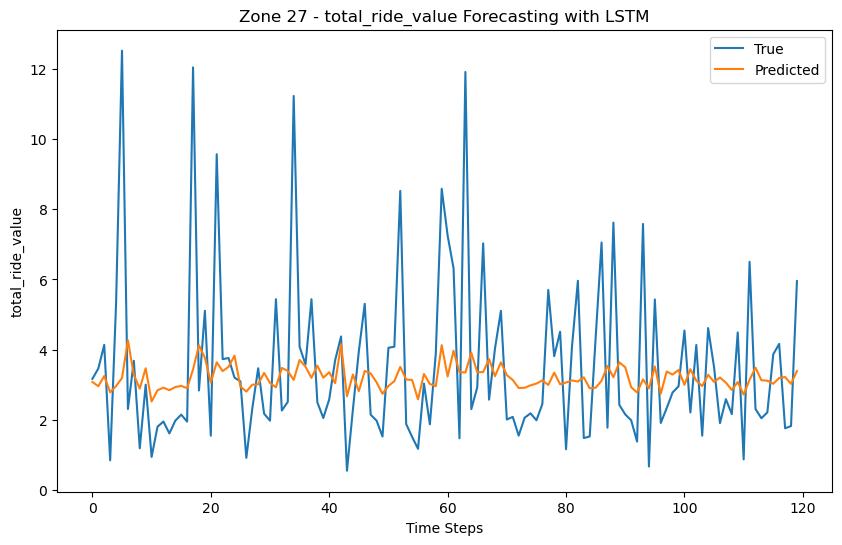

Processing zone 28...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.1246  
Epoch 2/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 749us/step - loss: 0.1054
Epoch 3/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 756us/step - loss: 0.0878
Epoch 4/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 788us/step - loss: 0.0787
Epoch 5/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 703us/step - loss: 0.0728
Epoch 6/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 754us/step - loss: 0.0615
Epoch 7/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 901us/step - loss: 0.0573
Epoch 8/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 740us/step - loss: 0.0489
Epoch 9/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 760us/step - loss: 0.0404
Epoch 10/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 694us/step - loss: 0.0372
Epoch 11/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 746us/step - loss: 0.0373
Epoch 12/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 708us/step - loss: 0.0332
Epoch 13/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0324
Epoch 14/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 755us/step - loss: 0.0277
Epoch 15/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 744us/step - loss: 0.0280
Epoch 16/20
3/3 ━━━━━━━━━━━━━━━━

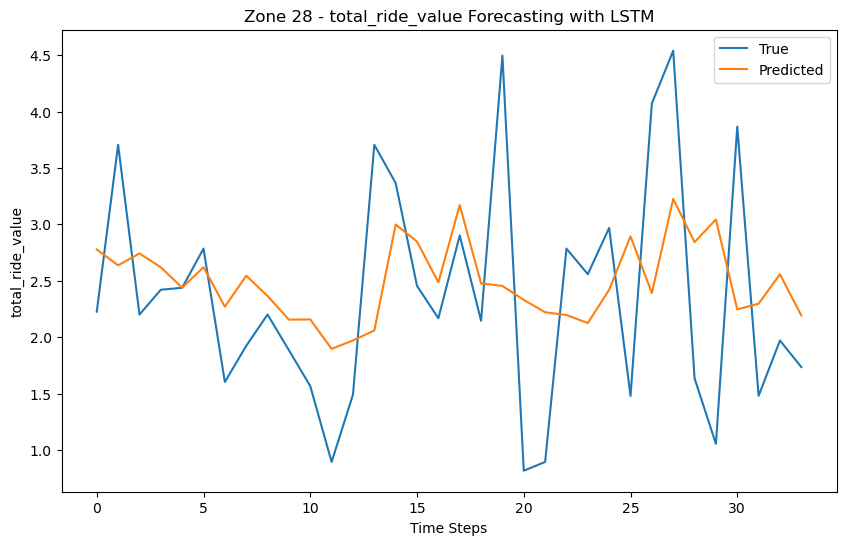

Processing zone 30...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 638us/step - loss: 0.0687
Epoch 2/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 550us/step - loss: 0.0477
Epoch 3/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 556us/step - loss: 0.0314
Epoch 4/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 542us/step - loss: 0.0253
Epoch 5/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 497us/step - loss: 0.0249
Epoch 6/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 502us/step - loss: 0.0215
Epoch 7/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 510us/step - loss: 0.0210
Epoch 8/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 553us/step - loss: 0.0205
Epoch 9/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 534us/step - loss: 0.0203
Epoch 10/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 538us/step - loss: 0.0181
Epoch 11/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 522us/step - loss: 0.0193
Epoch 12/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 0.0195
Epoch 13/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 528us/step - loss: 0.0186
Epoch 14/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 569us/step - loss: 0.0206
Epoch 15/20
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 574us/step - loss: 0.0190
Epoch 16/20
7/7 ━━━━━━━━━━━━━━━━

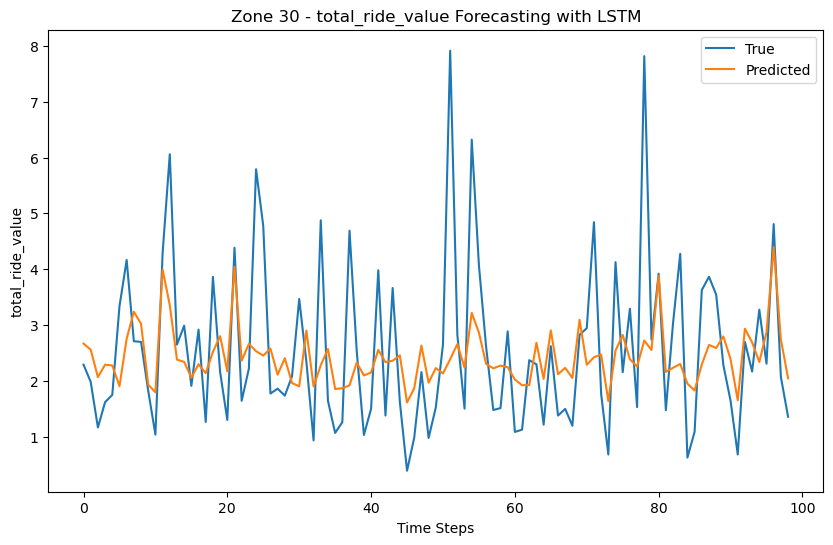

Processing zone 31...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 415ms/step - loss: 0.1558
Epoch 2/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.1478
Epoch 3/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.1400
Epoch 4/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.1324
Epoch 5/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.1251
Epoch 6/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.1181
Epoch 7/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.1113
Epoch 8/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.1047
Epoch 9/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0985
Epoch 10/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0924
Epoch 11/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0867
Epoch 12/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0811
Epoch 13/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0759
Epoch 14/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0709
Epoch 15/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0661
Epoch 16/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0

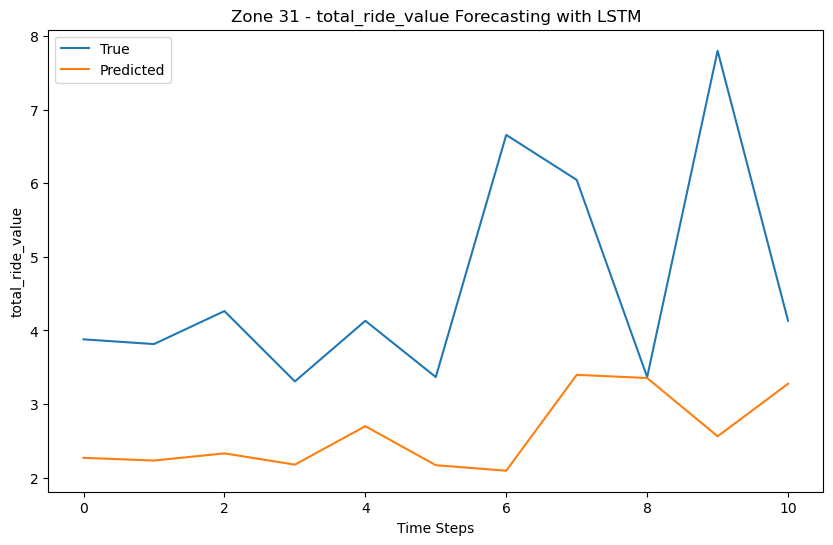

Processing zone 32...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 548us/step - loss: 4.7405e-04
Epoch 2/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 494us/step - loss: 4.5676e-04
Epoch 3/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 469us/step - loss: 0.0017  
Epoch 4/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 507us/step - loss: 5.9506e-04
Epoch 5/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 470us/step - loss: 3.9882e-04
Epoch 6/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 476us/step - loss: 0.0022  
Epoch 7/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 564us/step - loss: 0.0026  
Epoch 8/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 498us/step - loss: 6.2145e-04
Epoch 9/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 501us/step - loss: 0.0026
Epoch 10/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 505us/step - loss: 0.0018  
Epoch 11/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 502us/step - loss: 0.0026
Epoch 12/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 510us/step - loss: 0.0025
Epoch 13/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 502us/step - loss: 7.2207e-04
Epoch 14/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 504us/step - loss: 0.0012  
Epoch 15/20
14/14 ━━━━━━━━━━━━━━━━

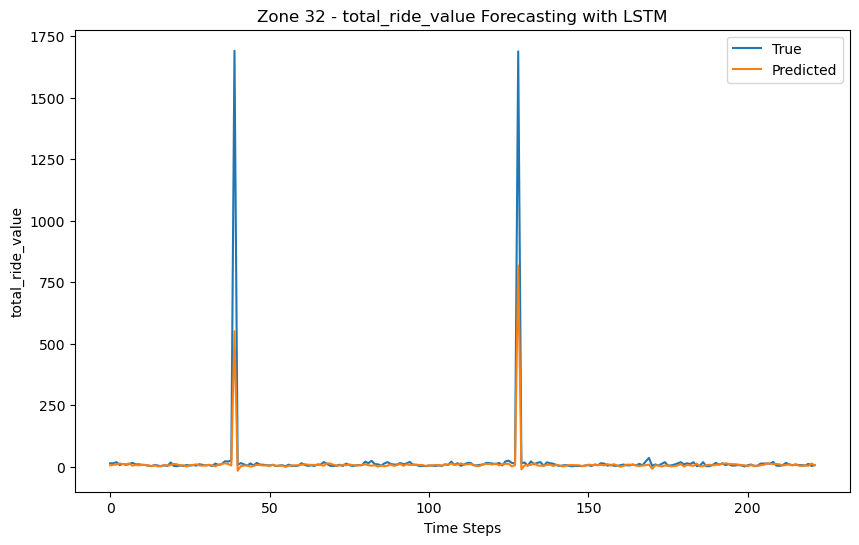

Processing zone 33...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 960us/step - loss: 0.0469
Epoch 2/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 824us/step - loss: 0.0409
Epoch 3/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 768us/step - loss: 0.0408
Epoch 4/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 749us/step - loss: 0.0312
Epoch 5/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 758us/step - loss: 0.0270
Epoch 6/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 800us/step - loss: 0.0259
Epoch 7/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 732us/step - loss: 0.0213
Epoch 8/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 719us/step - loss: 0.0235
Epoch 9/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 781us/step - loss: 0.0171
Epoch 10/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 749us/step - loss: 0.0181
Epoch 11/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 765us/step - loss: 0.0213
Epoch 12/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.0176
Epoch 13/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 759us/step - loss: 0.0196
Epoch 14/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 751us/step - loss: 0.0196
Epoch 15/20
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 698us/step - loss: 0.0202
Epoch 16/20
3/3 ━━━━━━━━━━━━━━━━

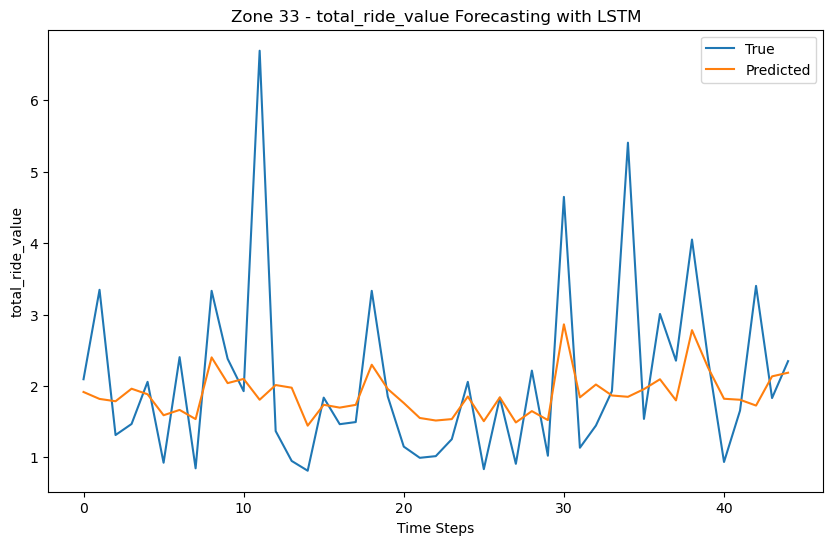

Processing zone 34...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 396ms/step - loss: 0.0612
Epoch 2/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0595
Epoch 3/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0579
Epoch 4/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0563
Epoch 5/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0548
Epoch 6/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0534
Epoch 7/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0520
Epoch 8/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0507
Epoch 9/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0495
Epoch 10/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0483
Epoch 11/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0472
Epoch 12/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0462
Epoch 13/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0452
Epoch 14/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0443
Epoch 15/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0434
Epoch 16/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0

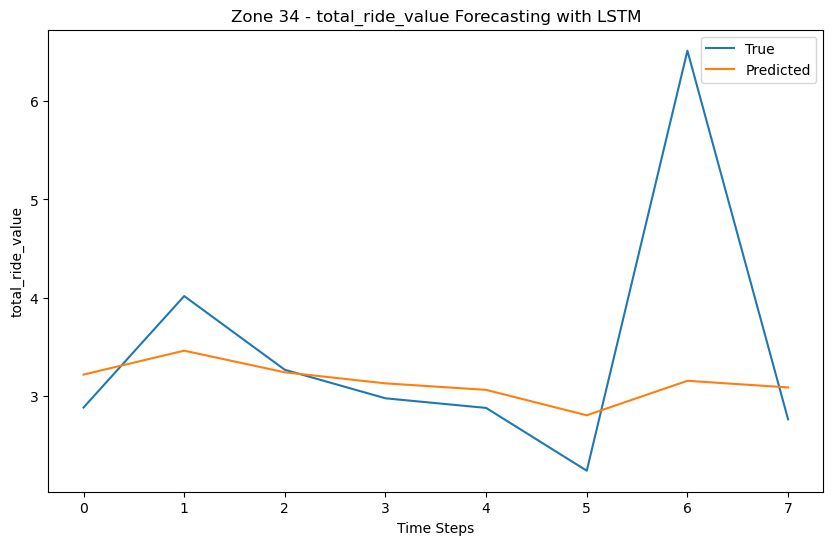

Processing zone 35...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 589us/step - loss: 0.0535
Epoch 2/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 579us/step - loss: 0.0270
Epoch 3/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 511us/step - loss: 0.0215
Epoch 4/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 527us/step - loss: 0.0240
Epoch 5/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 464us/step - loss: 0.0190
Epoch 6/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 471us/step - loss: 0.0203
Epoch 7/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 512us/step - loss: 0.0216
Epoch 8/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 578us/step - loss: 0.0201
Epoch 9/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 505us/step - loss: 0.0209
Epoch 10/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 534us/step - loss: 0.0215
Epoch 11/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 510us/step - loss: 0.0216
Epoch 12/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 512us/step - loss: 0.0222
Epoch 13/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 515us/step - loss: 0.0222
Epoch 14/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 537us/step - loss: 0.0213
Epoch 15/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 553us/step - loss: 0.0178


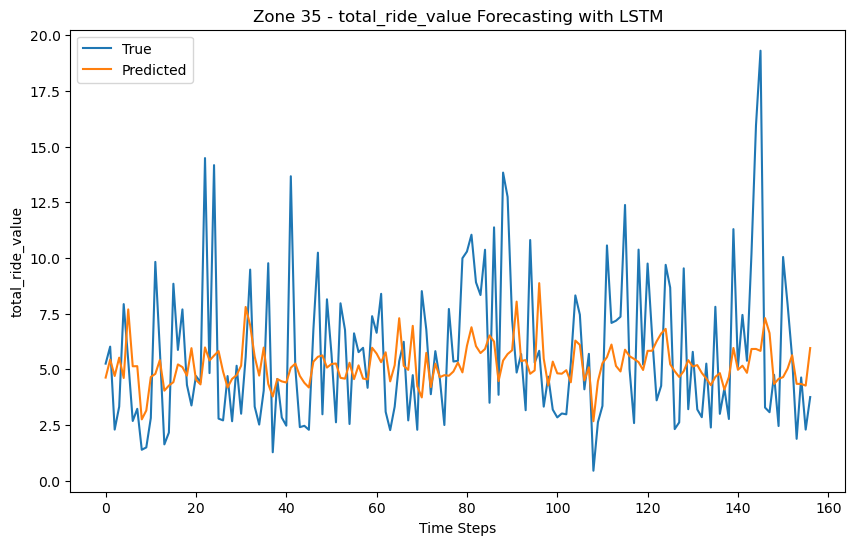

Processing zone 36...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 595us/step - loss: 0.0422
Epoch 2/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 624us/step - loss: 0.0300
Epoch 3/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 492us/step - loss: 0.0232
Epoch 4/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 475us/step - loss: 0.0214
Epoch 5/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 485us/step - loss: 0.0186
Epoch 6/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 595us/step - loss: 0.0198
Epoch 7/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 510us/step - loss: 0.0194
Epoch 8/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 493us/step - loss: 0.0228
Epoch 9/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 512us/step - loss: 0.0205
Epoch 10/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 525us/step - loss: 0.0172
Epoch 11/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 541us/step - loss: 0.0209
Epoch 12/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 509us/step - loss: 0.0188
Epoch 13/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 508us/step - loss: 0.0195
Epoch 14/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 545us/step - loss: 0.0180
Epoch 15/20
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 515us/step - loss: 0.0170


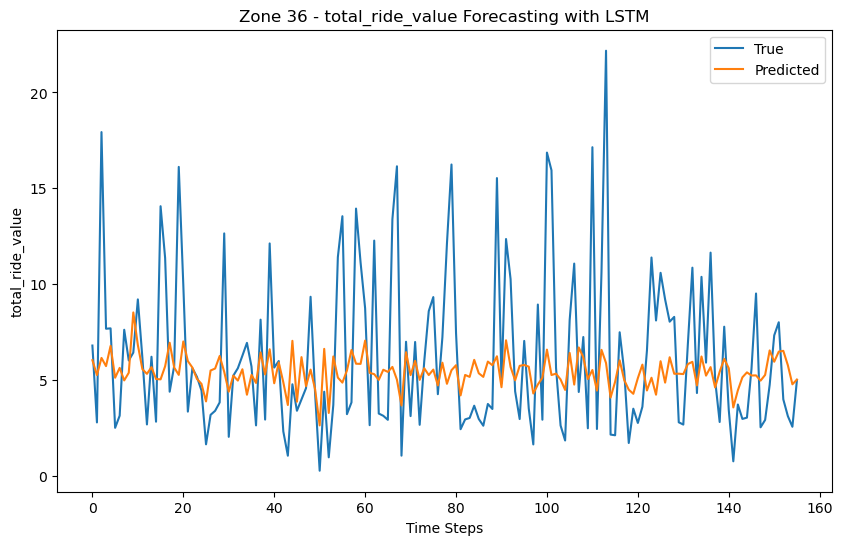

Processing zone 37...
Epoch 1/20


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 400ms/step - loss: 0.1807
Epoch 2/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.1733
Epoch 3/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.1662
Epoch 4/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.1593
Epoch 5/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.1526
Epoch 6/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.1461
Epoch 7/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.1399
Epoch 8/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.1339
Epoch 9/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.1281
Epoch 10/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.1225
Epoch 11/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.1172
Epoch 12/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.1121
Epoch 13/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.1072
Epoch 14/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.1026
Epoch 15/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0982
Epoch 16/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0

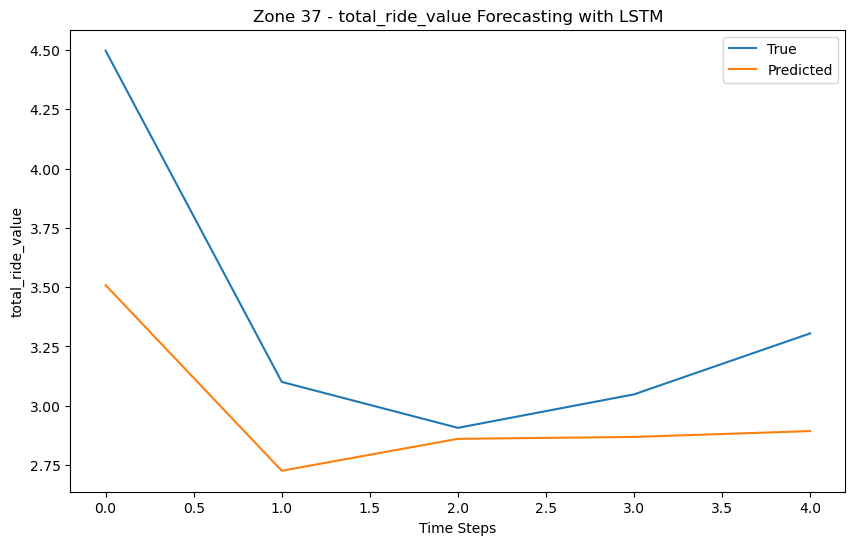

In [25]:
# Forecast total ride value per zone using LSTM
lstm_results_value, mse_df_value = apply_lstm_forecasting(features_df, zone_column='zone',
                                                          target_column='total_ride_value', time_column='start_time')


## Model comparison using MSE (Mean squared error) metric<a class="anchor" id="MSE"></a> 
    

In [26]:
### MERGE FOR RIDE COUNT 
mse_error_total_rides_df = pd.merge(arima_total_rides_df.rename(columns={'mse': 'autoArima_MSE_only_time'}),
                                    regressor_with_features_total_rides_df.rename(columns={'mse': 'RFregressor_using_all_features'}),
                                    on = 'zone')

mse_error_total_rides_df = pd.merge(mse_error_total_rides_df,
                                    mse_df_rides.rename(columns={'mse': 'LSTM_based_forecasting'}),
                                    on = 'zone')

### MERGE FOR RIDE VALUE 
mse_error_ride_value_df = pd.merge(arima_ride_value_df.rename(columns={'mse': 'autoArima_MSE_only_time'}),
                                    regressor_with_features_total_ride_value_df.rename(columns={'mse': 'RFregressor_using_all_features'})
                                    , on = 'zone')

mse_error_ride_value_df = pd.merge(mse_error_ride_value_df,
                                    mse_df_value.rename(columns={'mse': 'LSTM_based_forecasting'}),
                                    on = 'zone')


In [27]:
mse_error_ride_value_df.head(2)

,zone,autoArima_MSE_only_time,RFregressor_using_all_features,LSTM_based_forecasting
0,0,363408.418069,5989.015067,27948.840744
1,2,163015.595351,15595.603500,22590.754256


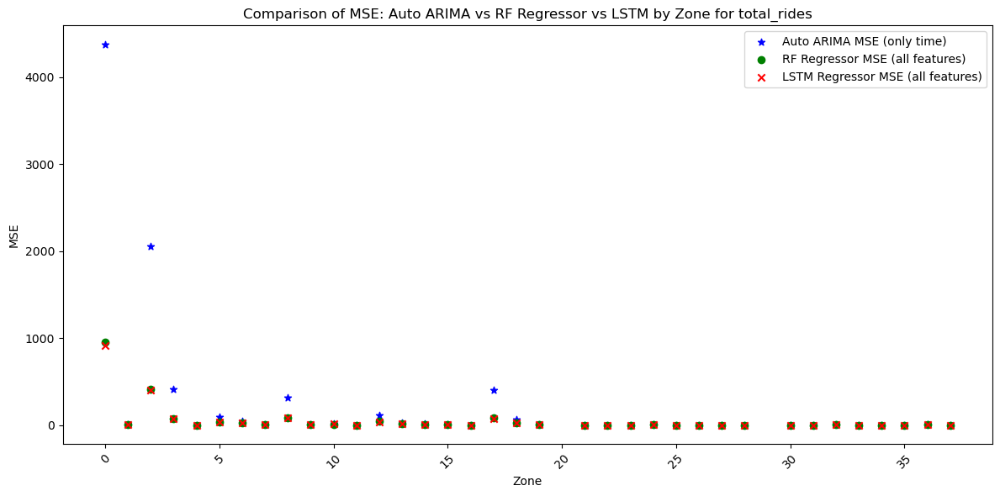

In [28]:
plt.figure(figsize=(12, 6))

# Plot Auto ARIMA MSE
plt.scatter(mse_error_total_rides_df['zone'], mse_error_total_rides_df['autoArima_MSE_only_time'], label='Auto ARIMA MSE (only time)', marker='*', color = 'blue')

# Plot RF Regressor MSE
plt.scatter(mse_error_total_rides_df['zone'], mse_error_total_rides_df['RFregressor_using_all_features'], label='RF Regressor MSE (all features)', marker='o', color = 'green')

# Plot LSTM Regressor MSE
plt.scatter(mse_error_total_rides_df['zone'], mse_error_total_rides_df['LSTM_based_forecasting'], label='LSTM Regressor MSE (all features)', marker='x', color = 'red')

plt.title('Comparison of MSE: Auto ARIMA vs RF Regressor vs LSTM by Zone for total_rides')
plt.xlabel('Zone')
plt.ylabel('MSE')
plt.legend()
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()




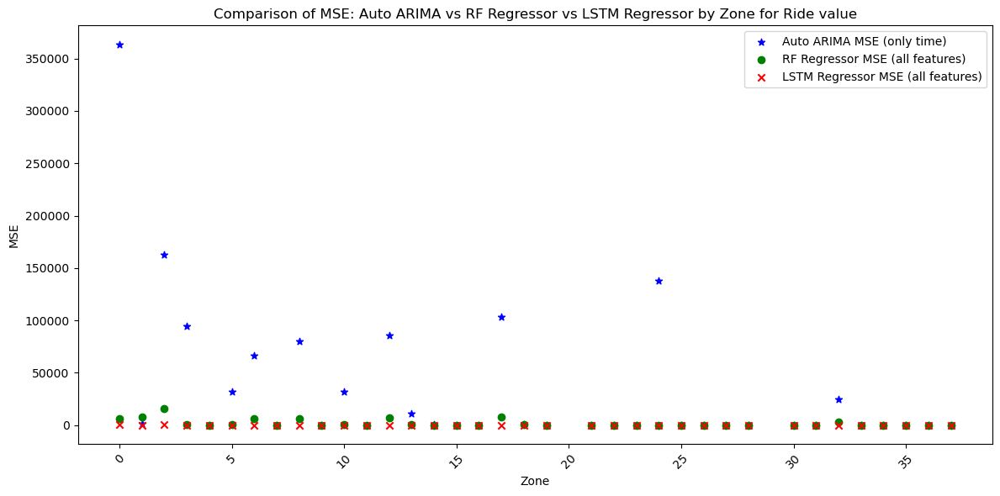

In [29]:
plt.figure(figsize=(12, 6))

# Plot Auto ARIMA MSE
plt.scatter(mse_error_ride_value_df['zone'], mse_error_ride_value_df['autoArima_MSE_only_time'], label='Auto ARIMA MSE (only time)', marker='*', color = 'blue')

# Plot RF Regressor MSE
plt.scatter(mse_error_ride_value_df['zone'], mse_error_ride_value_df['RFregressor_using_all_features'], label='RF Regressor MSE (all features)',marker='o', color = 'green')

# Plot LSTM Regressor MSE
plt.scatter(mse_error_total_rides_df['zone'], mse_error_total_rides_df['LSTM_based_forecasting'], label='LSTM Regressor MSE (all features)', marker='x', color = 'red')
plt.title('Comparison of MSE: Auto ARIMA vs RF Regressor vs LSTM Regressor by Zone for Ride value')
plt.xlabel('Zone')
plt.ylabel('MSE')
plt.legend()
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()




Awesome ! feature which we created are consistantly reducing the MSE when doing the demand forecasting across zones 

In [30]:
print('RESULT COMPARISION RIDE COUNT')
print('MEAN SQ ERROR AUTO ARIMA ONLY USING TIME PREDICTING RIDE VALUE: ' + str(mse_error_total_rides_df['autoArima_MSE_only_time'].mean()) )
print('MEAN SQ ERROR RF Regressor USING ALL FEATURES PREDICTING RIDE VALUE: ' + str(mse_error_total_rides_df['RFregressor_using_all_features'].mean()) )
print('MEAN SQ ERROR LSTM USING ALL FEATURES PREDICTING RIDE VALUE: ' + str(mse_error_total_rides_df['LSTM_based_forecasting'].mean()) )

print('#################################')

print('RESULT COMPARISION RIDE VALUE')
print('MEAN SQ ERROR AUTO ARIMA ONLY USING TIME PREDICTING RIDE VALUE: ' + str(mse_error_ride_value_df['autoArima_MSE_only_time'].mean()) )
print('MEAN SQ ERROR RF Regressor USING ALL FEATURES PREDICTING RIDE VALUE: ' + str(mse_error_ride_value_df['RFregressor_using_all_features'].mean()) )
print('MEAN SQ ERROR LSTM USING ALL FEATURES PREDICTING RIDE VALUE: ' + str(mse_error_ride_value_df['LSTM_based_forecasting'].mean()) )


RESULT COMPARISION RIDE COUNT
MEAN SQ ERROR AUTO ARIMA ONLY USING TIME PREDICTING RIDE VALUE: 221.1394363487784
MEAN SQ ERROR RF Regressor USING ALL FEATURES PREDICTING RIDE VALUE: 50.33045016520652
MEAN SQ ERROR LSTM USING ALL FEATURES PREDICTING RIDE VALUE: 48.25643907026253
#################################
RESULT COMPARISION RIDE VALUE
MEAN SQ ERROR AUTO ARIMA ONLY USING TIME PREDICTING RIDE VALUE: 33176.31143010126
MEAN SQ ERROR RF Regressor USING ALL FEATURES PREDICTING RIDE VALUE: 1704.2059812733662
MEAN SQ ERROR LSTM USING ALL FEATURES PREDICTING RIDE VALUE: 6315.869576243892


## Demand visualisation each zone<a class="anchor" id="fig-demand"></a> 
- We want to give an idea on how we will be showing this to the user - although this requires frontend team collaboration to handle mobile/app smooth integration. We will be using plotly and highlighting for next 30 min time intervals which zones are preferable give a random set of 100 drivers with random starting positions 

In [38]:
import plotly.graph_objects as go
import plotly.colors as pc

def plot_forecasted_demand_plotly(forecast_dict, drivers_zone=None):
    """
    This function takes a dictionary of forecasted ride counts per zone and plots the demand for the forecasted values using Plotly.
    It first sorts the forecast_dict based on zone names to match the order of the drivers_zone list.
    Optionally, it divides the ride count forecast by the number of drivers in each zone using a list.
    
    Parameters:
    forecast_dict (dict): A dictionary where the keys are zone names and the values are lists of ride counts.
                          The last 10 values in each list represent the forecasted values for each zone.
    drivers_zone (list): Optional. A list where each element corresponds to the number of drivers in each zone.
                         If not provided, it assumes 1 driver in each zone.
    """
    
    # Ensure drivers_zone is provided; if not, assume 1 driver per zone
    if drivers_zone is None:
        drivers_zone = [1] * len(forecast_dict)

    if len(drivers_zone) != len(forecast_dict):
        raise ValueError("The length of drivers_zone must match the number of zones in forecast_dict.")
    
    # Sort the forecast_dict by zone name to match the order in drivers_zone
    sorted_forecast_dict = dict(sorted(forecast_dict.items()))

    fig = go.Figure()

    # Loop through each sorted zone and add the forecasted values (last 10 values) to the plot
    for i, (zone, ride_counts) in enumerate(sorted_forecast_dict.items()):
        if len(ride_counts) >= 10:
            forecasted_values = ride_counts[-10:]
            drivers = drivers_zone[i]
            adjusted_forecasted_values = [count / drivers for count in forecasted_values]
            fig.add_trace(go.Scatter(
                x=list(range(1, 11)),
                y=adjusted_forecasted_values,
                mode='lines+markers',
                name=f'Zone {zone}',
            ))

    fig.update_layout(
        title='Forecasted Ride Demand Per Driver (Last 10 Timesteps)',
        xaxis_title='Time Steps',
        yaxis_title='Ride Count Per Driver',
        legend_title_text='Zones',
        legend=dict(
            orientation="h",
            yanchor="bottom",
            y=-0.3,
            xanchor="center",
            x=0.5
        )
    )

    fig.show()


In [32]:
forecast_total_rides, regressor_with_features_total_rides_df = multivariate_time_series_forecast_with_sorted_subplots(features_df,
                                                                              zone_column='zone',
                                                                              target_column='total_rides',
                                                                              time_column='start_time', fig_required = False)


Processing zone 0...
Zone 0 - total_rides MSE: 1001.55
Processing zone 2...
Zone 2 - total_rides MSE: 418.89
Processing zone 8...
Zone 8 - total_rides MSE: 86.78
Processing zone 3...
Zone 3 - total_rides MSE: 78.62
Processing zone 17...
Zone 17 - total_rides MSE: 87.09
Processing zone 12...
Zone 12 - total_rides MSE: 39.20
Processing zone 5...
Zone 5 - total_rides MSE: 35.99
Processing zone 18...
Zone 18 - total_rides MSE: 20.52
Processing zone 6...
Zone 6 - total_rides MSE: 23.60
Processing zone 13...
Zone 13 - total_rides MSE: 15.50
Processing zone 10...
Zone 10 - total_rides MSE: 10.76
Processing zone 14...
Zone 14 - total_rides MSE: 8.00
Processing zone 1...
Zone 1 - total_rides MSE: 7.75
Processing zone 24...
Zone 24 - total_rides MSE: 4.64
Processing zone 7...
Zone 7 - total_rides MSE: 5.06
Processing zone 32...
Zone 32 - total_rides MSE: 4.40
Processing zone 19...
Zone 19 - total_rides MSE: 4.21
Processing zone 9...
Zone 9 - total_rides MSE: 2.25
Processing zone 36...
Zone 36 - 

In [39]:
plot_forecasted_demand_plotly(forecast_total_rides)

Now assume we just had one driver - in order for him to always get a customer he just needs to stay in zone 2. But that is not the case we will have multiple drivers around the city and zone 2 being popular will be a know information. 

Lets simulate a scenario where we add multiple drivers in each zone at random and then generate the demand in each zone - the demand in each zone will then be = total ride count/ number of drivers in the zone . Why ? because this system is to notify drivers where they need to be if the zone is already populated with drivers there is no incentive of going there 

Let's assume there are only 100 drivers in this city and spread them across the zones 

In [37]:
drivers_location = [15, 5, 12, 3, 2, 3, 2, 1, 1, 2, 2, 2, 1, 3, 2, 1, 2, 3, 2, 1, 
 2, 2, 3, 2, 2, 2, 1, 2, 3, 2, 1, 2, 2, 3, 1, 1]

plot_forecasted_demand_plotly(forecast_total_rides, drivers_location)

This is a more realistic distribution - where even though the drivers have intuition that the demand will be more in some zone or the other there is still a scope of improvement. For example even with 12 drivers in zone 2 we still will have around 20-30 potential rides missed in the next hour or so - we want to move drivers from zone 9 or 36 (where there is a probability of maybe having one ride) to zone 2 

IN THE NEXT NOTEBOOK WE WILL FOLLOW A PRODCUTION ENVIOURNMENT AND GIVE ACTIONABLE SUGGESTIONS TO THE DRIVERS TO MAXIMIZE FULFILLMENT OF DEMAND 